In [ ]:
import os
import glob
# import xml.etree.ElementTree as ET
import pandas as pd
!pip install "opencv-python-headless<4.3"
import csv
import cv2
import io
import scipy.misc
import numpy as np
import six
from six import BytesIO
import time
import glob
from IPython.display import display

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

%matplotlib inline

In [ ]:
# Clone tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

fatal: destination path 'models' already exists and is not an empty directory.


In [ ]:
#install tenserflow object detection API
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1686356 sha256=7cc8ab296bd838f1ad9d6dedb1e391815cf53c167261f05842572869ea565ce5
  Stored in directory: /tmp/pip-ephem-wheel-cache-2y9g5ipz/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1




  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [ ]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
#get dataset
from google.colab import files
from google.colab import drive
drive.mount("/content/drive")
gdrive_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#change the pipeline
pipeline_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config"
model_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model"
num_classes = 5
batch_size = 64
fine_tune_checkpoint = '/content/drive/MyDrive/GarbageClassification/dataset_withO/pretrained_model/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpointckpt-0'
fine_tune_checkpoint_type = "detection"
use_bfloat16 = "false"
test_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/tfrecord/test_record.tfrecord'
train_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/tfrecord/train_record.tfrecord'
valid_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/tfrecord/train_record.tfrecord'
test_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/label/test_label_map.pbtxt'
train_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/label/train_label_map.pbtxt'
val_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/label/valid_label_map.pbtxt'

In [ ]:
# %load_ext tensorboard
# %tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50
%tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model
%reload_ext tensorboard

Reusing TensorBoard on port 6006 (pid 699), started 11:52:50 ago. (Use '!kill 699' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
    --alsologtostderr \
    --num_train_steps=30000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

2022-03-21 08:44:38.041772: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0321 08:44:38.092793 139721641240448 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 30000
I0321 08:44:38.457033 139721641240448 config_util.py:552] Maybe overwriting train_steps: 30000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0321 08:44:38.457418 139721641240448 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0321 08:44:38.524331 139721641240448 deprecation.py:343] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experime

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/exported30000

2022-03-21 14:14:30.230805: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0321 14:14:30.586140 140545139853184 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
    --alsologtostderr \
    --num_train_steps=40000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

2022-03-21 14:15:30.752296: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0321 14:15:30.758507 140369885521792 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 40000
I0321 14:15:30.765800 140369885521792 config_util.py:552] Maybe overwriting train_steps: 40000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0321 14:15:30.765976 140369885521792 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0321 14:15:30.809571 140369885521792 deprecation.py:343] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experime

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/exported40000

2022-03-21 16:07:49.984042: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0321 16:07:50.341525 140207952357248 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
    --alsologtostderr \
    --num_train_steps=50000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

2022-03-21 16:08:49.647349: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0321 16:08:49.653769 139983577663360 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 50000
I0321 16:08:49.661298 139983577663360 config_util.py:552] Maybe overwriting train_steps: 50000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0321 16:08:49.661527 139983577663360 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0321 16:08:49.710172 139983577663360 deprecation.py:343] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experime

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/exported50000

2022-03-21 18:01:16.063562: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0321 18:01:16.468356 139793118390144 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
    --alsologtostderr \
    --num_train_steps=60000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

2022-03-21 18:02:16.446671: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0321 18:02:16.453409 140193786984320 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 60000
I0321 18:02:16.460174 140193786984320 config_util.py:552] Maybe overwriting train_steps: 60000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0321 18:02:16.460325 140193786984320 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0321 18:02:16.506482 140193786984320 deprecation.py:343] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experime

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/exported60000

2022-03-21 20:12:53.875237: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0321 20:12:54.191051 140279925614464 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
def load_image_into_numpy_array(path):
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(test_label_map_pbtxt_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/trained_model/exported60000/saved_model')

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  input_tensor = tf.convert_to_tensor(image)
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  if 'detection_masks' in output_dict:
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

O_12838_jpg.rf.44bab81cbe182009ff6396272783ad1e.jpg
True


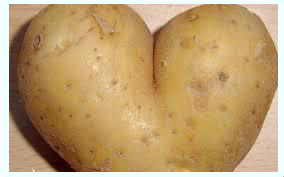

[0.923358   0.28601116 0.22081082 0.18630856 0.17033876 0.15592057
 0.15419109 0.14522152 0.12915634 0.12605308 0.12379    0.12330567
 0.12011728 0.1197015  0.11817272 0.11577223 0.11357712 0.10959893
 0.10879477 0.1006574  0.09936659 0.09545578 0.09507851 0.09396993
 0.09270941 0.09155787 0.09109316 0.09030613 0.08365646 0.08232067
 0.08129004 0.08126371 0.08068799 0.08065858 0.0798824  0.0798028
 0.07929688 0.07831337 0.07779278 0.07704278 0.07665578 0.07474469
 0.07407375 0.07345621 0.07206015 0.07159065 0.07033478 0.06969991
 0.0685534  0.06847948 0.0682358  0.0673546  0.06734625 0.06716684
 0.06694802 0.06677972 0.0658885  0.0657553  0.06556747 0.06463769
 0.06450926 0.06437608 0.06382284 0.06346074 0.06289245 0.06277765
 0.06166257 0.06148644 0.06146918 0.06146714 0.0611646  0.06054699
 0.06052016 0.0599075  0.05971623 0.05952518 0.05892594 0.05889567
 0.05850001 0.05849015 0.05846518 0.057859   0.05783273 0.05720579
 0.05687014 0.05540926 0.0552065  0.05505981 0.0550487  0.05499

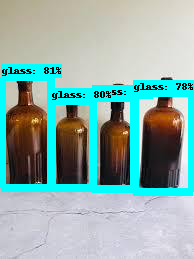

[0.880006   0.8052072  0.8022283  0.7820561  0.15213142 0.13885388
 0.13852005 0.12194793 0.10936212 0.10494866 0.09275108 0.09200055
 0.09032589 0.08294838 0.08079312 0.08046605 0.07989978 0.07838443
 0.07776531 0.0769875  0.07462834 0.07271293 0.07255693 0.06956444
 0.06790614 0.06585901 0.0657559  0.06318494 0.06310033 0.06247516
 0.06050675 0.05940636 0.05787667 0.05745648 0.05695732 0.05485769
 0.05452352 0.05389229 0.05196371 0.05165024 0.05161628 0.05139102
 0.05026706 0.04991344 0.04979047 0.04971706 0.04952868 0.04894164
 0.04878023 0.04876199 0.04868003 0.04839368 0.0481912  0.04814905
 0.04808069 0.04804148 0.04794885 0.04785014 0.04747134 0.04654578
 0.04558872 0.04549656 0.0453984  0.04507808 0.0450683  0.04480596
 0.04465592 0.04414757 0.04387651 0.04384483 0.0436937  0.04366332
 0.04356424 0.04348129 0.04326686 0.04282474 0.04257873 0.04252919
 0.04236349 0.04206134 0.04202341 0.04179679 0.04152032 0.04147537
 0.04132616 0.04124168 0.04031217 0.04014964 0.0399348  0.0394

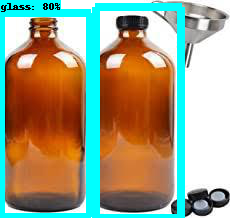

[0.82267857 0.80493915 0.31622064 0.18320519 0.17792974 0.12911947
 0.11672514 0.11625671 0.10868961 0.09761573 0.0939775  0.09078428
 0.08624822 0.08593167 0.08524687 0.08476699 0.08342911 0.08087967
 0.07898916 0.07772468 0.07714412 0.07624736 0.07372095 0.07347571
 0.06930345 0.0689125  0.06815195 0.06667224 0.06605959 0.06599192
 0.06305826 0.06209506 0.061965   0.06095217 0.06059314 0.05921517
 0.05798995 0.05612913 0.05611715 0.05570688 0.05558116 0.05541811
 0.05516148 0.05451827 0.05446713 0.05441553 0.05378574 0.05356279
 0.0535604  0.05350343 0.05337304 0.05275464 0.05199623 0.05175414
 0.05147137 0.05135216 0.0496912  0.04926737 0.04918778 0.04893563
 0.04835927 0.04827283 0.0472994  0.04705675 0.04663575 0.04652969
 0.0463325  0.04594675 0.04547806 0.04528687 0.04515739 0.04490552
 0.04477176 0.04443777 0.04429739 0.04418597 0.04385461 0.04367085
 0.04354595 0.04333665 0.04311061 0.04275483 0.04220486 0.04196028
 0.04187253 0.04163447 0.04133951 0.04119304 0.04116395 0.0409

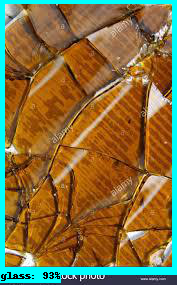

[0.9348627  0.30876192 0.30488336 0.2542823  0.24846213 0.20747189
 0.19844097 0.11880378 0.11286639 0.10466287 0.10133479 0.09616209
 0.09168856 0.08834022 0.08813258 0.0866595  0.08079608 0.07638598
 0.07617642 0.07330149 0.07256066 0.07138537 0.07088979 0.06979257
 0.06497841 0.06489122 0.06459846 0.06450052 0.06302789 0.06104315
 0.06020408 0.05867342 0.05711505 0.05669677 0.05488746 0.05457278
 0.05393879 0.05342959 0.05284853 0.05274316 0.05132505 0.05109102
 0.04905945 0.04870587 0.04787405 0.04540342 0.04486047 0.04452326
 0.04426918 0.04414094 0.0441031  0.04261595 0.04245199 0.04169903
 0.0397856  0.03977423 0.03961895 0.03958486 0.03927426 0.03903512
 0.03839391 0.03833663 0.03795446 0.03786268 0.03778578 0.03712476
 0.03689607 0.03634197 0.03598474 0.03549201 0.03517736 0.03494254
 0.03483646 0.03451478 0.0342278  0.03406956 0.03372104 0.033467
 0.03342485 0.03301541 0.03283693 0.03264036 0.03245704 0.03220805
 0.03207566 0.03207451 0.03188684 0.03160208 0.03137323 0.031358

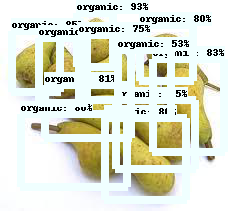

[0.92647463 0.86179185 0.84629023 0.84523183 0.8332094  0.81372637
 0.8016226  0.79943067 0.78863853 0.7506227  0.5301166  0.45726895
 0.45432276 0.4387227  0.31943622 0.306042   0.16711096 0.16223356
 0.15901685 0.15532985 0.13839845 0.13369383 0.11871106 0.11735552
 0.11720239 0.11587559 0.11477732 0.11171755 0.10610896 0.10586097
 0.10312278 0.10134155 0.10100766 0.10040193 0.09686565 0.09619579
 0.09583757 0.09256406 0.09211552 0.09044738 0.08977599 0.08779126
 0.08765031 0.08603539 0.08556446 0.08556072 0.08336078 0.08256751
 0.08247714 0.08245145 0.08190263 0.08181097 0.08153352 0.08082082
 0.07953346 0.07870944 0.0786458  0.07852204 0.07828325 0.07799519
 0.0762766  0.07511267 0.07480978 0.07380223 0.07268554 0.07149871
 0.07144227 0.06867848 0.06846982 0.06839008 0.06827816 0.06803117
 0.06796412 0.06759869 0.06740069 0.06735458 0.0670833  0.06668358
 0.06665415 0.06586333 0.065784   0.06539572 0.06385107 0.0634608
 0.06288262 0.06245694 0.06167607 0.06115451 0.06101608 0.06075

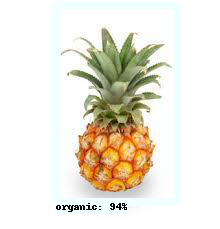

[0.9368987  0.25781342 0.22028667 0.21340948 0.2057636  0.18827645
 0.164552   0.13889645 0.13660915 0.12693655 0.12498927 0.12066469
 0.11470429 0.11339551 0.10093547 0.09832384 0.0925649  0.09197674
 0.09088749 0.08660845 0.08580953 0.08566807 0.08465777 0.08356979
 0.08322275 0.08321782 0.08295072 0.08281422 0.0825141  0.08127378
 0.07862602 0.07835174 0.07737229 0.077075   0.0754228  0.07380389
 0.07369228 0.0729944  0.07176652 0.07027005 0.07001691 0.0682971
 0.06678084 0.06658385 0.06541509 0.06529684 0.06500746 0.06493802
 0.06333622 0.06308522 0.06176014 0.06082344 0.05987185 0.05930385
 0.0583824  0.0579635  0.0577559  0.057284   0.05703744 0.05658228
 0.05648205 0.05645594 0.05609631 0.05589163 0.05545866 0.05510779
 0.05476794 0.05350661 0.05348839 0.05340375 0.05333834 0.05278156
 0.05263126 0.05213419 0.05205077 0.05183917 0.05181975 0.05176641
 0.05114792 0.0510526  0.05064946 0.05051762 0.05049678 0.05032462
 0.0502274  0.04950694 0.04949307 0.04904741 0.04839014 0.04832

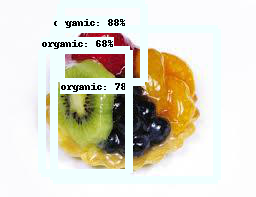

[0.8778735  0.77560866 0.6793917  0.4914234  0.30037558 0.1846472
 0.14381233 0.12388424 0.12219607 0.10852896 0.09861618 0.09509295
 0.09503329 0.09351455 0.09194998 0.08500372 0.08175764 0.07748234
 0.07675451 0.07478973 0.0740772  0.07279027 0.07209319 0.07142915
 0.07112998 0.0691646  0.06901912 0.06898377 0.06642929 0.06587672
 0.06503695 0.06487679 0.06416569 0.06388645 0.0626088  0.0608558
 0.05965172 0.0591311  0.05846573 0.05771132 0.05670111 0.05638577
 0.05506551 0.0537319  0.05340983 0.05279451 0.05068572 0.05064586
 0.04975262 0.04930976 0.04930908 0.04899778 0.04887866 0.04831594
 0.04821745 0.04813753 0.04780621 0.04774406 0.04743009 0.0468991
 0.04671704 0.04604647 0.04506788 0.04453557 0.0444405  0.04430575
 0.04425743 0.04413427 0.0439398  0.04386644 0.04371244 0.04349003
 0.04334235 0.04259646 0.04229421 0.04196511 0.04171017 0.04155562
 0.04142837 0.04135674 0.04047108 0.04044783 0.04026471 0.03968098
 0.03946591 0.03919651 0.03915202 0.03904792 0.03904049 0.0388805

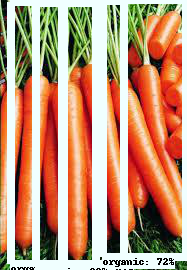

[0.8100152  0.7381062  0.7214948  0.6634015  0.42145756 0.36550337
 0.33272994 0.2972025  0.23394881 0.22055575 0.17459436 0.17103755
 0.16766119 0.14828892 0.14660552 0.13356811 0.13271481 0.12248418
 0.12245082 0.12212212 0.12032876 0.11143351 0.0995061  0.09886324
 0.09852079 0.09696753 0.09636109 0.09156181 0.08413555 0.08358546
 0.08345031 0.08226445 0.08098242 0.07846083 0.07780772 0.07742535
 0.07679218 0.07536851 0.07322239 0.07321057 0.07307197 0.07175835
 0.07121535 0.07001928 0.0695115  0.06776994 0.06733479 0.06720491
 0.06618197 0.06419032 0.06314742 0.06313569 0.06233438 0.0622834
 0.06163248 0.06138351 0.06135561 0.05964557 0.05926857 0.05811197
 0.05808631 0.05762287 0.05657834 0.05630824 0.05604081 0.05582708
 0.05551251 0.05518791 0.05474816 0.05367653 0.05325471 0.05196311
 0.05193864 0.05180395 0.0509439  0.0509322  0.05064501 0.05052919
 0.05034724 0.05006356 0.04949725 0.04943436 0.04918722 0.04913687
 0.04884335 0.04867493 0.0483521  0.04763646 0.04683377 0.04678

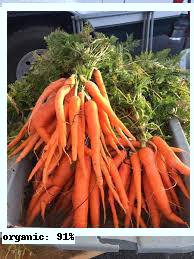

[0.9070816  0.32767072 0.28092542 0.28047404 0.22729467 0.22721985
 0.21677317 0.13549483 0.13129716 0.11603398 0.11589763 0.11098449
 0.10858467 0.10351975 0.10083724 0.09481989 0.09244683 0.09071609
 0.08578058 0.08361511 0.08233158 0.08218001 0.08205381 0.07947733
 0.07946096 0.07731602 0.07533529 0.07474349 0.0743812  0.0727917
 0.0717689  0.07173766 0.07093565 0.07076893 0.06801248 0.066745
 0.06623811 0.06579839 0.06495736 0.06444631 0.06355025 0.0633079
 0.06294605 0.06210994 0.06096362 0.05904657 0.05842708 0.05646585
 0.05537467 0.05532007 0.05516185 0.05487875 0.05430167 0.05379473
 0.05341636 0.05295331 0.05289464 0.05216472 0.05115528 0.05006071
 0.04935624 0.04933078 0.04809104 0.04779543 0.04754321 0.04738114
 0.04733859 0.04702849 0.04685989 0.04640504 0.04635329 0.04566304
 0.04560657 0.04552514 0.04441464 0.04418487 0.04363806 0.04349093
 0.04333465 0.04283535 0.04219399 0.04205485 0.04201096 0.04185797
 0.04176838 0.04129295 0.04109238 0.04091754 0.040799   0.04050913

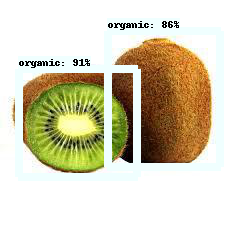

[0.91464746 0.861377   0.19021057 0.13775261 0.11530788 0.11192545
 0.11127765 0.10792477 0.10369313 0.10358292 0.10351909 0.1003826
 0.09822742 0.09063806 0.08808441 0.08595882 0.08421072 0.08316089
 0.08279182 0.08119027 0.07882962 0.07679558 0.07657433 0.07646826
 0.07591961 0.07348996 0.07341075 0.07196098 0.07079379 0.06953666
 0.06874898 0.06797482 0.06797221 0.06612104 0.06538714 0.06515149
 0.0640593  0.06404056 0.06385785 0.06378185 0.06215575 0.06157636
 0.06092791 0.06033543 0.06004032 0.0581784  0.05779669 0.05772714
 0.05769842 0.05687925 0.05673426 0.05584851 0.05568013 0.05540467
 0.05539821 0.05491892 0.05368648 0.05351944 0.05350306 0.05320266
 0.05312474 0.0529009  0.05278116 0.05246321 0.05023687 0.04996958
 0.04941051 0.04937051 0.04907231 0.04754346 0.04746577 0.04736262
 0.04713671 0.04673514 0.04656943 0.04656369 0.0463883  0.04568036
 0.04560722 0.04553211 0.04550932 0.04548688 0.04518621 0.04495806
 0.0448213  0.04480572 0.0435519  0.04339    0.04317969 0.04302

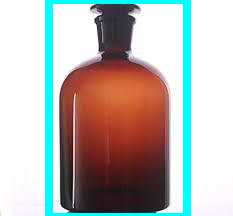

[0.9283192  0.24719343 0.23879004 0.23080783 0.21845269 0.21774535
 0.18844317 0.18836178 0.1795532  0.16947228 0.16015722 0.13893457
 0.13395236 0.12965025 0.1288314  0.1263126  0.12577066 0.12231614
 0.11890805 0.11872426 0.11391634 0.10900755 0.0953676  0.09267338
 0.09172072 0.08916231 0.0890797  0.08595981 0.08439701 0.08312765
 0.08160105 0.07943743 0.07922052 0.0784577  0.07796427 0.07665477
 0.0759777  0.07498461 0.07443655 0.073881   0.07317226 0.07301715
 0.07125654 0.07078496 0.07035916 0.06788455 0.0673136  0.06694339
 0.06591607 0.06493975 0.06450242 0.06435555 0.06405646 0.06342192
 0.0618774  0.06180352 0.06148925 0.06077678 0.06055019 0.06047928
 0.06029864 0.05983683 0.05953415 0.05916546 0.05873097 0.05858476
 0.05819658 0.05803888 0.05803191 0.05786566 0.05740738 0.0573246
 0.05730193 0.057006   0.05614948 0.05596647 0.05590951 0.05588154
 0.05569332 0.05555769 0.05501329 0.0548487  0.05407723 0.05400596
 0.05382431 0.05378261 0.05331583 0.0531146  0.05289893 0.05262

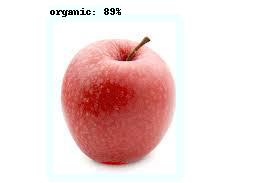

[0.891329   0.1964058  0.16161788 0.14663397 0.14246193 0.14144973
 0.12267926 0.12226979 0.11701039 0.1164256  0.11424804 0.10702339
 0.10393412 0.10232875 0.10164412 0.10039997 0.09837471 0.09669036
 0.0952096  0.0949628  0.09390174 0.09384765 0.09050345 0.08726384
 0.08543333 0.08541372 0.08166693 0.08037518 0.07917444 0.0778979
 0.07755852 0.07713475 0.07354105 0.07285023 0.07138358 0.07045883
 0.06924076 0.06774795 0.06627445 0.06607977 0.066002   0.06480204
 0.06420811 0.06282928 0.06199137 0.06185754 0.06166339 0.06150566
 0.06141768 0.0612999  0.06113178 0.0608062  0.06038768 0.0602827
 0.05896658 0.05879164 0.05855142 0.05754283 0.05694984 0.05658271
 0.05634944 0.05617423 0.05604875 0.05582829 0.05558207 0.05556011
 0.05522832 0.05509044 0.05506188 0.05497226 0.0545554  0.05432844
 0.05424324 0.05380327 0.05361123 0.05337212 0.05304009 0.05301103
 0.05240313 0.05180612 0.05125777 0.05104181 0.05022428 0.05004356
 0.05001011 0.04984795 0.04981413 0.04962194 0.0493103  0.049128

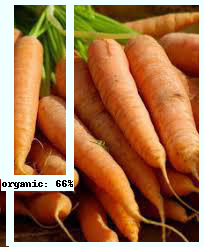

[0.86871165 0.65945804 0.22810577 0.2197086  0.21739008 0.16837667
 0.15987481 0.15659566 0.14997976 0.13456962 0.1332919  0.1291394
 0.12904412 0.11930633 0.11865102 0.11805342 0.11035277 0.1095105
 0.10701436 0.10384017 0.10300864 0.10218266 0.0999658  0.09919485
 0.09177866 0.09160264 0.09153627 0.09038004 0.08942202 0.08908852
 0.0883486  0.08799653 0.08792614 0.08557767 0.08429329 0.08409462
 0.08377618 0.08373642 0.0836175  0.08300805 0.08280487 0.08276414
 0.08095752 0.07937609 0.07930523 0.07861702 0.07835476 0.07747786
 0.07720126 0.0766452  0.07515639 0.07391462 0.07388924 0.07351935
 0.07343148 0.07247341 0.07061862 0.07026267 0.06944594 0.06943513
 0.06900635 0.06826727 0.06816483 0.06809989 0.06676366 0.06674472
 0.06635684 0.06598324 0.0657137  0.0645659  0.06370643 0.06366988
 0.06328217 0.06308772 0.0627059  0.06192632 0.06050835 0.05891687
 0.05794318 0.05750498 0.05729654 0.05667553 0.05653793 0.05628721
 0.05557097 0.05460282 0.05433607 0.05429678 0.05276911 0.052421

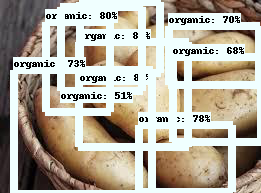

[0.85525787 0.8131197  0.79727167 0.77576417 0.7306362  0.6961946
 0.68326956 0.51024246 0.3966578  0.37662235 0.36172155 0.35340205
 0.34053743 0.3156727  0.31428245 0.28190425 0.27396974 0.24401173
 0.24237779 0.24033476 0.23977333 0.23703913 0.23544993 0.2326955
 0.23263909 0.23190062 0.22468704 0.21954836 0.21928951 0.21437089
 0.20623368 0.19588831 0.19389889 0.18645221 0.18559083 0.169258
 0.16327341 0.16303955 0.15848115 0.15638481 0.1539247  0.15202278
 0.14876848 0.14743343 0.14739503 0.1459133  0.14154646 0.14088222
 0.13739808 0.13707763 0.12929308 0.12829877 0.12783928 0.12773977
 0.12764144 0.12400772 0.12166628 0.11794784 0.1150273  0.11332267
 0.11107539 0.10964586 0.10739966 0.10676024 0.10673403 0.10470154
 0.10448033 0.10326847 0.10266902 0.10223804 0.10192364 0.10159654
 0.10073197 0.10029971 0.10021637 0.10009986 0.10009732 0.09703849
 0.09633371 0.09618337 0.09568907 0.09525229 0.09394784 0.09354199
 0.09323382 0.09213018 0.09126561 0.08899777 0.08804644 0.0861479


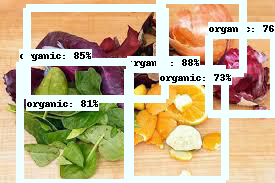

[0.88430816 0.84610146 0.8119949  0.75776225 0.72948885 0.41362754
 0.37668198 0.27473027 0.2685995  0.2312015  0.22363155 0.18687293
 0.18503176 0.16956443 0.1531833  0.14832193 0.14730449 0.14534569
 0.13280797 0.12528285 0.12192549 0.1199246  0.11872721 0.11476926
 0.10925484 0.1077873  0.10486568 0.10118299 0.10015103 0.10000814
 0.09648041 0.09572507 0.09411534 0.09198423 0.09096242 0.09033763
 0.08981588 0.08860713 0.08772589 0.08762533 0.08714044 0.08426534
 0.08418193 0.08177783 0.07819011 0.07762254 0.07732388 0.07385657
 0.0718986  0.0715915  0.0710912  0.06800254 0.06790916 0.06783421
 0.06486891 0.06470826 0.06327399 0.06263412 0.06182649 0.06155202
 0.06106147 0.06061921 0.0602979  0.06018942 0.05931802 0.05820947
 0.05753063 0.0573911  0.05728136 0.05681212 0.05678424 0.05657936
 0.05611448 0.0560191  0.05596261 0.05595311 0.0551418  0.05426028
 0.0540367  0.05371846 0.05323216 0.05308338 0.05259909 0.05211216
 0.0520401  0.05203452 0.05146344 0.05134502 0.0502615  0.0495

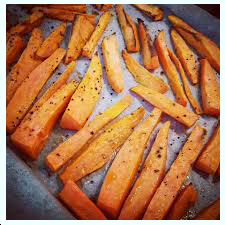

[0.92023706 0.22758599 0.16170318 0.15450303 0.14739591 0.13804503
 0.1238125  0.1199347  0.11892015 0.11700825 0.11541729 0.11391441
 0.10339054 0.10292612 0.10205314 0.09560493 0.09426624 0.09426001
 0.08978347 0.08886017 0.08724336 0.08422254 0.08407594 0.08211277
 0.08170948 0.0794187  0.07899066 0.0767696  0.07638858 0.07461177
 0.07437968 0.07343531 0.07326909 0.07300529 0.0724363  0.0724189
 0.07110012 0.06763928 0.06665208 0.06401142 0.06397212 0.06121024
 0.06093031 0.06006627 0.05750359 0.05731174 0.05699339 0.05643233
 0.05527557 0.05483963 0.05451147 0.05378718 0.05374661 0.05353502
 0.05342982 0.0532823  0.05209273 0.05141088 0.05067398 0.04983386
 0.04928514 0.04851896 0.04799492 0.04751768 0.04730243 0.0472948
 0.04703825 0.04652229 0.04640774 0.04571659 0.04570082 0.04539039
 0.04427826 0.04421894 0.04398397 0.04282904 0.04266063 0.04240078
 0.04220498 0.04180866 0.04131387 0.04122332 0.04118329 0.04023752
 0.04008522 0.03967629 0.03960077 0.0395912  0.03929969 0.038918

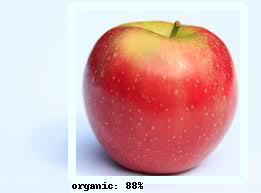

[0.87613803 0.16102251 0.10379668 0.10336673 0.09921467 0.08888045
 0.08505929 0.08411577 0.08279832 0.07967816 0.07527004 0.074109
 0.07361916 0.07119092 0.06926318 0.06823877 0.06559993 0.06354535
 0.06126548 0.06103232 0.06006072 0.05676111 0.05626002 0.05617226
 0.05494451 0.05464591 0.05436588 0.05433302 0.05430081 0.05424112
 0.0520239  0.05124978 0.05116286 0.05087533 0.05020706 0.05018644
 0.0492699  0.04892908 0.04865096 0.04710208 0.04656685 0.04586598
 0.04574494 0.04569264 0.04445715 0.04409719 0.04396779 0.04394234
 0.04334613 0.04312414 0.04284001 0.04282733 0.04280651 0.04228136
 0.04214461 0.04169909 0.04146219 0.04129595 0.04116084 0.04090949
 0.04067982 0.04046858 0.04027952 0.04025305 0.04024356 0.03979548
 0.03927084 0.03920986 0.03893685 0.03877322 0.03874912 0.0385695
 0.03832722 0.03777077 0.03774839 0.03730202 0.0370531  0.03700708
 0.0366045  0.03652415 0.03642249 0.0363922  0.03638537 0.03593913
 0.03591609 0.03585009 0.03575671 0.03564321 0.0353359  0.0352466

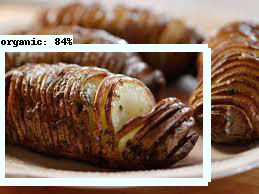

[0.8422265  0.4972247  0.20537795 0.19186287 0.16867264 0.16496989
 0.14565782 0.1449011  0.1404673  0.13226803 0.1207355  0.11026037
 0.1081588  0.1050254  0.10394834 0.10315964 0.10208853 0.10039654
 0.10020722 0.09344675 0.09112389 0.09100669 0.09061601 0.08883044
 0.08722919 0.08443219 0.08303744 0.07973558 0.07963876 0.07918876
 0.07533711 0.07380899 0.07326331 0.07287738 0.0717055  0.06961021
 0.06802148 0.067876   0.06778564 0.06707995 0.0650216  0.06494883
 0.06406471 0.06373008 0.06254502 0.06163998 0.06115565 0.059124
 0.05721248 0.05700795 0.05591582 0.0559082  0.05589851 0.05550831
 0.05492301 0.0547488  0.05442542 0.05427718 0.05374321 0.05313285
 0.0518089  0.05171623 0.05143139 0.05092627 0.05082411 0.05055185
 0.05031626 0.05020138 0.0500748  0.04958867 0.04916447 0.04910741
 0.04908332 0.04854841 0.04850511 0.04784172 0.04775446 0.04771741
 0.04762647 0.04698793 0.04652395 0.04630931 0.0452981  0.04469459
 0.04403229 0.04369757 0.04331224 0.04288351 0.04284374 0.042278

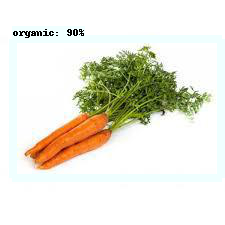

[0.9027204  0.22841534 0.2048652  0.18425347 0.17114638 0.15450087
 0.14307448 0.12860301 0.12436967 0.12382607 0.10925135 0.10344817
 0.1020248  0.10039563 0.09736447 0.09724625 0.0967275  0.09574138
 0.09114558 0.08987683 0.08835088 0.0865045  0.0836713  0.08342047
 0.08200314 0.08041199 0.07968632 0.07910307 0.07697723 0.07641281
 0.07534374 0.07400555 0.07317371 0.07274642 0.07271691 0.07230519
 0.07088763 0.07060494 0.07004003 0.06967436 0.06955162 0.06864126
 0.06587259 0.06557798 0.06531844 0.06474787 0.06463093 0.06194223
 0.06163303 0.06093083 0.0599147  0.05965669 0.05963888 0.0586169
 0.05853312 0.05823606 0.05791999 0.0569817  0.05636767 0.05614129
 0.05607435 0.05577713 0.05513671 0.05510867 0.05486769 0.05464442
 0.05441191 0.0542974  0.05412686 0.05388459 0.05354964 0.05293045
 0.05272165 0.05234318 0.05198001 0.05172631 0.051309   0.05105726
 0.05103309 0.05095622 0.05058877 0.05026537 0.04955893 0.04945219
 0.04939033 0.04920556 0.04913738 0.04902566 0.04883153 0.04787

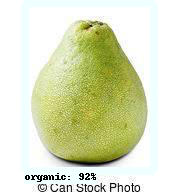

[0.9211352  0.12179265 0.11592075 0.11573734 0.10625057 0.10584167
 0.0987912  0.09541616 0.09259222 0.08587372 0.08517763 0.08509765
 0.07974785 0.07885573 0.07481861 0.07317701 0.07274428 0.07234689
 0.07214073 0.07124517 0.07110219 0.07049081 0.06790795 0.06670502
 0.06593157 0.06545735 0.06477582 0.06470721 0.06314303 0.06148798
 0.06050502 0.06048464 0.05974946 0.05945663 0.05889716 0.05807943
 0.05764843 0.05710253 0.05681871 0.05354215 0.05316227 0.05286171
 0.05278856 0.05239818 0.05053208 0.04946258 0.04882501 0.04859529
 0.0479138  0.04787624 0.04780283 0.047774   0.04767825 0.04751701
 0.04747553 0.04739813 0.04693769 0.04597123 0.04544418 0.04492089
 0.04456782 0.04423136 0.04404242 0.04400412 0.04373721 0.04349716
 0.04335872 0.04335276 0.04317352 0.04314953 0.04251051 0.04236306
 0.04235335 0.04191216 0.04178216 0.04171395 0.04131387 0.04125677
 0.04112988 0.04070557 0.0401924  0.03989462 0.03970284 0.03955392
 0.03944442 0.03935183 0.03927156 0.03887532 0.03873588 0.0385

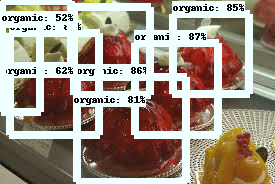

[0.86835295 0.85990876 0.8516545  0.8400788  0.8080007  0.61987835
 0.5152344  0.49352488 0.41416267 0.35643026 0.3519693  0.35195976
 0.29097447 0.24587944 0.24402945 0.19654503 0.19060352 0.18794736
 0.18061489 0.17014053 0.16887443 0.16149928 0.1562547  0.15524703
 0.14344887 0.13144828 0.13130343 0.13106075 0.12823588 0.12665072
 0.12316872 0.12047158 0.11881997 0.11701879 0.11631478 0.1160837
 0.1137699  0.10819063 0.10764056 0.10653237 0.10489959 0.10154948
 0.09969479 0.09952815 0.09947344 0.09858681 0.09740506 0.0966928
 0.09231655 0.09108731 0.090359   0.09022395 0.08986461 0.08816589
 0.08681823 0.08643441 0.08367471 0.08324841 0.08158349 0.07792854
 0.0710185  0.0702384  0.06728826 0.0667618  0.06497987 0.06377194
 0.06361677 0.06297193 0.06271729 0.06233563 0.06232269 0.06173191
 0.0615738  0.06139317 0.06119845 0.06114566 0.06089255 0.06019578
 0.0599797  0.05964185 0.05920592 0.05879274 0.05851094 0.05810789
 0.05789681 0.05775108 0.05708153 0.05699565 0.05669453 0.056653

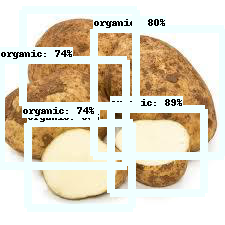

[0.8921216  0.8784685  0.8023301  0.74285334 0.7411625  0.3986394
 0.389366   0.3138646  0.18627207 0.1842536  0.17675485 0.15958588
 0.11031556 0.09415337 0.07883293 0.07871955 0.07554742 0.07480353
 0.07109492 0.06606307 0.06548897 0.06509849 0.06375825 0.06356324
 0.06309235 0.06279677 0.06187148 0.05853786 0.05803541 0.05791632
 0.05619455 0.0555677  0.05517445 0.05497765 0.05442206 0.05367281
 0.05300453 0.05263488 0.0525863  0.05111481 0.0509254  0.05089729
 0.05019535 0.05016492 0.04998884 0.04952377 0.04891376 0.04827987
 0.04724261 0.04675375 0.04640947 0.04613293 0.04596886 0.04562774
 0.04554057 0.04461578 0.04412693 0.04406655 0.04396614 0.04391063
 0.04217866 0.04201093 0.04192938 0.04169455 0.04149851 0.04123678
 0.04088027 0.04076207 0.04039189 0.04035792 0.04030431 0.04016485
 0.03946332 0.03895185 0.03893052 0.03882125 0.03825937 0.03817131
 0.03808256 0.03786695 0.03771329 0.03770595 0.03741191 0.03739786
 0.03734266 0.036407   0.0362369  0.03598184 0.03580087 0.03575

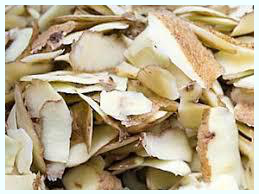

[0.91432726 0.3643645  0.1341663  0.11985838 0.11845604 0.11011666
 0.10674239 0.09953529 0.09129114 0.08973382 0.08958422 0.08735008
 0.08196124 0.08184157 0.07619902 0.07467052 0.07466867 0.0730871
 0.06873636 0.06716572 0.06463829 0.06130053 0.0589744  0.05753423
 0.05685206 0.05619286 0.05294609 0.05230003 0.05214509 0.05198636
 0.05022176 0.04797665 0.04794899 0.04619832 0.04613049 0.04609666
 0.04569112 0.04514851 0.04513259 0.04476666 0.04466482 0.04448399
 0.04402415 0.04379093 0.04357199 0.04319654 0.04256127 0.04212928
 0.04194592 0.04140102 0.04133075 0.04116512 0.04034514 0.03995172
 0.03993754 0.03900548 0.03885356 0.03835477 0.03833374 0.03795226
 0.03776466 0.03742988 0.03719278 0.03712019 0.03662555 0.03620829
 0.03614551 0.03607665 0.03603871 0.03597107 0.03593917 0.03522189
 0.03497026 0.03488883 0.03486056 0.03444882 0.03435385 0.03432802
 0.03413853 0.03396705 0.03395995 0.03391983 0.03382036 0.03368135
 0.0334015  0.03299114 0.03256789 0.03243374 0.0324236  0.03224

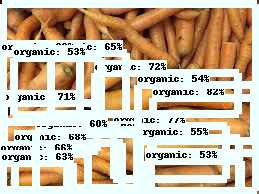

[0.8461696  0.8223319  0.7671999  0.71979266 0.70811105 0.6982037
 0.6784724  0.6590621  0.65150505 0.63212174 0.60298055 0.6016199
 0.5459179  0.5431116  0.5317906  0.5255841  0.49995685 0.49374402
 0.4934776  0.47900873 0.46384084 0.45792463 0.43986928 0.42975536
 0.42039174 0.4168912  0.41288534 0.39955342 0.3743039  0.37187716
 0.3671374  0.36574772 0.357523   0.35743314 0.349612   0.34157544
 0.33872595 0.32909113 0.32818678 0.3214295  0.3192446  0.31795144
 0.3159004  0.31235957 0.30989322 0.30759838 0.3074596  0.3072365
 0.3070247  0.30298597 0.29667377 0.29228598 0.2827917  0.28147936
 0.2769626  0.26073727 0.26029587 0.25863907 0.25708807 0.25254276
 0.24404791 0.24224105 0.24117811 0.24083334 0.2405885  0.24043027
 0.23902889 0.23877288 0.23837557 0.23778895 0.23266701 0.22807784
 0.22438627 0.21727914 0.2153998  0.2151245  0.21141246 0.21120049
 0.19969538 0.19815339 0.19797061 0.19780305 0.19597128 0.192428
 0.18940574 0.18725431 0.18647344 0.18478368 0.1796073  0.17889242


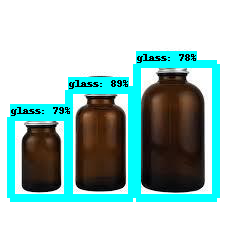

[0.891233   0.78631186 0.78108037 0.14050911 0.11864954 0.11760262
 0.11546665 0.11467996 0.11455986 0.1039286  0.10377783 0.10349716
 0.10054059 0.09752401 0.0949774  0.09377033 0.09345893 0.09232036
 0.08942548 0.08827846 0.08806743 0.08751451 0.08643703 0.08608542
 0.08542798 0.0833991  0.08297842 0.08275433 0.08211583 0.08080861
 0.07870276 0.07757987 0.07637535 0.07581598 0.07353543 0.07352235
 0.07308951 0.07229108 0.07224562 0.0707901  0.06995562 0.06992799
 0.06816898 0.06799082 0.06617701 0.06611143 0.06604363 0.06524726
 0.06436145 0.06427147 0.06353793 0.06309399 0.06286862 0.06284677
 0.06193652 0.06190968 0.06175134 0.06126272 0.06084843 0.06017791
 0.06013843 0.05808841 0.05787522 0.05780325 0.05726518 0.05710786
 0.05671154 0.05647048 0.05636778 0.05625147 0.0544923  0.05434535
 0.05412628 0.05311431 0.0529642  0.05288632 0.05264851 0.05243817
 0.05224254 0.05223898 0.05216151 0.05131365 0.05080003 0.05058196
 0.05049938 0.05041761 0.05036242 0.05031373 0.04996659 0.0499

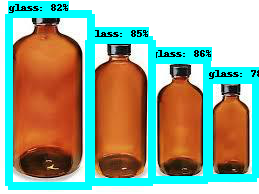

[0.8614857  0.8519081  0.81862825 0.7819467  0.17095983 0.1420816
 0.12368311 0.11207771 0.10228693 0.08886499 0.08482039 0.08086941
 0.08014179 0.07976885 0.07543092 0.0744827  0.07434954 0.07378007
 0.07317827 0.07169386 0.07026404 0.0700257  0.06867674 0.06692018
 0.06583788 0.06548809 0.06507422 0.06460841 0.06445242 0.0642122
 0.06409447 0.06211583 0.0602696  0.05963559 0.05938354 0.05923314
 0.05902073 0.05884191 0.05878114 0.05801331 0.05694186 0.05683605
 0.05614521 0.05575065 0.05550429 0.0547898  0.05413787 0.05316484
 0.05313689 0.05149277 0.05089747 0.05040691 0.05023998 0.04992635
 0.04984196 0.04966464 0.04927618 0.0491649  0.04914665 0.04894895
 0.04862086 0.0485115  0.04832759 0.04824307 0.04786905 0.04749449
 0.04659479 0.04631054 0.04593061 0.04580855 0.04578904 0.04486811
 0.04482582 0.04456398 0.04400264 0.04378946 0.04375793 0.04362964
 0.04357314 0.04351758 0.04340439 0.04292933 0.04252459 0.04242717
 0.041575   0.04152157 0.04117355 0.04113784 0.04106211 0.040816

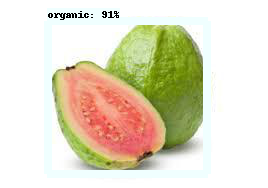

[0.9143556  0.22789913 0.1536972  0.14145665 0.12872255 0.11589577
 0.11392208 0.11083738 0.11062209 0.10804999 0.10114054 0.09759218
 0.09614041 0.09373196 0.09012126 0.08980548 0.08616888 0.08593017
 0.08406337 0.0783762  0.07574924 0.07450779 0.07412239 0.07395541
 0.0733211  0.07257979 0.07229236 0.07213114 0.07204394 0.07090863
 0.06992965 0.06632448 0.06569377 0.06449288 0.06248279 0.06145168
 0.06079189 0.05993852 0.05869478 0.05793727 0.05694797 0.05689978
 0.05599491 0.05524507 0.05472931 0.05469871 0.05468047 0.0546183
 0.05381946 0.05270651 0.05262471 0.05254612 0.05209951 0.05184775
 0.05141667 0.05068292 0.05026683 0.04973567 0.04969003 0.04960033
 0.04868442 0.04865963 0.04864653 0.04792231 0.0478309  0.04780576
 0.04772398 0.04714121 0.04656305 0.04649764 0.04645497 0.04641665
 0.04635504 0.0454916  0.04538046 0.04526831 0.04496824 0.04490607
 0.0448459  0.04379078 0.04359425 0.04340055 0.04316213 0.04297156
 0.04259744 0.04209994 0.04208786 0.04200761 0.04194276 0.04188

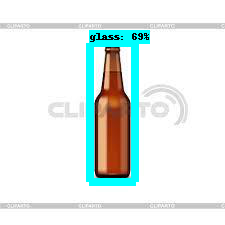

[0.6890922  0.30745268 0.28925148 0.28340495 0.27631545 0.26804265
 0.21570121 0.19970807 0.19407953 0.18920171 0.18184775 0.1711378
 0.1678658  0.15797214 0.14933501 0.14555332 0.14393477 0.13834791
 0.128479   0.12602621 0.12280904 0.12026725 0.1195824  0.11759571
 0.11166839 0.10888331 0.10830301 0.10483538 0.10470916 0.1038617
 0.10137231 0.10105799 0.09750827 0.09732228 0.09623741 0.09486488
 0.09454802 0.09377424 0.09257396 0.09032121 0.09026388 0.09014076
 0.08803556 0.08764987 0.08656942 0.08638964 0.08443633 0.08187789
 0.0814983  0.081301   0.07998934 0.07980824 0.07971357 0.07857487
 0.07728688 0.07612388 0.07546876 0.07520148 0.07262834 0.07247914
 0.07236455 0.07228277 0.0722446  0.07069944 0.07035733 0.06979582
 0.06917954 0.06911574 0.06825688 0.06801732 0.06767064 0.06764215
 0.06725549 0.06718947 0.06698048 0.06654862 0.06630573 0.06601895
 0.06543241 0.06459618 0.06443002 0.06411079 0.06369915 0.0634256
 0.06237381 0.06228789 0.06207415 0.06192217 0.06114766 0.0608155

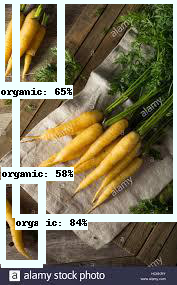

[0.8432835  0.64619917 0.5817684  0.38702402 0.32224587 0.2423374
 0.1856888  0.18473229 0.17801453 0.16972479 0.15865137 0.14728054
 0.14204586 0.14137322 0.14111269 0.13890772 0.12572394 0.12425993
 0.12237655 0.12229028 0.12207179 0.11712705 0.11698102 0.11561166
 0.10990851 0.10663343 0.10595022 0.10519096 0.09815095 0.097161
 0.09290382 0.09161815 0.09034215 0.09011839 0.08722221 0.08467902
 0.08435194 0.08320209 0.08245246 0.08192657 0.08087965 0.07732531
 0.07606787 0.07584636 0.07584471 0.07578163 0.07561948 0.07415437
 0.07400782 0.07364648 0.0725125  0.0722789  0.07201878 0.07116432
 0.07066959 0.06961971 0.06731155 0.06713481 0.06687455 0.0666159
 0.06573149 0.06549151 0.06497254 0.0644877  0.0644438  0.06442519
 0.06440046 0.06439563 0.06414737 0.06354623 0.06332925 0.06228517
 0.06195797 0.0616613  0.06028931 0.05974232 0.05896895 0.05777014
 0.05612382 0.05586172 0.05545476 0.05517967 0.05442894 0.05385965
 0.0532499  0.05244954 0.05192031 0.05185781 0.05168916 0.05123671

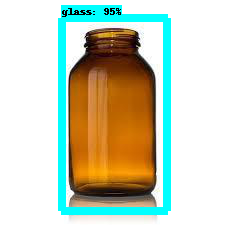

[0.9492519  0.24615523 0.24170823 0.2308668  0.2069319  0.20690118
 0.19826931 0.18199751 0.1708625  0.16673066 0.14799184 0.1478283
 0.14487103 0.14097644 0.1375522  0.13547876 0.13196872 0.12884325
 0.11269994 0.10813166 0.10792705 0.10587757 0.10369755 0.10358974
 0.10297809 0.10071342 0.09842987 0.0970515  0.09330758 0.09309897
 0.09224099 0.09076339 0.09070136 0.09007652 0.08936054 0.08778761
 0.08757237 0.08722174 0.08625647 0.08553118 0.08391989 0.08233432
 0.08126506 0.08064621 0.08007113 0.08001716 0.07949346 0.07899169
 0.07798582 0.07721899 0.07717671 0.07631963 0.07592393 0.07584571
 0.07582222 0.07425124 0.07331832 0.07290997 0.07271605 0.0721302
 0.07136729 0.07079123 0.07031684 0.07002805 0.06980505 0.06897614
 0.06867059 0.06820229 0.06791177 0.06691567 0.0663005  0.06533867
 0.06522071 0.06445938 0.0642329  0.06318141 0.06284956 0.06206972
 0.0620577  0.06085296 0.06072334 0.06041962 0.06014443 0.05963138
 0.05922532 0.05909512 0.05838995 0.05801212 0.05752291 0.057504

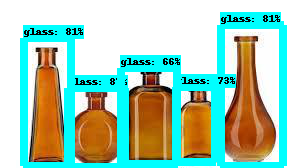

[0.8652534  0.81217265 0.8066646  0.73411095 0.6566532  0.17991251
 0.1725283  0.12484742 0.12342261 0.10301324 0.10117427 0.09592729
 0.09513059 0.09265863 0.09089226 0.08917144 0.08081166 0.07813702
 0.07660477 0.07594444 0.07513674 0.07449393 0.07401166 0.07384399
 0.07324997 0.07255935 0.07240732 0.07222927 0.07220675 0.07196379
 0.07190959 0.07133499 0.06903049 0.06874601 0.06842121 0.06789328
 0.0678034  0.06467295 0.06451982 0.06423826 0.0634068  0.0629094
 0.06247815 0.06220045 0.06155634 0.06015576 0.05962834 0.05959137
 0.05901138 0.05900298 0.05892577 0.05853152 0.05668787 0.05667508
 0.05645781 0.05631914 0.05566113 0.05454867 0.05338378 0.05241368
 0.05240358 0.05184656 0.05173138 0.05167641 0.05158888 0.05135475
 0.05072359 0.05046936 0.05043109 0.05020672 0.0494457  0.04914387
 0.04877507 0.04867156 0.048664   0.04861112 0.04860763 0.04813793
 0.04786627 0.04781607 0.04776126 0.04730285 0.04716318 0.04663654
 0.04658635 0.04626007 0.04605323 0.04532664 0.04525636 0.04507

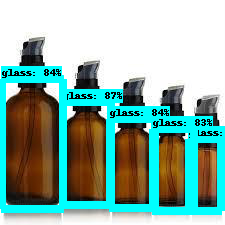

[0.87882453 0.87091094 0.84352565 0.841029   0.82576907 0.3317149
 0.3112617  0.2607518  0.17837906 0.1783498  0.14361364 0.12824874
 0.12426123 0.11534368 0.10957126 0.10857771 0.10532731 0.10364341
 0.09876773 0.0976245  0.09577817 0.09562694 0.08755654 0.08520491
 0.08102518 0.08006993 0.07647666 0.07530692 0.07278612 0.07192321
 0.06828097 0.06680638 0.06652863 0.06538701 0.06477982 0.06368311
 0.06319509 0.06174798 0.06163292 0.06161873 0.06130017 0.06115843
 0.06017524 0.05986277 0.05924907 0.05909234 0.05900911 0.05803737
 0.05717827 0.05685606 0.05679633 0.05614407 0.05607371 0.05569816
 0.05568122 0.05509315 0.05487414 0.05439074 0.05361538 0.05358152
 0.05326901 0.05322418 0.05192034 0.04918841 0.04911586 0.04830191
 0.04805912 0.04786333 0.04701429 0.04698918 0.04675005 0.04667994
 0.04651042 0.04635742 0.04634759 0.04567794 0.04537672 0.04503009
 0.0448834  0.04487839 0.04412904 0.04394393 0.04380193 0.04378759
 0.0435493  0.04346719 0.04337216 0.04332032 0.04310274 0.04305

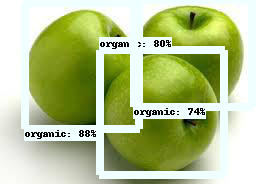

[0.8807019  0.80218107 0.74014556 0.33457747 0.11239378 0.09670512
 0.08994468 0.08993719 0.0872973  0.08352327 0.08190953 0.08056286
 0.07706492 0.07351037 0.07155069 0.0690953  0.06857751 0.06837758
 0.06825732 0.06521589 0.06472403 0.06091261 0.05883253 0.05790072
 0.05596859 0.05558459 0.05497767 0.05369622 0.05307389 0.05285459
 0.05250694 0.05229454 0.05224007 0.05194829 0.05088706 0.0505763
 0.04913373 0.04853753 0.04775409 0.04751438 0.04726692 0.04526374
 0.04490351 0.04487284 0.04478773 0.04399753 0.04355336 0.04306436
 0.04287137 0.04254427 0.04185573 0.04161739 0.04068261 0.04043665
 0.04037314 0.04020656 0.04017825 0.0398693  0.03953372 0.03890916
 0.0387238  0.03868812 0.0384485  0.03822134 0.03819581 0.03814151
 0.03813809 0.03774228 0.03754318 0.03736052 0.03720619 0.03657019
 0.03651339 0.03645015 0.03592316 0.03554587 0.03532349 0.03507509
 0.03444784 0.03436122 0.03416153 0.03413245 0.03386732 0.03363279
 0.03358487 0.0333395  0.03330373 0.0330699  0.03305474 0.03291

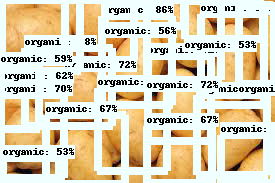

[0.91102046 0.88395786 0.8627611  0.85998917 0.84435266 0.82067555
 0.7184498  0.7182205  0.7017896  0.67372924 0.6713643  0.6322194
 0.616849   0.5949276  0.5922279  0.5582467  0.5327652  0.5281121
 0.4916507  0.44511428 0.44212598 0.41954604 0.40728563 0.39248756
 0.38201922 0.36044458 0.35576496 0.35507053 0.33828813 0.33802968
 0.3357487  0.332535   0.3301081  0.32920194 0.3251     0.32373855
 0.32151234 0.3198861  0.31555915 0.31471857 0.3144442  0.3052573
 0.29797617 0.2964873  0.2956593  0.28549957 0.284216   0.28378895
 0.27384925 0.27350387 0.2716153  0.2666959  0.26222324 0.26179174
 0.2565262  0.25468713 0.24702373 0.24318308 0.24271755 0.23658004
 0.23568426 0.2263393  0.2233334  0.22175236 0.21896167 0.21792395
 0.21747127 0.21593715 0.21409892 0.21313827 0.21083802 0.21012846
 0.2091608  0.20906067 0.20847403 0.20845331 0.20685704 0.20600213
 0.2041331  0.20116672 0.20010988 0.19553943 0.19456695 0.19102319
 0.18909131 0.18674372 0.18496881 0.18324368 0.18211924 0.1813434

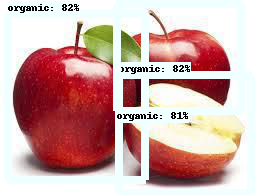

[0.8248924  0.8232266  0.80527204 0.1962927  0.16655338 0.15825193
 0.08583641 0.0850047  0.08041409 0.07929063 0.07430659 0.07416686
 0.0707853  0.07033848 0.06605043 0.06144625 0.06024616 0.05929612
 0.05753228 0.05678262 0.05566191 0.05506743 0.05401291 0.05304274
 0.05217638 0.05179957 0.05110935 0.05087462 0.05007584 0.04957263
 0.04921473 0.04873593 0.0484117  0.04822781 0.0480362  0.04768155
 0.0467824  0.0467439  0.04534433 0.04532658 0.04503202 0.04486594
 0.04479658 0.04458971 0.04431323 0.0441571  0.04414787 0.04366479
 0.04333942 0.04327255 0.04318186 0.04243921 0.04237034 0.04201166
 0.04180255 0.0416491  0.04136609 0.04096208 0.04092603 0.04069552
 0.0405682  0.04050814 0.04040184 0.03994907 0.03969055 0.03882692
 0.03818327 0.03782469 0.03724983 0.03708508 0.03703365 0.0366729
 0.03662231 0.03656044 0.03652965 0.03639051 0.03618289 0.03585694
 0.03582117 0.03568731 0.03567497 0.03541837 0.03527842 0.03512562
 0.03477557 0.03463567 0.03436082 0.03411464 0.03410596 0.03407

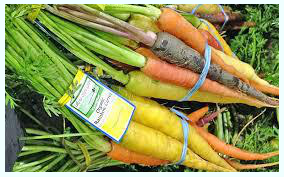

[0.914506   0.23522468 0.12873563 0.12650876 0.10753422 0.10659708
 0.10090319 0.09845829 0.09378946 0.08801485 0.08780812 0.08325838
 0.07982469 0.0743919  0.07269551 0.06950093 0.06367751 0.06355084
 0.06325239 0.06145168 0.06057984 0.05998385 0.05978346 0.05752447
 0.05561471 0.05462948 0.05388542 0.05305907 0.05140907 0.05089586
 0.05086455 0.04972295 0.04941136 0.04795987 0.04626425 0.04617835
 0.04604634 0.0459669  0.04545129 0.04462433 0.04400397 0.04320415
 0.04279    0.04276633 0.04233248 0.04115749 0.04107184 0.04099886
 0.04093632 0.04062156 0.04049645 0.03974324 0.03944725 0.03896849
 0.03834292 0.03830121 0.0380335  0.0374219  0.03707434 0.03663944
 0.03528941 0.03498206 0.0348503  0.03456153 0.03433525 0.03423395
 0.03416093 0.033211   0.03305067 0.03291189 0.03253433 0.03241623
 0.03240447 0.03234811 0.0323473  0.03196282 0.0315435  0.03138338
 0.03135687 0.03135291 0.03092968 0.03090717 0.03076647 0.03067048
 0.0306425  0.0303803  0.03010018 0.02950023 0.02930561 0.0291

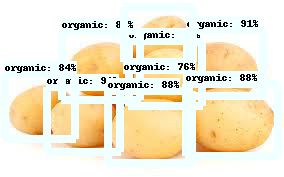

[0.92417574 0.9124202  0.9079638  0.88476694 0.88021195 0.87956387
 0.83731985 0.75733393 0.15207282 0.13737996 0.12213837 0.12066914
 0.11786177 0.10208225 0.09353444 0.08905476 0.08868227 0.08227951
 0.07879347 0.07776824 0.07682983 0.07626498 0.07436805 0.07296973
 0.07216279 0.06952464 0.06927201 0.0685139  0.06844103 0.06569226
 0.06558844 0.06551148 0.06386071 0.06322981 0.06309425 0.06111024
 0.06000827 0.0598414  0.05955797 0.05932703 0.05922887 0.05895513
 0.05894908 0.05837129 0.05753828 0.05663276 0.05641811 0.0558585
 0.0547605  0.05475194 0.05456182 0.05455543 0.05454933 0.05425608
 0.05414722 0.05397283 0.05396137 0.05380518 0.05366302 0.05343939
 0.05318924 0.05249336 0.05246149 0.05154215 0.05115143 0.05109341
 0.05080495 0.0504074  0.05025464 0.05007986 0.04904509 0.04828637
 0.04804075 0.04771528 0.0475882  0.04721662 0.04657279 0.04657051
 0.04626999 0.04605665 0.04542983 0.04542465 0.04523595 0.04512311
 0.04418727 0.04409022 0.04391132 0.04344997 0.04344712 0.04334

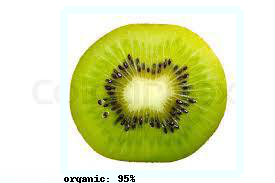

[0.9523906  0.23607227 0.19526963 0.19134003 0.1600995  0.13709202
 0.12222774 0.11294595 0.10288698 0.0951023  0.09056052 0.08880096
 0.08455577 0.08402921 0.08282954 0.08167582 0.08142258 0.07475444
 0.07464599 0.07462203 0.07341187 0.06995317 0.06989629 0.06897407
 0.06860263 0.06859326 0.06835452 0.06742311 0.06678402 0.06641667
 0.06597011 0.06488407 0.06371657 0.0617961  0.06171562 0.06092256
 0.06058266 0.06045855 0.06009258 0.05889271 0.05881388 0.05844938
 0.05835972 0.05774468 0.05698862 0.05583253 0.05509662 0.05420798
 0.05402115 0.05387001 0.05360917 0.0533294  0.05292222 0.05278516
 0.05187349 0.05132679 0.05100331 0.05090507 0.05075365 0.04923763
 0.04860195 0.0482136  0.04751656 0.04739315 0.04722993 0.0471484
 0.04644958 0.04634138 0.04609546 0.04507009 0.04494451 0.04474296
 0.04433458 0.04361207 0.04344882 0.04240826 0.04239256 0.04221191
 0.04150705 0.04128887 0.04122654 0.04027969 0.0400827  0.03969061
 0.03957309 0.03955262 0.03929626 0.03926028 0.03914608 0.03910

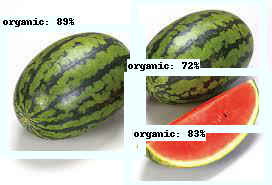

[0.89325285 0.83053035 0.72021383 0.15288334 0.13387968 0.13189298
 0.12767036 0.11881059 0.10555871 0.10389109 0.09228929 0.08055887
 0.07742044 0.07730934 0.07619005 0.0722298  0.07097479 0.07042943
 0.07034955 0.06802756 0.06647241 0.06626454 0.06602551 0.06480297
 0.06470609 0.06411208 0.06200477 0.06128262 0.05989885 0.05921137
 0.05908149 0.05889554 0.05781699 0.05741943 0.05646344 0.05519028
 0.05493385 0.05286384 0.05170207 0.05053508 0.04995922 0.04960804
 0.04959974 0.04959719 0.04890594 0.04869186 0.04821888 0.04614734
 0.04587347 0.04573704 0.0451098  0.04505833 0.04503274 0.0445365
 0.04448279 0.04372356 0.04325551 0.04315226 0.04312979 0.04214482
 0.04119465 0.04115459 0.04103748 0.04070094 0.04062072 0.04043106
 0.04033412 0.04008617 0.03988535 0.03953501 0.03906723 0.038452
 0.03795086 0.03787761 0.03779705 0.03778104 0.03775934 0.03741863
 0.03705374 0.03678382 0.03656398 0.03554917 0.03516954 0.03516772
 0.03504438 0.03491297 0.03489357 0.03488036 0.03487593 0.0348246

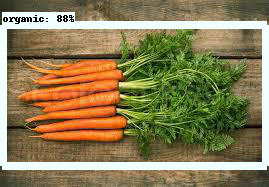

[0.8777993  0.30617344 0.2755499  0.26567736 0.21890455 0.18817687
 0.17447145 0.17380475 0.14909196 0.1468293  0.14198601 0.14173678
 0.13994738 0.13953522 0.13815904 0.12628248 0.12386024 0.11774342
 0.1125726  0.10892899 0.10625911 0.10096927 0.10064208 0.09939957
 0.09194422 0.0917163  0.08636922 0.0826866  0.0809465  0.07867038
 0.07841004 0.0754818  0.0746962  0.07404369 0.07327587 0.0729955
 0.07267392 0.07199739 0.07136057 0.07065681 0.07045853 0.0696362
 0.06931582 0.06789938 0.06765076 0.06686962 0.06633702 0.06622116
 0.06617834 0.06617754 0.06607964 0.06546243 0.06441789 0.06397086
 0.06327236 0.06299026 0.06251527 0.06204918 0.06167222 0.06162456
 0.06114912 0.06045308 0.06028818 0.05897655 0.05830982 0.05740407
 0.05738533 0.05663673 0.05660288 0.0560811  0.05578836 0.05565145
 0.05565102 0.05520381 0.05449528 0.05419892 0.05385239 0.05320571
 0.05245055 0.05231787 0.05228293 0.05213742 0.05057439 0.05015885
 0.05011942 0.05008984 0.04986925 0.04929181 0.04917728 0.048811

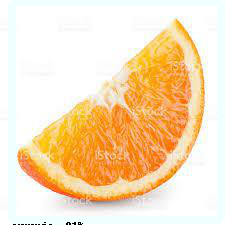

[0.9058043  0.17957863 0.1738489  0.17298779 0.16589598 0.14203355
 0.11717987 0.11537274 0.10540915 0.10393347 0.10167852 0.1008812
 0.09925381 0.09724201 0.09545439 0.09469089 0.09413778 0.09359205
 0.09007967 0.08926891 0.08760256 0.08584543 0.0823622  0.08158042
 0.08151145 0.07949687 0.07913624 0.07911637 0.07905564 0.07757499
 0.07693642 0.07607864 0.07587165 0.0751704  0.07249337 0.07217953
 0.07170538 0.07159033 0.07078221 0.06995849 0.06906141 0.06849032
 0.06784974 0.06770519 0.06516103 0.06484764 0.06444687 0.06444234
 0.06439643 0.06394725 0.06377908 0.06351317 0.06242269 0.06235056
 0.0622225  0.06149727 0.06141895 0.06083836 0.06068543 0.06011072
 0.05972461 0.05894396 0.05836586 0.05828148 0.05687942 0.05650762
 0.05596324 0.05380419 0.05354517 0.05249314 0.05154078 0.05089503
 0.05061333 0.05006837 0.04909015 0.04818504 0.04773425 0.04756074
 0.04607482 0.04580405 0.0453419  0.04510891 0.04486473 0.04469825
 0.04399789 0.04370002 0.04364479 0.04353539 0.04349861 0.04343

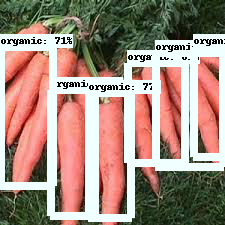

[0.8084684  0.7826061  0.77359396 0.765565   0.70860475 0.50237983
 0.43755198 0.27838212 0.27267185 0.25422087 0.25048548 0.24283874
 0.23794143 0.21226569 0.20292626 0.18552646 0.1843525  0.178601
 0.17807578 0.17623839 0.16949695 0.16724    0.16627985 0.16323619
 0.1616499  0.16054387 0.15747978 0.15598287 0.15460604 0.15326951
 0.15246363 0.15206929 0.14532001 0.14467166 0.14417888 0.14311112
 0.14000115 0.13987502 0.13839789 0.13709529 0.13699146 0.13212538
 0.13203388 0.12868911 0.12849541 0.1280419  0.12505472 0.12367903
 0.12117267 0.1192624  0.11838511 0.11771537 0.1176427  0.11331708
 0.10968626 0.10814944 0.10760269 0.10746361 0.10349281 0.10036531
 0.09979117 0.096072   0.09462219 0.09444549 0.09311183 0.0925511
 0.09161615 0.09116908 0.09034663 0.09005798 0.08807887 0.08502393
 0.08466696 0.0844252  0.0837912  0.08368603 0.0834033  0.08295833
 0.08242299 0.08224633 0.08222739 0.08144542 0.081296   0.08116018
 0.08046577 0.07945894 0.07921429 0.07800847 0.07797066 0.0766022

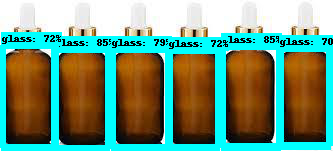

[0.8548217  0.84660745 0.7915482  0.7234642  0.7230335  0.70266175
 0.28921098 0.28126156 0.26368612 0.25175503 0.23503403 0.2275089
 0.21740435 0.20769958 0.206059   0.20405313 0.19644183 0.1885939
 0.18182747 0.1800616  0.1733094  0.16983862 0.16956536 0.16932836
 0.16780983 0.1672987  0.16685954 0.16314876 0.16080546 0.1577825
 0.15137477 0.14861722 0.14810479 0.14315432 0.14039847 0.13969636
 0.13944004 0.13907982 0.13059309 0.13009642 0.12741141 0.12679517
 0.12662987 0.12540977 0.12402731 0.12320178 0.12212979 0.12092223
 0.11980363 0.11889266 0.1185514  0.11737756 0.11482913 0.11350048
 0.11341128 0.11255861 0.11198707 0.1118863  0.11117727 0.11110687
 0.11096061 0.11039483 0.10301403 0.10209461 0.10022746 0.10005183
 0.09739903 0.09685007 0.09545213 0.09355046 0.09077525 0.08987994
 0.08987457 0.08932473 0.08924765 0.08883414 0.08653565 0.08632336
 0.0860159  0.08531012 0.08432456 0.0842351  0.08347537 0.08326662
 0.08325414 0.08261285 0.08211092 0.08140127 0.07902537 0.0785671

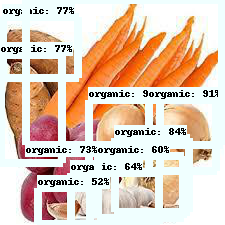

[0.92554635 0.9081293  0.8379714  0.77440095 0.77165365 0.7251213
 0.64332783 0.6019392  0.5233539  0.4933803  0.28701508 0.2580634
 0.24935104 0.22790408 0.21056657 0.2057951  0.19046871 0.15903412
 0.15568292 0.14993806 0.14900126 0.14604484 0.1458663  0.14476004
 0.14162704 0.13397561 0.13343047 0.13233899 0.13126504 0.1298479
 0.12708406 0.12609425 0.12002031 0.11872663 0.11863878 0.11615587
 0.11554001 0.11479985 0.11426958 0.10995974 0.10835575 0.10405503
 0.09607521 0.09524081 0.09499397 0.09417401 0.0918441  0.0910467
 0.09066098 0.09050453 0.09038177 0.08942515 0.08609965 0.08589443
 0.08586128 0.08403015 0.08292367 0.08101036 0.08072931 0.08062621
 0.08030839 0.08022308 0.07915686 0.07649551 0.07394937 0.07324727
 0.07322071 0.07244406 0.07243425 0.07236726 0.0719639  0.07107628
 0.07087603 0.07074691 0.07067518 0.0703112  0.06962775 0.06938073
 0.06914161 0.06868726 0.06782868 0.06772648 0.0668176  0.06645332
 0.06641296 0.06614273 0.06416127 0.06412496 0.06300748 0.06182156

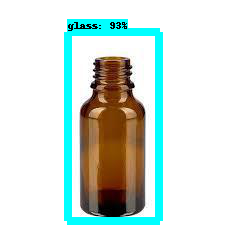

[0.9267673  0.2618351  0.18822077 0.18676344 0.18063661 0.17653422
 0.17203735 0.16651285 0.16148521 0.15074766 0.13038655 0.12961315
 0.11807083 0.11661507 0.11041686 0.10935355 0.10885029 0.10620365
 0.10330305 0.10116985 0.10080975 0.10060169 0.09863532 0.09416958
 0.09389748 0.09360358 0.09304332 0.09144856 0.09010261 0.0893078
 0.08860885 0.08777948 0.08441602 0.08417382 0.08407535 0.08379594
 0.08335748 0.08305604 0.08273329 0.08162387 0.07885451 0.0768402
 0.07672052 0.07450035 0.07373866 0.07365172 0.0733124  0.07041123
 0.06846334 0.06842537 0.06801745 0.06792814 0.06636777 0.06628965
 0.06613339 0.06455177 0.06454664 0.06425016 0.06423995 0.06418545
 0.06347926 0.06304006 0.06279957 0.0627939  0.06233132 0.06185564
 0.0616287  0.06155301 0.06104508 0.06074868 0.06074847 0.06073099
 0.06017375 0.05995011 0.05979294 0.05924648 0.059149   0.05814682
 0.05723379 0.05718743 0.05666215 0.05663703 0.05647985 0.05634173
 0.05618023 0.05598607 0.05575017 0.05520478 0.05510623 0.054977

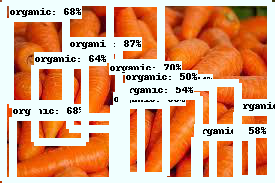

[0.86512864 0.8390753  0.74161834 0.6952459  0.69375473 0.6818599
 0.6785632  0.6437516  0.5754922  0.56988865 0.53862417 0.5040937
 0.4978256  0.48719126 0.4845382  0.44319642 0.42611656 0.42260662
 0.42156437 0.41681373 0.40430558 0.38390532 0.37844014 0.37612852
 0.36445367 0.35215157 0.3496772  0.31307483 0.30776682 0.3076581
 0.30715722 0.30303454 0.302214   0.29148415 0.28929287 0.2852758
 0.28126252 0.27505353 0.2665312  0.25267985 0.25244626 0.2514256
 0.23945554 0.2349518  0.23028822 0.22554219 0.2245631  0.22347414
 0.21306951 0.20927204 0.20636898 0.20523967 0.20453532 0.20259824
 0.2009976  0.20072606 0.19871888 0.19834268 0.19810872 0.19565493
 0.1952392  0.19442837 0.19358425 0.19074835 0.19057798 0.18716064
 0.18559776 0.18512091 0.18225834 0.18178152 0.1794645  0.17936432
 0.1782549  0.17819491 0.17815958 0.17793424 0.1771924  0.17556643
 0.17500873 0.17386702 0.17357546 0.17167568 0.1716524  0.17119335
 0.17004187 0.16673116 0.16635388 0.16522051 0.16374025 0.16358313


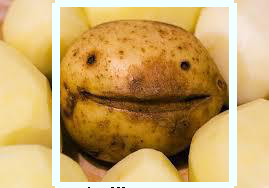

[0.89889514 0.48745912 0.4585002  0.3988088  0.38226596 0.37220708
 0.3330098  0.32453284 0.31723022 0.29499134 0.26876235 0.26219258
 0.24847785 0.22988927 0.22539164 0.20123926 0.196529   0.19393611
 0.18527593 0.17382182 0.17240946 0.16807556 0.15830866 0.15511353
 0.15461808 0.15270755 0.15176909 0.15091103 0.14985575 0.14886424
 0.14737937 0.14061289 0.13981001 0.13941498 0.13741508 0.13418332
 0.13336544 0.13162129 0.13046625 0.12664646 0.12581457 0.12329582
 0.12105101 0.12068745 0.12037654 0.11757682 0.10928704 0.10909046
 0.10753769 0.10745069 0.10732006 0.10716119 0.10706364 0.10617802
 0.1051562  0.10303579 0.09647919 0.09554768 0.09495738 0.09376203
 0.09301363 0.09289408 0.09274893 0.0921704  0.09174981 0.09057782
 0.08905637 0.08765391 0.087604   0.087583   0.08485245 0.08464233
 0.08439635 0.08378009 0.08362731 0.08331686 0.08223736 0.07913645
 0.07836799 0.07800759 0.07635491 0.07631138 0.07624467 0.07599372
 0.07583795 0.07519007 0.07447085 0.07368124 0.0733014  0.0729

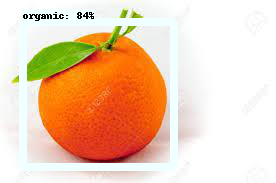

[0.8399     0.18134974 0.15719648 0.14731266 0.1460968  0.13703024
 0.13625325 0.13317148 0.1308345  0.11927924 0.1129119  0.10965809
 0.10636661 0.10269623 0.09778714 0.09511703 0.0941136  0.09346513
 0.09336946 0.09080373 0.08968765 0.08783158 0.08734618 0.08511564
 0.08506524 0.08488034 0.08463662 0.0836563  0.08348575 0.08339589
 0.08306139 0.08061346 0.07991056 0.07907995 0.07900494 0.07850239
 0.07789355 0.07612015 0.07359058 0.07237936 0.07146768 0.07127441
 0.07082859 0.07060201 0.07046825 0.07007764 0.06987654 0.06947558
 0.06932203 0.06918143 0.06911701 0.0690871  0.06896409 0.06821943
 0.06811379 0.06710889 0.0660843  0.06580175 0.0652184  0.0652172
 0.06488957 0.06458797 0.0638582  0.06325289 0.06228931 0.06205693
 0.06195698 0.06164455 0.06154129 0.06125023 0.06091538 0.06063673
 0.06046537 0.06035871 0.05946726 0.05942621 0.05923571 0.05921295
 0.05866712 0.05854826 0.05790887 0.05644702 0.05558486 0.05491087
 0.05485911 0.05443238 0.05437239 0.05398539 0.05395719 0.05372

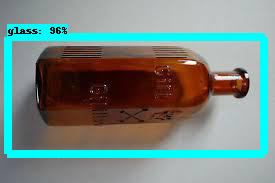

[0.95955944 0.23368564 0.18942834 0.18449143 0.09591377 0.09332707
 0.09317926 0.08372451 0.07560942 0.07422534 0.07274597 0.06981457
 0.06920287 0.06577364 0.06042557 0.0570587  0.05599274 0.05583657
 0.05281862 0.05260896 0.05155928 0.05137058 0.04938751 0.04888027
 0.04822553 0.04734692 0.04716733 0.04652013 0.04618032 0.04393992
 0.04040926 0.04028717 0.03998379 0.03977716 0.03958185 0.03940834
 0.03938717 0.03913276 0.03862989 0.03850692 0.03681051 0.03634217
 0.03629192 0.03566379 0.03527073 0.03507242 0.03498486 0.03492591
 0.0344868  0.03419713 0.03407006 0.03353641 0.03294097 0.03274108
 0.03245784 0.03241378 0.03211777 0.03210818 0.03196573 0.03179886
 0.03168304 0.03144545 0.03141673 0.03121352 0.03118951 0.03104714
 0.03087951 0.03087628 0.03071348 0.03063201 0.03057389 0.03027617
 0.03026545 0.03014768 0.02992883 0.02976754 0.02959011 0.02955957
 0.02907891 0.02897744 0.0287761  0.02870626 0.02854786 0.02850831
 0.02827647 0.02806794 0.02787747 0.0277392  0.02762359 0.0274

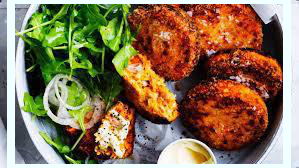

[0.91001725 0.16767691 0.14341918 0.10262548 0.09912109 0.09704835
 0.09444202 0.09233901 0.08899978 0.08895137 0.08881655 0.0879313
 0.08015128 0.07745919 0.07673144 0.07124273 0.07105831 0.07061889
 0.06776625 0.06457034 0.06393737 0.06019619 0.0600439  0.05991028
 0.05769701 0.05743144 0.05635366 0.0551123  0.05501251 0.0543763
 0.05368571 0.05328408 0.05322288 0.05236799 0.0519298  0.05163133
 0.05137954 0.05071271 0.04972355 0.04880932 0.04841793 0.04789425
 0.04747565 0.04672261 0.04626128 0.04550119 0.04298888 0.0422892
 0.03978602 0.03930856 0.03902423 0.03872323 0.03834314 0.03753465
 0.03729839 0.03688716 0.03668251 0.03645462 0.03532548 0.03499802
 0.03482499 0.03430996 0.03389269 0.03362983 0.03340746 0.0323943
 0.0320002  0.03179242 0.03174621 0.03147643 0.03147539 0.03134245
 0.03121175 0.03082093 0.03044988 0.03043533 0.03034984 0.02996227
 0.02965985 0.02964222 0.02948772 0.029414   0.02918123 0.02917673
 0.02911861 0.02908387 0.02908048 0.02889826 0.02886847 0.02874562

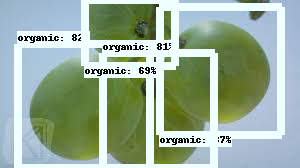

[0.8746065  0.81860906 0.8059347  0.6917986  0.27097023 0.15822847
 0.14128187 0.11916187 0.11805791 0.11755348 0.11223756 0.11176723
 0.10669882 0.10665333 0.10109024 0.10051353 0.09881706 0.08629866
 0.08311273 0.08196441 0.0817662  0.08169985 0.0806189  0.08047376
 0.08008389 0.07900298 0.07896328 0.07263321 0.07190704 0.07060695
 0.06981747 0.06799313 0.06741096 0.06701764 0.06685299 0.06518415
 0.06498098 0.06407642 0.06285801 0.0622612  0.06219715 0.06205996
 0.06060222 0.05940298 0.05848669 0.0583446  0.05728865 0.05718062
 0.05676958 0.05676617 0.05635167 0.05608669 0.05520098 0.0546243
 0.0538812  0.05381389 0.05364718 0.05351645 0.0534943  0.05339547
 0.05323121 0.05231089 0.05184115 0.05031878 0.05030864 0.04902442
 0.04847794 0.04831745 0.04757142 0.04696676 0.04670454 0.04641184
 0.04617802 0.04600149 0.04594931 0.04579854 0.04569719 0.04563503
 0.04535082 0.04534645 0.04533622 0.04514104 0.04505154 0.0449939
 0.04453137 0.04444257 0.04426408 0.04422643 0.04406649 0.043808

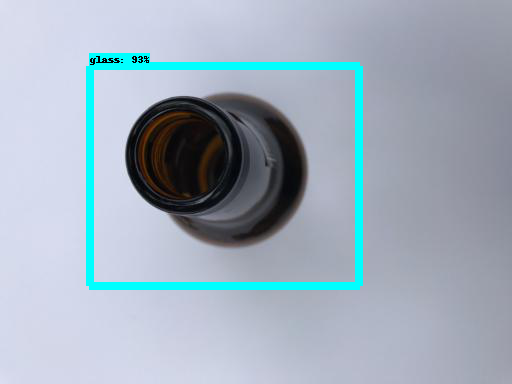

[0.9286476  0.17587526 0.13813162 0.12252588 0.1145727  0.10700706
 0.07945464 0.07766198 0.07697491 0.07650249 0.073013   0.06694693
 0.06578968 0.06519885 0.06344253 0.06302048 0.06075751 0.05872337
 0.05847187 0.05770369 0.05688577 0.05620689 0.05567459 0.05456036
 0.05346186 0.05292862 0.05253397 0.05187241 0.05160408 0.05110321
 0.05058991 0.0502373  0.05015595 0.05010524 0.04934349 0.04906156
 0.04857973 0.04781705 0.04656418 0.04616712 0.04616117 0.04597635
 0.04589659 0.04522455 0.04484591 0.04449635 0.04371412 0.04349764
 0.04334122 0.04301478 0.04240955 0.04227264 0.04171155 0.04132846
 0.04124042 0.04114025 0.04051306 0.04035816 0.0396176  0.03944207
 0.03934959 0.03924989 0.03882664 0.03858837 0.03839187 0.03811716
 0.03799054 0.03798582 0.03760852 0.03759772 0.03755899 0.0374466
 0.03732312 0.03712932 0.03687266 0.03680583 0.03671376 0.03648461
 0.03611775 0.03586236 0.03581782 0.03546608 0.03520898 0.03506649
 0.03501248 0.03499219 0.03486471 0.03433505 0.03412146 0.03408

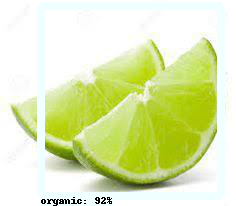

[0.91562074 0.29715526 0.2508618  0.14672916 0.1258006  0.12417272
 0.12160691 0.12020271 0.11906271 0.10943776 0.1092198  0.10324275
 0.09175081 0.0907461  0.08923171 0.0884969  0.08633499 0.08514557
 0.08462659 0.08429936 0.08307745 0.08265708 0.08192888 0.0815661
 0.08115853 0.07556885 0.07510882 0.07321761 0.072992   0.07297599
 0.0722845  0.07123785 0.06949849 0.06892193 0.06780562 0.06757751
 0.06668406 0.06547754 0.06356391 0.06331698 0.06326404 0.06239935
 0.0621364  0.06192155 0.05845919 0.05597075 0.05564691 0.05542091
 0.05463675 0.05399917 0.05361386 0.05304661 0.0530445  0.05199458
 0.04990421 0.0498862  0.04886763 0.0488348  0.04833286 0.04820065
 0.04813785 0.04754902 0.0472189  0.0470574  0.046939   0.04655106
 0.04621958 0.04615475 0.04603325 0.04588364 0.04579023 0.04527265
 0.04445083 0.04441332 0.04428279 0.04407592 0.04404656 0.04373552
 0.04361784 0.04324825 0.04298184 0.04273951 0.04270587 0.04229446
 0.04211305 0.04201767 0.04200016 0.04196407 0.04171183 0.04160

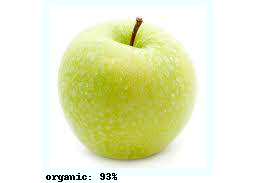

[0.9332443  0.24752972 0.23446415 0.22211042 0.16888145 0.11100218
 0.10826737 0.10676597 0.09706931 0.09550297 0.09444345 0.09313486
 0.09242522 0.09127814 0.08122724 0.08002795 0.07885596 0.07779646
 0.07727159 0.07646506 0.07493863 0.07052072 0.07013023 0.07011598
 0.06690738 0.06630798 0.06551349 0.06550719 0.0636424  0.06324772
 0.06148021 0.06139462 0.05811182 0.05805322 0.05776139 0.05735486
 0.05727962 0.05643342 0.05620462 0.05594378 0.05522403 0.05487491
 0.05460273 0.0537815  0.05328683 0.05281306 0.05251196 0.05201127
 0.05193116 0.05143392 0.05124266 0.05106137 0.05077266 0.05036734
 0.05001608 0.04964563 0.04958901 0.04904988 0.04896826 0.04819782
 0.04783721 0.04748847 0.04672088 0.04610261 0.04567769 0.04543751
 0.04503294 0.04499816 0.04494685 0.04479814 0.0447557  0.04473383
 0.0441427  0.04384109 0.0437438  0.04362319 0.04329543 0.04298289
 0.04216476 0.0416703  0.04152438 0.0413241  0.04117843 0.04075196
 0.04070294 0.0404477  0.04040715 0.04030833 0.04019807 0.0400

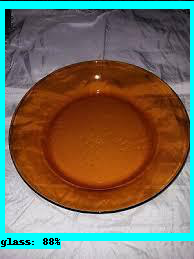

[0.88064337 0.22678842 0.15383156 0.14948961 0.14120236 0.13392967
 0.13148431 0.12949269 0.09695225 0.09591433 0.09505016 0.0939571
 0.09353679 0.09110209 0.08932529 0.08651876 0.08605784 0.08566318
 0.08559045 0.08098581 0.08084927 0.07966946 0.07438364 0.07168753
 0.07150631 0.07138481 0.07095196 0.07035869 0.06977951 0.06729042
 0.06628221 0.06455263 0.06329028 0.06312444 0.06270812 0.06235657
 0.0613675  0.06084208 0.05857031 0.05756852 0.05586656 0.05402346
 0.05394236 0.05388673 0.053742   0.0534727  0.0531776  0.05280895
 0.052462   0.05176893 0.05128715 0.05127125 0.05044552 0.05036434
 0.05001533 0.04937003 0.04933525 0.04883392 0.04830835 0.04786294
 0.04723351 0.04701383 0.04669987 0.04668689 0.04642727 0.04611876
 0.04608421 0.04517031 0.04487419 0.04461942 0.04430167 0.04411027
 0.04400523 0.04399805 0.04393168 0.04338494 0.04312032 0.04305275
 0.04294947 0.04248344 0.04247116 0.04240103 0.04229904 0.04226057
 0.04221709 0.04220143 0.04198582 0.04079978 0.04065251 0.04034

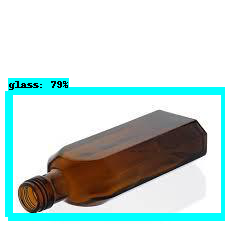

[0.7879514  0.46356544 0.13651268 0.12160113 0.11540959 0.11457076
 0.11341987 0.10961793 0.10744484 0.09531987 0.09376403 0.0899925
 0.08930526 0.08750999 0.08730724 0.08681533 0.08492129 0.07717334
 0.07705651 0.07388578 0.07347782 0.07337052 0.07224294 0.07096463
 0.07030319 0.06996843 0.0693568  0.06923199 0.0690079  0.06888557
 0.06842101 0.06805842 0.06796169 0.06780932 0.06683929 0.06674637
 0.06567325 0.06556742 0.06492828 0.06380548 0.06313305 0.06195707
 0.06128577 0.06098023 0.06033087 0.06029012 0.05837825 0.0581914
 0.05799842 0.05758739 0.05699592 0.05685538 0.05647405 0.05621104
 0.05575968 0.05563733 0.05558041 0.05550838 0.05529339 0.0549766
 0.05450455 0.05410323 0.05381876 0.05344488 0.05323592 0.05275252
 0.05250291 0.05242598 0.0519622  0.05174502 0.05169791 0.05159841
 0.05137964 0.05060595 0.05036701 0.05028302 0.04992197 0.04954585
 0.04922665 0.04905259 0.04846567 0.04831306 0.04780778 0.04708539
 0.04703779 0.04674295 0.0465895  0.04654349 0.04567605 0.0450099

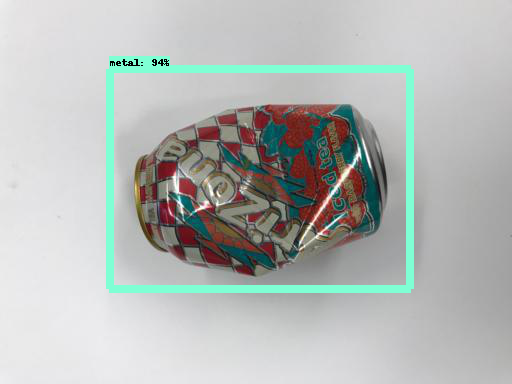

[0.9380771  0.21235465 0.1269297  0.11913571 0.11574169 0.1009343
 0.09005256 0.08806159 0.07201533 0.07160169 0.06915897 0.0683751
 0.06662443 0.06560207 0.06323642 0.06271357 0.06107362 0.06089686
 0.06062692 0.0606247  0.05858736 0.05846275 0.05819312 0.05805955
 0.05739791 0.05694779 0.0555214  0.0554028  0.05532284 0.05385264
 0.05377297 0.05358574 0.05333196 0.05314854 0.05310552 0.05244802
 0.05189218 0.05100565 0.05037099 0.05013834 0.05001595 0.04923999
 0.04917851 0.04818893 0.04762498 0.04728687 0.0466102  0.04627718
 0.04601288 0.04559159 0.04544308 0.04541046 0.04527574 0.0450934
 0.04483201 0.04433577 0.04359792 0.04353993 0.0429501  0.04264887
 0.04257956 0.04242705 0.04193918 0.04182182 0.04157392 0.04155455
 0.04152499 0.04140776 0.0413125  0.0412335  0.04097239 0.04077908
 0.04075209 0.0405924  0.04037307 0.04033663 0.04018424 0.04007102
 0.0400176  0.03978675 0.03961303 0.0394628  0.03944804 0.03910665
 0.03902171 0.03890865 0.0387105  0.03843758 0.03818291 0.0381084

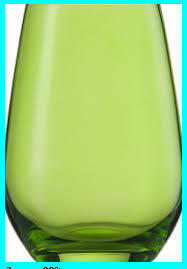

[0.9347409  0.12201157 0.11242755 0.1097724  0.10740186 0.10404698
 0.09146219 0.08953117 0.08709415 0.08638878 0.08228613 0.08091864
 0.08059731 0.0803725  0.07995645 0.07834084 0.07657755 0.07554685
 0.0753805  0.07530018 0.07463135 0.07347827 0.07345901 0.07156575
 0.07109618 0.07021371 0.06933638 0.06931303 0.06855484 0.06759367
 0.06635242 0.06593686 0.06244557 0.06121366 0.05960732 0.05711721
 0.05692118 0.05565791 0.05424384 0.05396214 0.05350817 0.05308096
 0.05247496 0.05209596 0.05145612 0.05113436 0.05105945 0.05037307
 0.05009117 0.0486295  0.04861908 0.048494   0.04810812 0.04762573
 0.0471704  0.04715638 0.04715276 0.04698021 0.04692785 0.04683439
 0.04618008 0.04587788 0.04578029 0.0457046  0.04508821 0.0447832
 0.04466717 0.0446254  0.0444236  0.04381655 0.04381582 0.0434536
 0.04322912 0.04305696 0.04295786 0.04271615 0.04251059 0.04229136
 0.04175871 0.04135289 0.04095322 0.04076277 0.04054387 0.03955384
 0.03921023 0.0388869  0.03882413 0.03831447 0.03825902 0.037914

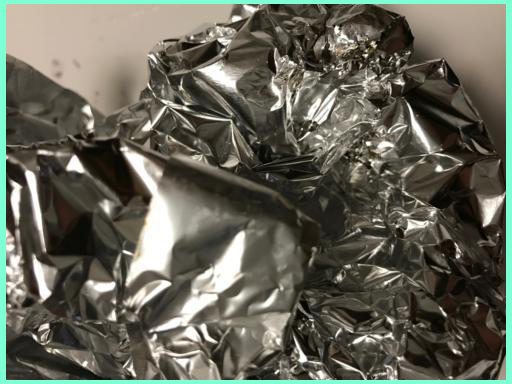

[0.9416773  0.09428801 0.09107108 0.07994699 0.07689001 0.07585917
 0.07318313 0.07310673 0.06683748 0.06460512 0.063501   0.05120227
 0.04738927 0.04473167 0.0435583  0.0397959  0.03661064 0.03603382
 0.03595181 0.0356549  0.03528227 0.03516303 0.03506649 0.03492674
 0.03435931 0.03313882 0.03293166 0.03246208 0.03231189 0.03223131
 0.03181848 0.0314221  0.0308311  0.03081024 0.03054656 0.03034758
 0.03001318 0.02989838 0.02982067 0.02980958 0.02899086 0.02879773
 0.0286181  0.02857421 0.02818418 0.02796665 0.02737304 0.02731387
 0.02730377 0.027284   0.02707517 0.02682897 0.02622958 0.02584135
 0.02584019 0.02544284 0.02533967 0.02480656 0.02474065 0.02468661
 0.02465282 0.02464808 0.02464663 0.02462284 0.02443834 0.02441796
 0.02410171 0.02394328 0.02391231 0.02388711 0.02370464 0.02367329
 0.0235842  0.02322524 0.02321972 0.02321072 0.02320263 0.02292061
 0.02286471 0.0227461  0.02257236 0.02253853 0.02232856 0.02216795
 0.02213038 0.02209296 0.02185042 0.02184409 0.02161942 0.0216

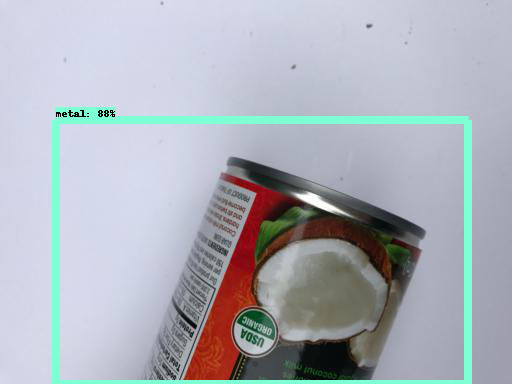

[0.88204    0.09814434 0.0956668  0.08537416 0.08300222 0.0828382
 0.08037464 0.07763453 0.07650582 0.07330465 0.06856088 0.0669485
 0.06221779 0.06155041 0.05905719 0.05796158 0.05563278 0.05524056
 0.05451875 0.05439546 0.05239719 0.05220883 0.051941   0.05167284
 0.05110064 0.05039814 0.05004749 0.0495935  0.04711795 0.04686382
 0.04631287 0.04630397 0.04575948 0.04449333 0.04367518 0.0420022
 0.04184741 0.04154429 0.04137275 0.04090985 0.04041384 0.03937176
 0.03869779 0.03843131 0.03832419 0.03731615 0.03640514 0.0361466
 0.03603033 0.03557476 0.03540109 0.03497458 0.03474151 0.03470546
 0.03416061 0.03405207 0.03385879 0.03382098 0.03366536 0.03364354
 0.03350672 0.03344362 0.03331982 0.03331085 0.03309877 0.03306574
 0.03267226 0.03221267 0.03201406 0.03197977 0.03197569 0.03180517
 0.03171027 0.03170121 0.03160288 0.03148169 0.03147238 0.03114441
 0.03112586 0.03095801 0.03084027 0.03079585 0.03076718 0.03050356
 0.0304007  0.03038248 0.0301746  0.02992604 0.02989453 0.02952096

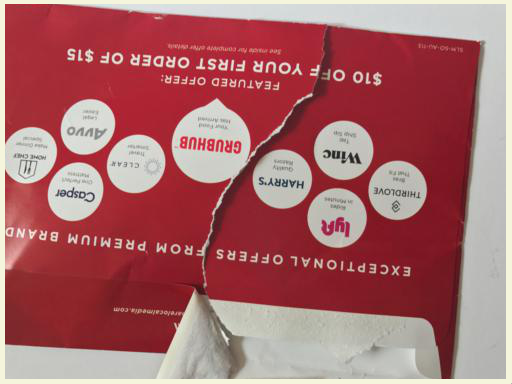

[0.92869496 0.22892466 0.11865609 0.10013292 0.09195157 0.08925323
 0.07975174 0.07876664 0.06622675 0.06462226 0.05493766 0.05124145
 0.04954818 0.04883132 0.04858366 0.04748435 0.04639705 0.04425304
 0.04200457 0.04173574 0.04156348 0.04156111 0.04040748 0.03998248
 0.03909034 0.03876645 0.03763951 0.03665217 0.03536048 0.03519361
 0.0347997  0.03472462 0.034547   0.0345289  0.03410278 0.03409046
 0.03387292 0.03352686 0.0334905  0.03300929 0.03279767 0.03272562
 0.03215323 0.03130515 0.03122832 0.03059269 0.0305642  0.03041588
 0.03033616 0.03014952 0.03007011 0.029894   0.02957574 0.02950206
 0.02949675 0.02948127 0.02937843 0.02885338 0.02884521 0.02849748
 0.02846838 0.02843706 0.02838045 0.02827511 0.0282412  0.02802172
 0.02755687 0.02737785 0.02730934 0.02696081 0.02695523 0.02689159
 0.02687313 0.02668205 0.02639673 0.02622103 0.02621309 0.02588572
 0.0256695  0.02535852 0.02524872 0.02512352 0.02506968 0.02489292
 0.02488665 0.02468213 0.02466269 0.02435357 0.02434618 0.0242

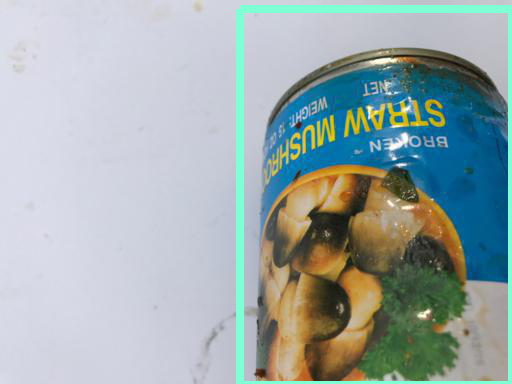

[0.79976606 0.26993704 0.18931022 0.1563473  0.126125   0.12138198
 0.10996345 0.10112732 0.0995486  0.09755401 0.09562029 0.09454351
 0.0943566  0.09283273 0.0860149  0.08570119 0.08185071 0.07683996
 0.07510351 0.07481287 0.07417306 0.07346406 0.07314897 0.0729273
 0.06905107 0.06748345 0.06715944 0.06529891 0.06408476 0.06376231
 0.06262271 0.0622044  0.06215484 0.06204109 0.06118153 0.06042714
 0.05897419 0.05870288 0.05807494 0.05771071 0.05752468 0.05653575
 0.05504614 0.05499354 0.05482093 0.05452607 0.05416273 0.05380629
 0.05380572 0.0537712  0.0535167  0.0528423  0.05249637 0.05210079
 0.05176132 0.05142779 0.05014411 0.05011539 0.05008545 0.04990719
 0.04968117 0.04837092 0.04835659 0.04820645 0.0481883  0.04765436
 0.04723105 0.04646352 0.04539939 0.04530929 0.04504704 0.04487823
 0.04411982 0.04363446 0.04353048 0.04337678 0.04329478 0.04279819
 0.04274908 0.04178628 0.04145789 0.04139411 0.04138809 0.041186
 0.04056966 0.04039075 0.04038858 0.04013731 0.04002169 0.0399993

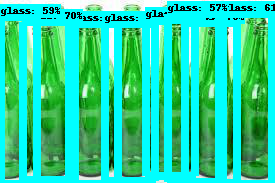

[0.78108484 0.7773699  0.739343   0.72741127 0.7011076  0.60573006
 0.593459   0.5742559  0.45738992 0.28884873 0.2846171  0.25201258
 0.201583   0.2011705  0.20077868 0.19729228 0.18197723 0.1760524
 0.17401801 0.15661196 0.15117095 0.15009698 0.1472297  0.14371596
 0.1428959  0.13573915 0.13076703 0.12897174 0.12573305 0.12274527
 0.12124545 0.11705606 0.11525551 0.11425018 0.11261211 0.11179876
 0.11111803 0.11053724 0.11045954 0.10846185 0.10532953 0.10484972
 0.10447375 0.10093156 0.10025772 0.0992796  0.09892593 0.09873699
 0.09695212 0.0969474  0.0953349  0.09482961 0.09278782 0.09167618
 0.08663656 0.08662401 0.08621466 0.08601352 0.08569007 0.08518562
 0.08074772 0.07907201 0.07834173 0.07801581 0.07788774 0.07746489
 0.0774176  0.07644447 0.073328   0.07171298 0.06867616 0.0667036
 0.06530574 0.06505679 0.06475154 0.06446161 0.06304968 0.0626374
 0.0609828  0.06058892 0.06056446 0.05875421 0.05872785 0.05871144
 0.0585664  0.05821533 0.05809871 0.05803512 0.05750456 0.0572661

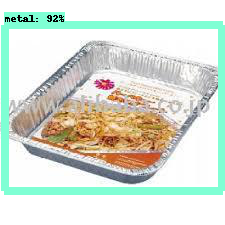

[0.92479813 0.15224484 0.1485757  0.14759924 0.12759916 0.11192885
 0.11024933 0.10967956 0.09595001 0.09552199 0.09078523 0.08934484
 0.08738382 0.08574402 0.08281291 0.07882829 0.07854124 0.07844798
 0.07439073 0.07090128 0.06947556 0.06912333 0.06672873 0.0650259
 0.064259   0.06423531 0.06344964 0.06328829 0.06317928 0.0583438
 0.058104   0.0550616  0.05362122 0.05346764 0.05341488 0.05285029
 0.05278688 0.05257232 0.05203138 0.05198813 0.05191275 0.05190915
 0.05093297 0.05048543 0.05039059 0.05031241 0.05005385 0.05005345
 0.04843784 0.04822573 0.04666592 0.04664426 0.0462762  0.04607844
 0.04549018 0.04538937 0.04508482 0.04377862 0.04368274 0.04318174
 0.04302155 0.04253967 0.04252509 0.04243297 0.04191576 0.04171533
 0.04154615 0.04119368 0.04096598 0.040873   0.04084284 0.0408345
 0.04068023 0.04065495 0.04038624 0.04018626 0.04006069 0.03996006
 0.03963586 0.03956294 0.03929296 0.03902986 0.03883379 0.03874215
 0.03873499 0.03852751 0.03829526 0.03796357 0.03746217 0.0373934

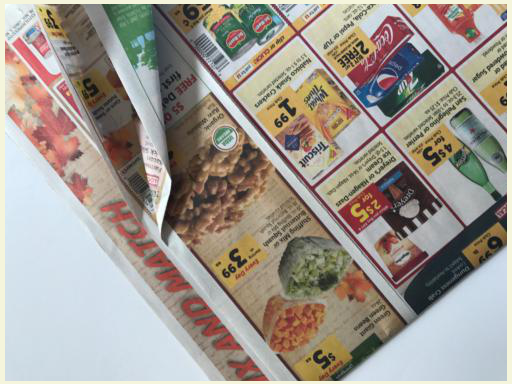

[0.94122946 0.09532907 0.08543995 0.08228334 0.07894722 0.07610401
 0.07242683 0.07158528 0.07005551 0.06919137 0.05643524 0.05527755
 0.05521239 0.05303945 0.0515973  0.04934382 0.04884617 0.04881103
 0.04861833 0.04850835 0.04817608 0.04695312 0.04600619 0.04543535
 0.0442517  0.04423962 0.043492   0.04275217 0.04268744 0.0418249
 0.04137464 0.04111405 0.04011785 0.03966517 0.03870891 0.03819294
 0.0373472  0.03696864 0.03628916 0.0361608  0.03577415 0.03572448
 0.03457385 0.0341855  0.03384801 0.0334696  0.03313418 0.0330019
 0.0329776  0.03278953 0.03261834 0.0325008  0.03245459 0.0317687
 0.03124989 0.03121051 0.03102929 0.0309123  0.03034098 0.02970751
 0.02955237 0.02932909 0.02913199 0.0290961  0.02889119 0.02876702
 0.02871016 0.02840368 0.0282748  0.02826209 0.02822358 0.02816648
 0.02815087 0.02806683 0.02798801 0.02790704 0.02776428 0.02773111
 0.02769276 0.02744428 0.02719387 0.02717279 0.02711054 0.027084
 0.02708002 0.02707168 0.02704686 0.02639177 0.02638405 0.02636412


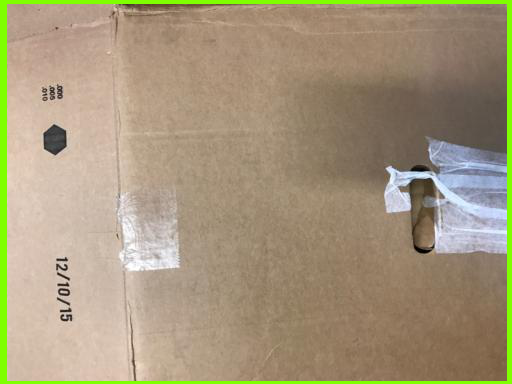

[0.9112737  0.25657675 0.12469281 0.11425174 0.09115062 0.08497071
 0.08407736 0.07819488 0.07583039 0.07326303 0.06545361 0.06509662
 0.06298975 0.06121992 0.06103851 0.06100874 0.05949708 0.05780509
 0.05608295 0.05479319 0.05175864 0.04828455 0.04610802 0.04548725
 0.04375406 0.04332038 0.04293657 0.04151173 0.0414927  0.04080172
 0.04054582 0.03926848 0.03873965 0.03862184 0.0383047  0.03820211
 0.03811233 0.03681109 0.03674743 0.03666067 0.03585732 0.03581889
 0.0351382  0.0349117  0.03430219 0.03381518 0.03373291 0.03365563
 0.0334405  0.03327024 0.03291446 0.03283241 0.03278126 0.03269228
 0.03238347 0.03212918 0.03206765 0.03201991 0.0315855  0.03152493
 0.03140615 0.03131428 0.0312869  0.03123145 0.0306398  0.03060699
 0.03057153 0.03056076 0.0305076  0.03044457 0.03029017 0.02996447
 0.0298989  0.0298554  0.02982476 0.029793   0.02970551 0.02953986
 0.02950345 0.02947585 0.02938459 0.0293345  0.02915526 0.02914039
 0.02904875 0.02898935 0.02855071 0.02847604 0.02838664 0.0283

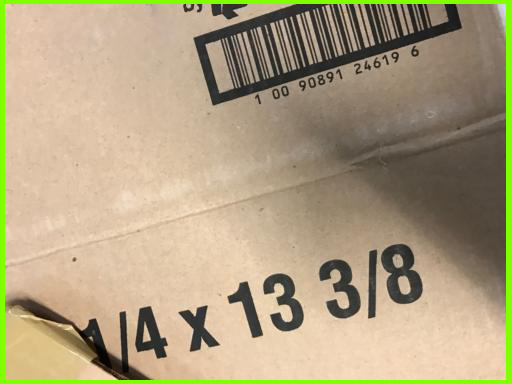

[0.9227741  0.09034572 0.08782352 0.07566342 0.0754249  0.07432684
 0.07401655 0.06967085 0.06693105 0.06230016 0.06149882 0.06038522
 0.05297881 0.04993547 0.04696636 0.04527972 0.0444618  0.04411702
 0.04019765 0.04016368 0.03981779 0.03896413 0.0389156  0.03890096
 0.03694174 0.03631367 0.03485981 0.03452777 0.03423705 0.03418715
 0.03403154 0.03385122 0.03328844 0.03265585 0.0319223  0.03177343
 0.03168452 0.0314832  0.03101517 0.03099113 0.03027138 0.03006185
 0.02972315 0.02895634 0.02857318 0.02850317 0.02848837 0.02825376
 0.0281714  0.02806191 0.02789581 0.02751246 0.02742183 0.02732939
 0.02691819 0.02679041 0.02626029 0.02624437 0.0261933  0.02618394
 0.02580052 0.02555859 0.02543979 0.02538182 0.02533648 0.02525724
 0.02509848 0.02508513 0.02503963 0.0250084  0.02471859 0.02469375
 0.02464641 0.02458785 0.0245413  0.02447703 0.02398198 0.02396071
 0.0237745  0.02367579 0.02361258 0.0236022  0.02347578 0.02343179
 0.02335186 0.02324763 0.02323412 0.02317753 0.02305633 0.0224

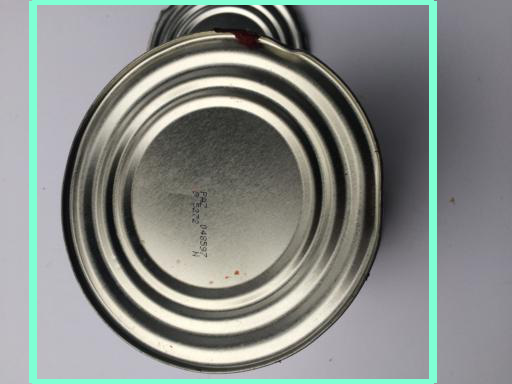

[0.95134777 0.12138136 0.11374031 0.10617898 0.09613006 0.08410321
 0.08392957 0.06452436 0.05203217 0.05189525 0.04641251 0.04582518
 0.04575637 0.0423145  0.04229799 0.04180505 0.04122551 0.03984202
 0.03981565 0.03885875 0.03804537 0.03642911 0.03446357 0.03419763
 0.03364715 0.03353519 0.0333976  0.03339136 0.03311495 0.03303904
 0.03285637 0.03241552 0.03169611 0.03169264 0.03160626 0.03097389
 0.03091556 0.03078865 0.03045292 0.03031744 0.03019492 0.03019489
 0.02887185 0.02861848 0.02857712 0.02829305 0.02812229 0.02786523
 0.02723763 0.02700479 0.02695885 0.02691905 0.0268178  0.02661
 0.02656442 0.02632001 0.02605811 0.02597884 0.02590388 0.02585012
 0.02548908 0.02545977 0.02518004 0.02516797 0.02515841 0.0250883
 0.02500765 0.02497276 0.02488366 0.02487064 0.0247415  0.02469558
 0.02464411 0.02461658 0.02451586 0.02437883 0.02420157 0.024122
 0.02382468 0.0238244  0.02378438 0.0236689  0.02349897 0.02342193
 0.02333889 0.02330518 0.02322721 0.02315286 0.02305455 0.02302703
 

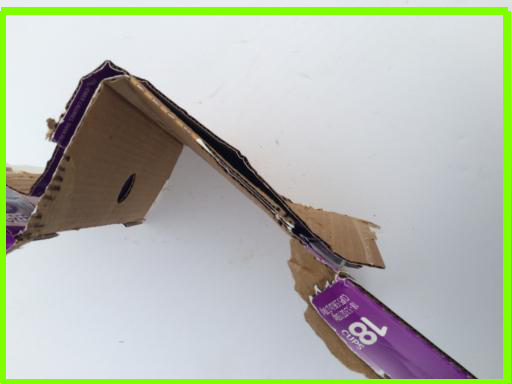

[0.89854944 0.17711303 0.17573808 0.12231421 0.1124004  0.11239409
 0.0919847  0.09076422 0.0887571  0.08765635 0.08627997 0.0844098
 0.08029025 0.07997638 0.07593931 0.07451357 0.07375264 0.07115097
 0.07101671 0.0702984  0.06977685 0.06897623 0.06785425 0.06683733
 0.06577162 0.064777   0.06474994 0.06460906 0.06454974 0.06394189
 0.06214156 0.06192835 0.06138103 0.06119388 0.06072644 0.06021367
 0.05981173 0.05854942 0.05853517 0.05845849 0.0575236  0.05730942
 0.05525009 0.05450706 0.05391987 0.05382875 0.05273424 0.051929
 0.05184098 0.05175741 0.05130528 0.05108572 0.05069813 0.05049119
 0.0503896  0.0489534  0.04864087 0.04750403 0.04721203 0.04695632
 0.04617902 0.04605122 0.04587172 0.04543054 0.04479432 0.04438553
 0.04358935 0.04350859 0.04294622 0.04294514 0.04244108 0.04216831
 0.04130467 0.04124206 0.04107285 0.04078427 0.04031818 0.03954028
 0.03912457 0.03868303 0.0385867  0.0381921  0.03801598 0.03801539
 0.0379395  0.03773867 0.03766411 0.03761246 0.037561   0.0374196

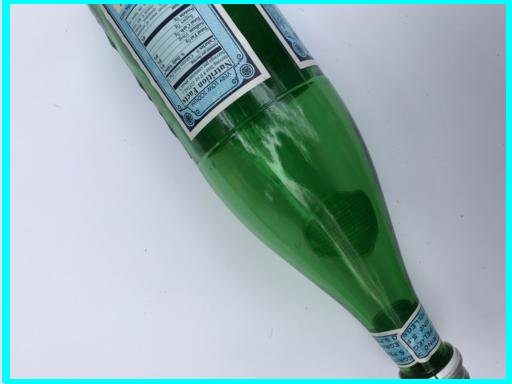

[0.9240736  0.1546322  0.12169171 0.10794483 0.10610951 0.09367882
 0.08625155 0.0798887  0.07862189 0.07716189 0.076258   0.07146954
 0.07046486 0.06540392 0.06485724 0.06375249 0.06072043 0.05959576
 0.05592128 0.05535639 0.05507692 0.05380122 0.05251164 0.05243306
 0.05181191 0.0514595  0.0507357  0.05042781 0.04960662 0.04760231
 0.04726987 0.04708928 0.04558807 0.04461146 0.04381394 0.04327474
 0.04176231 0.03791241 0.03751433 0.03732751 0.03729287 0.03717972
 0.03713527 0.03696355 0.03692944 0.03631342 0.0362376  0.03587633
 0.03488421 0.03457863 0.03447859 0.03446309 0.03408008 0.0340055
 0.03370375 0.03363383 0.03336077 0.03334393 0.03318783 0.03284717
 0.03262443 0.03257877 0.03257193 0.0324647  0.03227559 0.03223333
 0.0315869  0.03132354 0.03123239 0.03113498 0.03098835 0.03064656
 0.03058183 0.03054986 0.03044004 0.03020236 0.03005803 0.02992692
 0.02966305 0.02965135 0.02938066 0.02922701 0.02916234 0.02913296
 0.02912677 0.0288861  0.02885204 0.02877167 0.02870874 0.02866

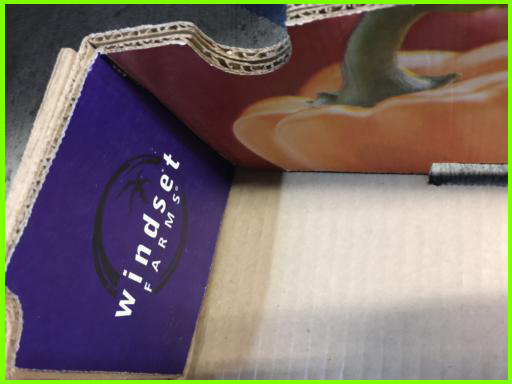

[0.9210002  0.21773684 0.13742624 0.13028996 0.0912546  0.07545051
 0.075104   0.06768884 0.06589382 0.06157059 0.05971788 0.05409194
 0.05347557 0.05253987 0.05215803 0.05141195 0.0505407  0.04880454
 0.04827414 0.04775043 0.04607639 0.04450173 0.04227482 0.0411745
 0.04073443 0.03998848 0.03965316 0.03957793 0.0391001  0.03851172
 0.03771639 0.0372483  0.03641191 0.03633934 0.03566638 0.03554659
 0.03534762 0.03511131 0.0347546  0.03428125 0.03407269 0.03380018
 0.03368881 0.03354863 0.03347547 0.03314365 0.0330409  0.0329817
 0.03285268 0.03213626 0.03209198 0.03184995 0.03175954 0.03122201
 0.03118793 0.03114646 0.03101602 0.0308472  0.03062364 0.03045872
 0.03034887 0.02979632 0.02958444 0.02948826 0.02935709 0.02925457
 0.02914218 0.02893343 0.02877109 0.02864106 0.02853131 0.02831128
 0.02830197 0.02798478 0.02797363 0.02792592 0.0278453  0.02773334
 0.02763092 0.02759455 0.02746214 0.02745212 0.02742312 0.02740731
 0.02737038 0.02736102 0.02730972 0.02726239 0.02724727 0.027039

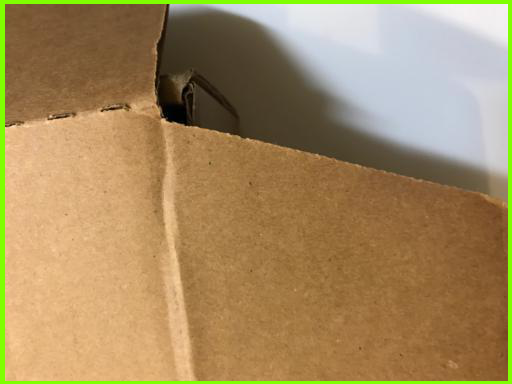

[0.9214901  0.08311573 0.07508952 0.07491669 0.07464591 0.07264122
 0.06966851 0.06732546 0.0668244  0.06643093 0.06374976 0.06359428
 0.06142962 0.05690248 0.05589867 0.05321103 0.05170714 0.04849497
 0.03981123 0.03921963 0.03889837 0.03886785 0.03882097 0.03684431
 0.03631058 0.03478481 0.0347169  0.0340162  0.03397081 0.03315348
 0.03297156 0.03275931 0.03237334 0.03231983 0.03228186 0.03199585
 0.03161421 0.03111814 0.03082538 0.02966356 0.02963695 0.02927815
 0.02910842 0.02910443 0.02905566 0.02886268 0.02845323 0.0283146
 0.02812528 0.02800343 0.02795329 0.02780583 0.02751701 0.02713469
 0.02708323 0.02702962 0.02694852 0.0267888  0.02633617 0.02589699
 0.02572696 0.02568271 0.02564288 0.02559065 0.02550456 0.0252317
 0.02522044 0.02515272 0.02499642 0.02469457 0.024485   0.02435325
 0.02409206 0.02400137 0.02373354 0.02372569 0.02367213 0.02361043
 0.0235629  0.02337502 0.02336389 0.02271226 0.02261246 0.02238238
 0.02229213 0.0222907  0.02215398 0.02211349 0.02188374 0.021799

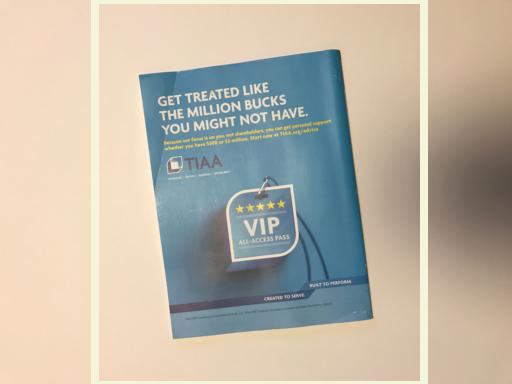

[0.89840937 0.3172111  0.25855002 0.21619426 0.20736238 0.15400647
 0.14067475 0.10399114 0.08917765 0.08226766 0.08223933 0.07958377
 0.07769518 0.07732889 0.0772165  0.07498501 0.07174268 0.07148276
 0.07078823 0.07054792 0.07016609 0.06905694 0.06838301 0.06738724
 0.06730501 0.06428534 0.06420816 0.06314233 0.06288363 0.06172556
 0.06094129 0.06043252 0.06015969 0.05914806 0.05896712 0.05881371
 0.0576161  0.05728335 0.05719775 0.05600139 0.05599315 0.05597638
 0.05515248 0.05399643 0.05317936 0.05195927 0.05183757 0.05132281
 0.05100736 0.05024203 0.05023074 0.0501922  0.04988061 0.04845139
 0.04775234 0.04764753 0.04712926 0.04662492 0.04656895 0.04581679
 0.0457229  0.04555074 0.04521425 0.04470944 0.04343427 0.04248002
 0.04230299 0.04214151 0.04187334 0.0418295  0.04177783 0.04165361
 0.0416281  0.04128825 0.04105242 0.04088356 0.04051137 0.04031918
 0.04010279 0.03981538 0.03972959 0.03959152 0.03957342 0.03957068
 0.03950349 0.03925314 0.03922208 0.03921081 0.03919472 0.0387

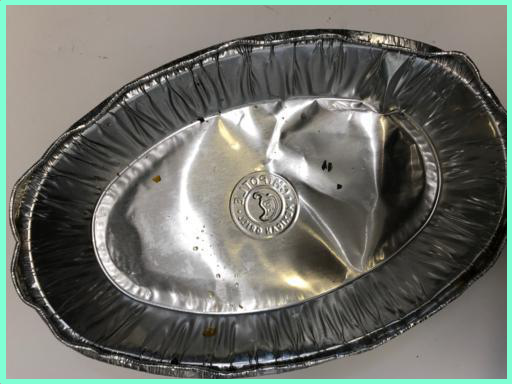

[0.946544   0.08850362 0.08055232 0.07807526 0.07330304 0.06303493
 0.05991177 0.05930825 0.05424267 0.04581448 0.04479193 0.04401677
 0.04256572 0.0408796  0.04049544 0.04017058 0.03600314 0.03571056
 0.03478943 0.0340565  0.03399445 0.03307448 0.03284747 0.03210466
 0.03096737 0.03086886 0.03071267 0.03061701 0.03050463 0.03025354
 0.02983867 0.02948865 0.02902369 0.02879021 0.02875227 0.02827653
 0.02807478 0.02787152 0.02784106 0.02776195 0.02755825 0.02755482
 0.02722356 0.02676171 0.02667864 0.02654786 0.02621147 0.02615498
 0.02598756 0.02595496 0.02505883 0.02500355 0.02484065 0.02471161
 0.02465306 0.02448807 0.02448333 0.02411451 0.02399012 0.02392272
 0.02386176 0.02350155 0.02345508 0.02339214 0.02322285 0.02298098
 0.0228606  0.02271425 0.02263302 0.02248814 0.0224123  0.02208755
 0.02199087 0.02197332 0.02162586 0.02149253 0.0210542  0.02093601
 0.02092943 0.02067041 0.0204531  0.020255   0.02003098 0.02002933
 0.01992549 0.01986209 0.01978198 0.0196665  0.01953261 0.0193

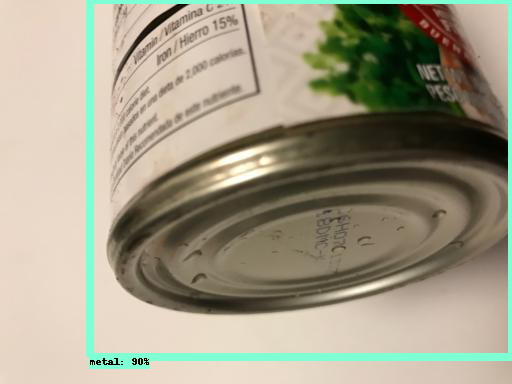

[0.89857304 0.18554798 0.15148824 0.12383971 0.12245465 0.11806782
 0.08893535 0.08844274 0.08167302 0.08033851 0.07994109 0.07695257
 0.0762568  0.07343239 0.07123422 0.0711249  0.06693312 0.06627785
 0.06491147 0.06346212 0.06297686 0.06082693 0.06036071 0.05612484
 0.05595697 0.05569728 0.05537196 0.05520539 0.05460522 0.05442112
 0.05372227 0.05277906 0.05113599 0.05083727 0.05081721 0.05057305
 0.04950101 0.04916742 0.0481627  0.04589202 0.04576652 0.04507665
 0.04480713 0.04454945 0.0440538  0.04364536 0.04361172 0.04288615
 0.04277183 0.0426973  0.04234726 0.04233787 0.04190142 0.04187863
 0.04142982 0.04134497 0.04108169 0.03998702 0.03974063 0.03953988
 0.0391065  0.03879078 0.03842448 0.03817407 0.03768626 0.03754448
 0.03744049 0.03732219 0.03722677 0.03696477 0.03631028 0.03624088
 0.03592611 0.03589787 0.03589508 0.03582278 0.03564533 0.03549507
 0.03501859 0.03479986 0.03469385 0.03465344 0.03446159 0.0344307
 0.03424972 0.03416435 0.03415274 0.03400347 0.03392014 0.03360

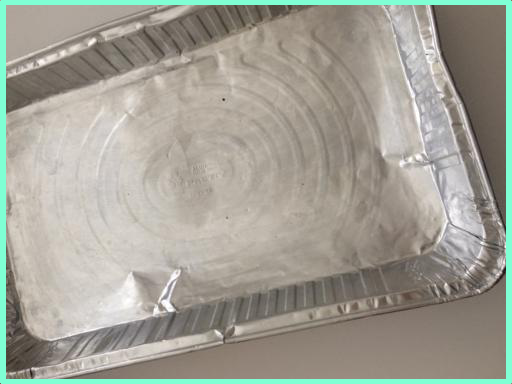

[0.9410069  0.08862806 0.08237517 0.08057051 0.07994004 0.07465482
 0.07239284 0.07146162 0.05923026 0.05849168 0.05773546 0.0543819
 0.04923999 0.04781801 0.04591339 0.04434856 0.04248244 0.04237177
 0.0394145  0.03923424 0.03840616 0.03647429 0.03568043 0.03566836
 0.03526003 0.03400659 0.03313485 0.03252116 0.03098378 0.0308434
 0.03052835 0.03023916 0.02972467 0.02969346 0.02891802 0.02878927
 0.02871155 0.02868609 0.02815146 0.02785886 0.02757381 0.027531
 0.02657929 0.02647725 0.02623374 0.02566696 0.02557341 0.02555826
 0.0253188  0.02500663 0.02473542 0.02456588 0.02432707 0.02422152
 0.02408154 0.02394838 0.02381271 0.02377514 0.02377206 0.02372179
 0.02368359 0.02346952 0.02318416 0.0229696  0.02268283 0.022545
 0.02234104 0.02224523 0.02194962 0.0218663  0.02183361 0.02177506
 0.021383   0.02135921 0.0211189  0.02089811 0.02065594 0.02051608
 0.02032427 0.0203034  0.02028102 0.02017921 0.02016605 0.02015241
 0.02011782 0.02006079 0.019841   0.01942314 0.01939938 0.01937328
 

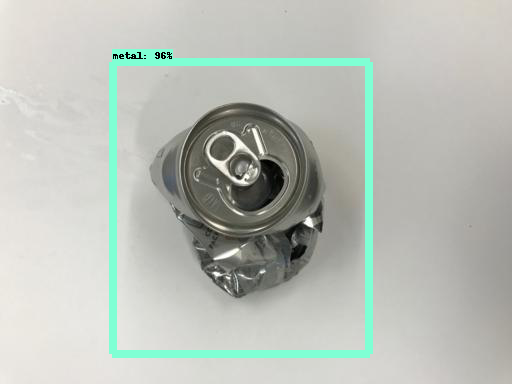

[0.9580931  0.18676358 0.15218943 0.13753615 0.13614248 0.11238164
 0.09414673 0.09129769 0.08842674 0.0877821  0.08387502 0.07835758
 0.07722647 0.07327875 0.0700665  0.06814558 0.06767148 0.06462189
 0.06415109 0.06286566 0.06107936 0.06060393 0.06042228 0.06031355
 0.06029186 0.05957963 0.05718656 0.05708864 0.05680181 0.05561918
 0.05477823 0.05310817 0.05298924 0.05288554 0.05200448 0.051861
 0.05099609 0.05049699 0.05038068 0.04988305 0.04967567 0.04889017
 0.04773326 0.04758916 0.04752117 0.04647782 0.04647717 0.04627528
 0.04468097 0.04459275 0.04434618 0.04413115 0.04386976 0.04353911
 0.0431779  0.04298896 0.04271457 0.0424978  0.04248381 0.04243666
 0.04189379 0.04177455 0.04149083 0.04102259 0.04082834 0.04052103
 0.03992909 0.03952314 0.03922436 0.03858605 0.03851983 0.03833364
 0.03824922 0.03805901 0.0379158  0.03790703 0.03756627 0.03750399
 0.03744957 0.0374181  0.03739333 0.03725248 0.03714297 0.03701384
 0.03688807 0.03686386 0.03677712 0.03658722 0.03654797 0.036348

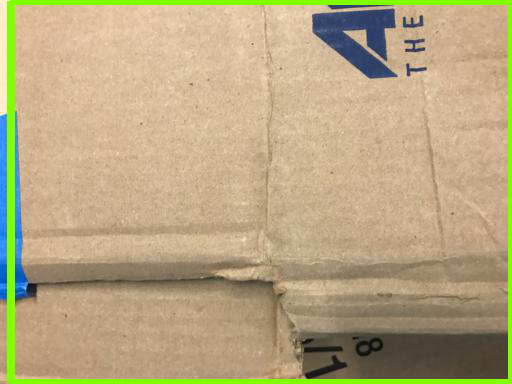

[0.9242517  0.32251984 0.29952446 0.25858334 0.24229753 0.21064387
 0.1907036  0.16283672 0.1587006  0.15460692 0.13795483 0.1313679
 0.12888339 0.12602018 0.11763373 0.1083531  0.10825253 0.10008719
 0.09492842 0.09151266 0.09021984 0.08670771 0.0861703  0.08548789
 0.08239381 0.07830159 0.07712414 0.07566892 0.07541229 0.07522929
 0.07521672 0.07434148 0.0743183  0.07342964 0.07279654 0.07257509
 0.0698135  0.06518392 0.06490293 0.06431986 0.06347485 0.06251886
 0.0611768  0.06013222 0.05978594 0.05923459 0.05863116 0.05858961
 0.05684127 0.05656137 0.05611542 0.05585847 0.05525168 0.05467368
 0.05442548 0.05400376 0.05269423 0.05223726 0.05223107 0.05209426
 0.05190393 0.05109553 0.05065634 0.0499416  0.04923991 0.04923765
 0.04819728 0.04764199 0.04763122 0.04728951 0.04668887 0.0459591
 0.04554923 0.04438308 0.04405661 0.04379924 0.04368481 0.04348347
 0.04340235 0.0427578  0.04271781 0.04231188 0.04221959 0.04175674
 0.04156367 0.04153114 0.04134611 0.04134065 0.04106557 0.040928

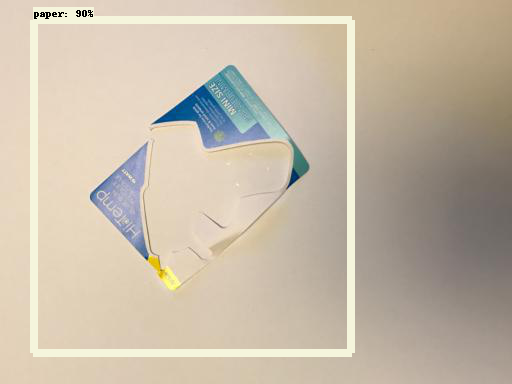

[0.89554906 0.14990865 0.13468343 0.1345364  0.12029584 0.11684399
 0.11461169 0.10616366 0.10284773 0.10000785 0.09156324 0.08745064
 0.08098646 0.0774821  0.07698739 0.07697979 0.0757156  0.07548366
 0.07247116 0.07025457 0.06972571 0.06885468 0.06628988 0.06563039
 0.06538997 0.06510473 0.0640728  0.06076423 0.06051314 0.06036945
 0.05989079 0.05914689 0.05739481 0.05639892 0.0560262  0.05568251
 0.05482308 0.05436626 0.05431068 0.05263091 0.05196274 0.05155724
 0.05143805 0.05103834 0.05094703 0.04932985 0.0472534  0.04718712
 0.04685978 0.04655867 0.04632736 0.04607457 0.04590775 0.04588661
 0.04552632 0.04548412 0.04541989 0.04541104 0.04510331 0.0446339
 0.0444951  0.04417343 0.04399883 0.04399693 0.04389649 0.04364869
 0.04326384 0.04275569 0.04253471 0.04218166 0.04206013 0.04186443
 0.04175273 0.04166636 0.04158065 0.04136313 0.04092892 0.04038359
 0.04001888 0.03994766 0.03982921 0.03982195 0.03973192 0.03963708
 0.03874103 0.03873228 0.03850489 0.03825539 0.03824897 0.03792

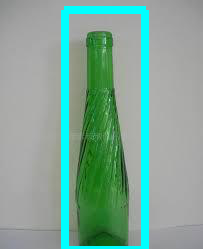

[0.92345244 0.20880345 0.19572258 0.17723842 0.17654216 0.1740074
 0.14857186 0.13725719 0.1277128  0.12527028 0.10828561 0.10725953
 0.10318476 0.10258725 0.10079352 0.09919105 0.09914414 0.0981547
 0.09766071 0.09748136 0.09667759 0.09596184 0.09577883 0.0950257
 0.09260365 0.0918054  0.09068704 0.090183   0.08914643 0.08856989
 0.08667652 0.08507819 0.08416476 0.08379201 0.08372144 0.08017401
 0.07863979 0.07773878 0.07646792 0.07607791 0.07578551 0.07558141
 0.07519037 0.07477721 0.07439224 0.07336617 0.07316653 0.07296331
 0.0719261  0.07188002 0.07168656 0.07080252 0.07048364 0.07047093
 0.06878363 0.06734015 0.06671431 0.06630822 0.06593064 0.06544162
 0.06347612 0.06300434 0.06224717 0.06204405 0.06059936 0.06038473
 0.05995066 0.05950234 0.05930887 0.05913354 0.05905939 0.05849629
 0.05781574 0.0564853  0.05646899 0.05619864 0.05601958 0.05530355
 0.05523026 0.05436788 0.05396012 0.05358402 0.05352152 0.05286266
 0.05262808 0.05235967 0.05198268 0.05188224 0.05162886 0.0513815

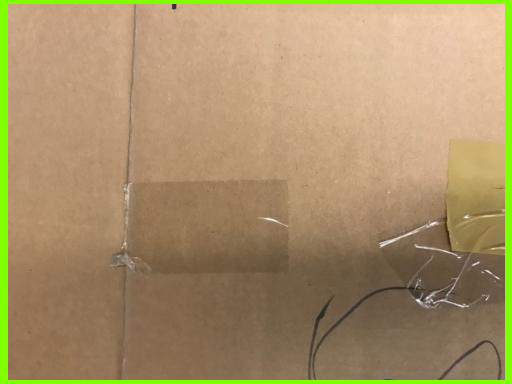

[0.91101116 0.25349486 0.17485929 0.125876   0.11905721 0.10510276
 0.0961343  0.0929753  0.08819395 0.08630471 0.07952184 0.07211184
 0.07174008 0.066595   0.06399179 0.06195595 0.061781   0.06030178
 0.05956995 0.0593478  0.05825561 0.05814176 0.05798425 0.05786583
 0.05584746 0.05333763 0.05040092 0.05034001 0.04921437 0.04913064
 0.04817544 0.04786464 0.04657625 0.04454493 0.04447752 0.04443339
 0.04403244 0.04401385 0.04352321 0.04323444 0.04283237 0.04265996
 0.04209186 0.04139474 0.04124285 0.04107129 0.04027989 0.03899846
 0.03885787 0.03833241 0.03804888 0.0373239  0.03697554 0.03679302
 0.03576325 0.03523996 0.03499293 0.03444785 0.03417608 0.03390375
 0.0338518  0.03378385 0.03366025 0.0334236  0.03336152 0.03324271
 0.03314447 0.03307169 0.03296547 0.03267528 0.03259772 0.0323955
 0.03201308 0.03182467 0.03181036 0.0316792  0.03154656 0.03135158
 0.0305123  0.03043554 0.0301719  0.0295268  0.029365   0.02935386
 0.02920018 0.02903607 0.02894294 0.02859163 0.02856261 0.02851

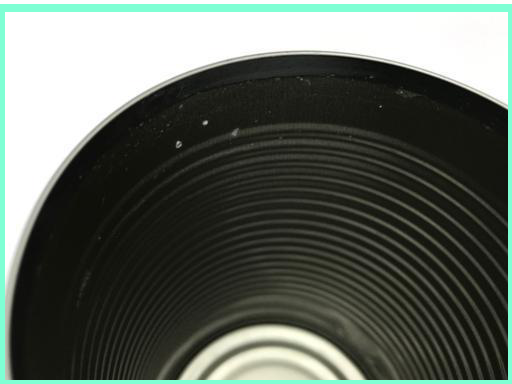

[0.93573165 0.08946921 0.08186441 0.07597195 0.07570923 0.07297325
 0.0699197  0.06556083 0.06069636 0.05894852 0.05727755 0.05667664
 0.05570415 0.05558354 0.05401258 0.0538539  0.05381931 0.04665084
 0.04555778 0.04550267 0.04515171 0.04320293 0.04276777 0.04239643
 0.04152614 0.04129004 0.04012204 0.03922988 0.03895821 0.03796699
 0.03777184 0.03742293 0.03635259 0.03619529 0.03611975 0.03602334
 0.0357849  0.03517888 0.03500399 0.0347337  0.03452366 0.0343957
 0.0341894  0.03382237 0.03374609 0.03372972 0.03363945 0.03311739
 0.03274727 0.03257014 0.03250323 0.03242642 0.03234218 0.03133309
 0.03071499 0.03067632 0.03040502 0.03011635 0.02992512 0.02982605
 0.02934483 0.02931696 0.02929536 0.02920327 0.02906833 0.02892098
 0.02873274 0.02845911 0.02841827 0.02838418 0.02801518 0.02792429
 0.02787479 0.02781796 0.02768338 0.02731715 0.02717048 0.02708858
 0.02686366 0.02641426 0.02638741 0.02637032 0.02600699 0.02595686
 0.02595342 0.02590952 0.02586398 0.02567152 0.02564501 0.02558

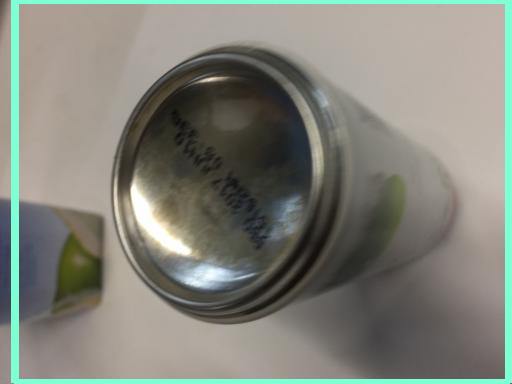

[0.87796134 0.3096254  0.15552507 0.1247479  0.10678789 0.09443612
 0.09417583 0.09357221 0.0876938  0.07777037 0.07380562 0.07307559
 0.07166889 0.06951447 0.06043715 0.05875274 0.0574839  0.05696682
 0.05539061 0.05512462 0.05489089 0.05358694 0.0525203  0.05231498
 0.05130651 0.05114555 0.05015269 0.04984903 0.04875775 0.04743186
 0.0473345  0.04671264 0.04662112 0.04640565 0.0452303  0.04475354
 0.04468977 0.04362376 0.04273921 0.04201596 0.04163182 0.04129964
 0.04125495 0.04018432 0.03876542 0.03830296 0.03814558 0.03778306
 0.03772001 0.03730768 0.03721    0.03720278 0.03699223 0.03603963
 0.03557836 0.03547639 0.03544024 0.03527983 0.0350742  0.03481575
 0.03461707 0.03457011 0.03438551 0.03431018 0.03409956 0.03388664
 0.03326482 0.03301915 0.03291924 0.03289109 0.03283829 0.0326915
 0.03237055 0.03237045 0.03227562 0.03216066 0.03199373 0.03195055
 0.03172477 0.03169988 0.03142899 0.0314071  0.03060444 0.03059401
 0.03015877 0.0301085  0.02971735 0.02967453 0.02965417 0.02958

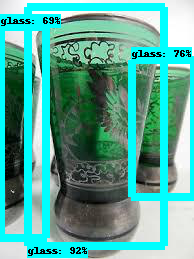

[0.9181054  0.76490074 0.68649554 0.24446446 0.18427242 0.17813152
 0.17585865 0.16369136 0.12993734 0.12871452 0.12746784 0.12698875
 0.12632276 0.12618013 0.11136407 0.11051968 0.09876339 0.09792513
 0.09620827 0.09136675 0.09064803 0.08764792 0.08626027 0.08568574
 0.08511913 0.08143625 0.08019854 0.0784174  0.07787047 0.07665619
 0.0742848  0.07230294 0.06632085 0.06499121 0.06342829 0.0629598
 0.06261146 0.06108817 0.06105529 0.06049979 0.06048806 0.05868131
 0.05785573 0.05724792 0.05703099 0.05688526 0.05643803 0.05614169
 0.05613296 0.05585796 0.05576354 0.0536094  0.05297725 0.05123108
 0.05108655 0.05055397 0.05036581 0.05006409 0.04963844 0.04857226
 0.04774328 0.04756263 0.0469907  0.04681275 0.04651447 0.046389
 0.04629851 0.04604347 0.04564163 0.04532208 0.04485666 0.04477554
 0.0445638  0.04407427 0.0439724  0.04368457 0.04328936 0.0430887
 0.04298408 0.04293237 0.04251285 0.04247302 0.04243729 0.04241255
 0.04219078 0.04179788 0.0414872  0.0412456  0.04112528 0.04070405

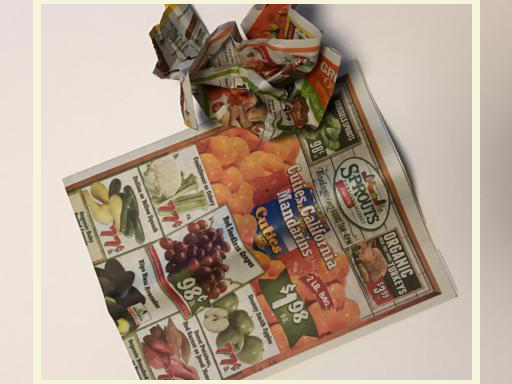

[0.9530931  0.13570806 0.11117253 0.10998683 0.10578851 0.08967868
 0.08740086 0.08075327 0.06340954 0.05826592 0.05560922 0.05405345
 0.05163693 0.05075742 0.0478717  0.04780395 0.04729004 0.04725214
 0.04497105 0.0432785  0.04319363 0.041719   0.04077865 0.0403836
 0.03895969 0.03865917 0.03748536 0.03722543 0.0361291  0.03570671
 0.03492107 0.03452711 0.03434851 0.03417353 0.03390289 0.03351031
 0.03128355 0.03098754 0.03078078 0.03060997 0.03046503 0.03031895
 0.02960899 0.02956103 0.02939022 0.0293847  0.02937094 0.02935442
 0.02906706 0.02883809 0.02876604 0.02855338 0.02848488 0.02837222
 0.02835984 0.02833442 0.02823394 0.0281718  0.02816049 0.02807185
 0.02747021 0.0274284  0.02725517 0.02709804 0.02700431 0.02663558
 0.02659795 0.02658887 0.02628421 0.02627181 0.02625819 0.02622539
 0.02604828 0.02601605 0.02585896 0.02565463 0.02556026 0.02543738
 0.02532446 0.02530069 0.02528339 0.02520175 0.02519359 0.02517565
 0.02511387 0.02492243 0.02490526 0.02489982 0.02488545 0.02483

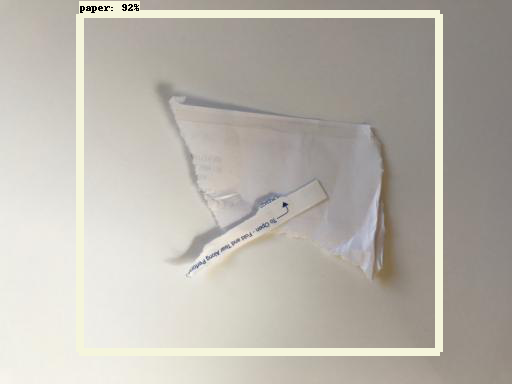

[0.9217877  0.15893643 0.158822   0.13467288 0.11693845 0.11356506
 0.10582317 0.10121491 0.0918887  0.08613081 0.08543149 0.08255537
 0.08086596 0.07982535 0.07962861 0.07189097 0.07159083 0.0708195
 0.070779   0.07007334 0.06995317 0.06935678 0.06858944 0.06724071
 0.06692932 0.06567265 0.06560051 0.06432431 0.0642397  0.06393868
 0.06360166 0.06310357 0.06291093 0.06224812 0.06129167 0.06012148
 0.05955241 0.05944959 0.05873886 0.05865414 0.0584105  0.0583764
 0.05800186 0.05749673 0.0572691  0.05703023 0.05687054 0.05652842
 0.05626607 0.05554488 0.05450242 0.05360866 0.05180856 0.05169744
 0.05143091 0.05105844 0.05058629 0.04977452 0.04872971 0.04870212
 0.0483946  0.04786339 0.0474499  0.04729089 0.04651161 0.04644645
 0.04631936 0.04614008 0.04580107 0.04572159 0.04560392 0.04548243
 0.04539679 0.0451861  0.04426743 0.04387552 0.04373138 0.04331724
 0.04307983 0.04302653 0.04302625 0.04302193 0.04287592 0.04285914
 0.04283448 0.04281303 0.04260307 0.04199083 0.04194437 0.041784

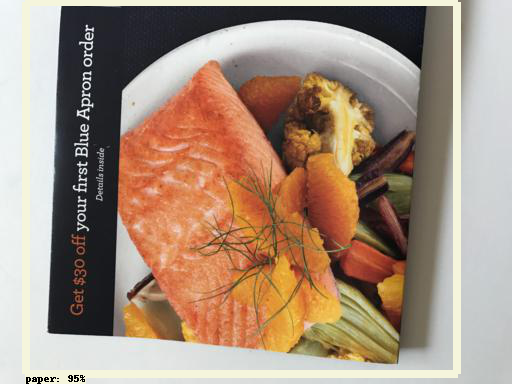

[0.9474806  0.18380588 0.14098166 0.09234165 0.08471376 0.07745095
 0.07577529 0.05626302 0.05396326 0.05247213 0.04990193 0.04964849
 0.04935665 0.04914039 0.04807177 0.04756219 0.04441755 0.04328104
 0.04174187 0.04091765 0.04044021 0.04042019 0.04041184 0.03899247
 0.03884144 0.03869957 0.03866883 0.03845912 0.03821282 0.03819031
 0.03813069 0.03753054 0.0374913  0.03731474 0.03730028 0.03697069
 0.03660171 0.03517323 0.03515525 0.0351108  0.03493214 0.03464847
 0.03431019 0.03392508 0.03380951 0.03374733 0.0331325  0.03267365
 0.03243004 0.03179704 0.03162195 0.03153333 0.03136016 0.03081544
 0.03067918 0.03045249 0.03017858 0.03013051 0.03002091 0.02998405
 0.02985888 0.02974871 0.02968018 0.02962468 0.0295625  0.02956185
 0.02950053 0.02920396 0.02919359 0.02912234 0.02872574 0.02871342
 0.02853445 0.02847305 0.02843593 0.02843397 0.02842122 0.02821348
 0.02801954 0.02789414 0.02789199 0.0277733  0.02746106 0.02724377
 0.02682818 0.02660839 0.02617866 0.02610043 0.02606989 0.0259

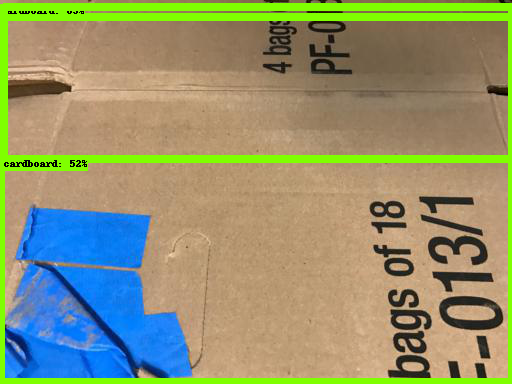

[0.8949023  0.51508904 0.3335326  0.20297275 0.1700358  0.14834781
 0.14657399 0.13637532 0.1101068  0.09725968 0.08931719 0.08332912
 0.07920718 0.07607052 0.07113962 0.07091095 0.06789041 0.067665
 0.06657879 0.06478866 0.06380636 0.06181816 0.06134733 0.06059421
 0.06009005 0.05900382 0.05849642 0.0564751  0.05568593 0.05513953
 0.05369033 0.05363448 0.05266866 0.05251458 0.05221103 0.05112431
 0.04936839 0.0492623  0.04905978 0.04847398 0.04728827 0.04701669
 0.04674495 0.046571   0.04604549 0.04545595 0.04403988 0.0438045
 0.04365185 0.04307203 0.04250691 0.0421614  0.04171095 0.0416647
 0.04096435 0.04026606 0.0400303  0.03918924 0.03885309 0.03819588
 0.03810481 0.0375494  0.03689741 0.03678082 0.03652464 0.03596066
 0.03573339 0.03570318 0.03558032 0.03440771 0.03432545 0.03430111
 0.0341339  0.03409847 0.0339118  0.03372568 0.03361117 0.03347638
 0.03339929 0.0331048  0.03277263 0.03245668 0.03231351 0.03221562
 0.03213173 0.03199472 0.03148118 0.03136073 0.03132638 0.03087988

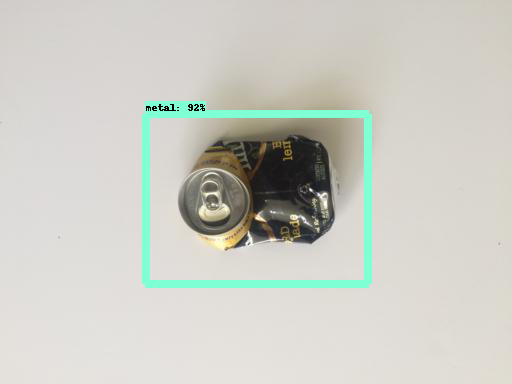

[0.9184901  0.12827584 0.11967292 0.11641414 0.10258424 0.10226495
 0.09927417 0.09699062 0.09539978 0.09498983 0.09495216 0.09232221
 0.09173564 0.08826358 0.0880397  0.0879707  0.08475035 0.08332182
 0.08041933 0.07969321 0.07892112 0.07423674 0.07311704 0.07259864
 0.07085573 0.07030958 0.06939278 0.06846208 0.0684486  0.06691471
 0.06644252 0.06632983 0.06565944 0.06488786 0.06463037 0.06333207
 0.06331586 0.06328423 0.06230411 0.06209271 0.06194524 0.06139908
 0.06097309 0.05958084 0.05910702 0.05904396 0.05903366 0.05721477
 0.05695041 0.05657741 0.05598748 0.055956   0.05583559 0.05581659
 0.05529725 0.0546483  0.05464674 0.05439261 0.0542471  0.05400456
 0.05388107 0.0537501  0.05373809 0.05355845 0.05337333 0.05326164
 0.0531135  0.05276486 0.05253952 0.0523598  0.05180147 0.05176013
 0.05137878 0.05110994 0.05109508 0.05063146 0.05049825 0.04962594
 0.04930877 0.04926891 0.04908407 0.04875342 0.04872562 0.04860438
 0.04806099 0.04799635 0.04665967 0.046639   0.04610014 0.0458

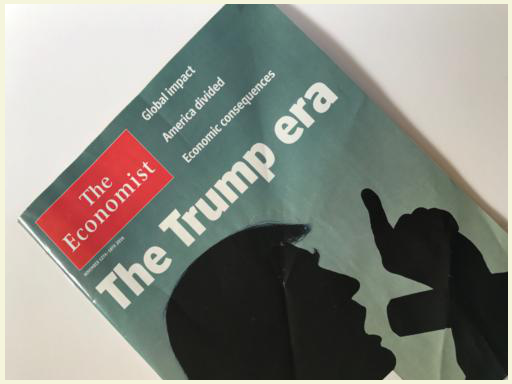

[0.9420974  0.10072446 0.09635336 0.08252132 0.06949532 0.06296695
 0.05680807 0.05218361 0.05212516 0.04846081 0.04797662 0.04792582
 0.04718621 0.04489406 0.04487911 0.04447944 0.04269855 0.04193572
 0.04087036 0.04022474 0.03975999 0.03956645 0.03895475 0.03883458
 0.03505608 0.03487455 0.0346728  0.03441141 0.03435728 0.03417268
 0.03396969 0.0333504  0.03303866 0.03257563 0.0324275  0.03236644
 0.03211831 0.03196406 0.0317855  0.031014   0.03081251 0.03075639
 0.03035349 0.02985063 0.02970254 0.02933283 0.02930687 0.02925345
 0.02917004 0.02914921 0.02892337 0.02816434 0.02794619 0.02770066
 0.02727154 0.02723028 0.02675477 0.02660891 0.02658447 0.0265811
 0.02641491 0.02632148 0.02605571 0.02589875 0.02578848 0.02563111
 0.02521077 0.0251053  0.02509242 0.02496748 0.0248351  0.0248113
 0.02477505 0.02464809 0.02448272 0.0244587  0.02419909 0.02407337
 0.02386179 0.02370041 0.02368785 0.0236199  0.02360059 0.02342918
 0.02337507 0.02328672 0.02306965 0.02291733 0.02290125 0.022757

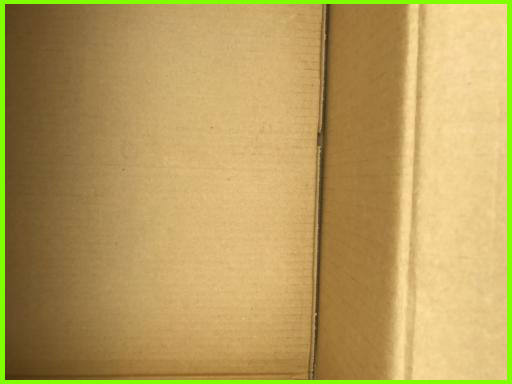

[0.92511135 0.1263764  0.12305035 0.10287844 0.0866441  0.08066967
 0.07213304 0.07134527 0.07040071 0.0687478  0.06750195 0.06683383
 0.06561263 0.06542802 0.06366149 0.06360698 0.06294484 0.06179786
 0.0615026  0.05881339 0.05424362 0.05263989 0.05212586 0.05168382
 0.05100676 0.05089565 0.04946931 0.04765829 0.04758864 0.04659843
 0.04633341 0.0462414  0.04555862 0.04513244 0.04486218 0.04454307
 0.0438217  0.04210202 0.04170566 0.04160476 0.04107417 0.03999252
 0.03980957 0.03967417 0.0395529  0.03937231 0.03914358 0.03905766
 0.03842452 0.03811684 0.03802123 0.03795459 0.03776561 0.03766093
 0.03722569 0.03686651 0.03681676 0.0367645  0.03588937 0.03586974
 0.03551028 0.03505891 0.03500591 0.03493796 0.03411934 0.03398134
 0.03321058 0.03317459 0.03313963 0.03293949 0.03272533 0.03272436
 0.03248008 0.0324212  0.03241279 0.03236116 0.03212897 0.03202478
 0.0319294  0.03185404 0.03151997 0.03151729 0.03138486 0.031257
 0.03072558 0.02978991 0.02948241 0.02940855 0.02931921 0.029132

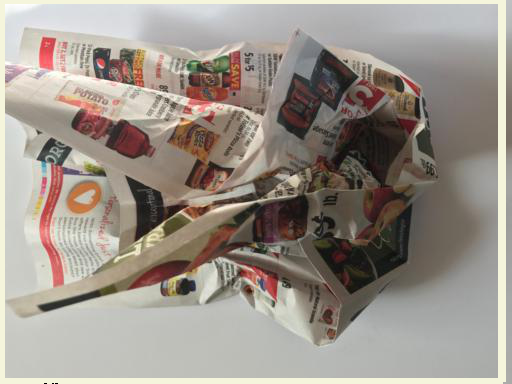

[0.9439591  0.11454807 0.0826427  0.07850008 0.06897143 0.06580664
 0.06472961 0.06086838 0.06030739 0.05933285 0.05590715 0.05416134
 0.04860336 0.04721844 0.04662548 0.04556556 0.04444745 0.04386749
 0.04364319 0.03937872 0.03887061 0.03790694 0.03623816 0.03530007
 0.03508853 0.03481195 0.03345413 0.03339747 0.03293915 0.03267157
 0.03256237 0.03173121 0.03134587 0.03080666 0.0306178  0.03039866
 0.03017158 0.02982912 0.0296289  0.02959608 0.02923111 0.02904582
 0.02904012 0.02854285 0.02830639 0.02826601 0.02794256 0.02793573
 0.02791296 0.02766955 0.02757575 0.02686453 0.02667513 0.02648888
 0.02619652 0.02588342 0.02567861 0.02558779 0.02548742 0.02544842
 0.02540122 0.02533655 0.02483623 0.02460127 0.02438791 0.02422102
 0.02420329 0.0239337  0.02363425 0.02315787 0.02278052 0.0226516
 0.02261946 0.02228261 0.02202338 0.02202117 0.02178427 0.02160017
 0.02146948 0.02135945 0.02124089 0.02117556 0.02098073 0.02097768
 0.02092846 0.02081865 0.02072166 0.02062588 0.02051658 0.02045

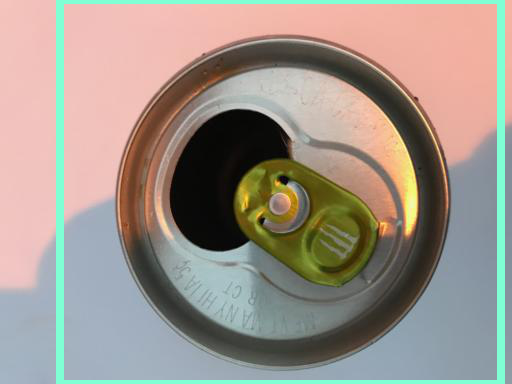

[0.9539152  0.10905296 0.09189473 0.08169998 0.0788887  0.07785446
 0.07269226 0.0678666  0.05766142 0.05649957 0.05459816 0.05307879
 0.05220042 0.05058608 0.04462957 0.04440168 0.04407662 0.04341201
 0.04149605 0.04146942 0.04121482 0.03883648 0.037216   0.03677796
 0.03676338 0.03670467 0.03667064 0.03632043 0.03595093 0.03489073
 0.03486826 0.0347711  0.03464889 0.0345225  0.03404623 0.03371947
 0.03344263 0.03323662 0.03315677 0.03307885 0.03297245 0.03275427
 0.03263269 0.03251008 0.03225724 0.03210886 0.0316951  0.03151307
 0.0314093  0.03139184 0.03119942 0.03119246 0.03112024 0.03078161
 0.03061687 0.03051122 0.0301912  0.0298983  0.02987485 0.02982831
 0.02973743 0.02972005 0.02968161 0.02908293 0.0290583  0.02904819
 0.02839906 0.02829049 0.02795695 0.02780412 0.02762799 0.02749532
 0.0274834  0.02726867 0.02715838 0.02690518 0.02689746 0.02669897
 0.02664351 0.02661883 0.02657072 0.02620467 0.02604612 0.02586246
 0.02576674 0.02568019 0.02559587 0.02555397 0.02552415 0.0254

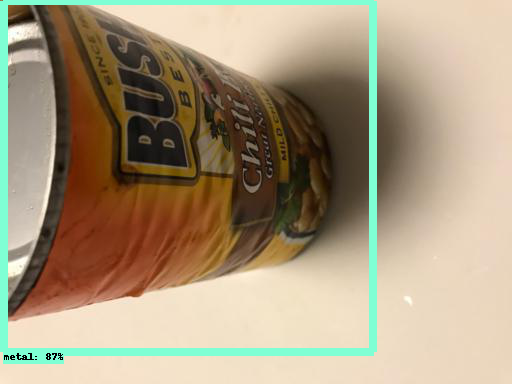

[0.8727257  0.13941179 0.12511581 0.10875415 0.10522905 0.09755988
 0.09473361 0.09120695 0.07464923 0.07325836 0.07164095 0.07152065
 0.06805532 0.06712802 0.06584787 0.06567327 0.05997808 0.05944675
 0.05903136 0.05561841 0.05255901 0.04845658 0.04773994 0.04755727
 0.04675245 0.04669655 0.04645453 0.04574807 0.0436383  0.04363294
 0.04332186 0.04256606 0.04247516 0.0412554  0.04052158 0.04047256
 0.04038089 0.03951471 0.03917696 0.03869481 0.03863964 0.03798869
 0.03728088 0.03718553 0.03716054 0.03698381 0.03682381 0.03620576
 0.035945   0.03558576 0.03528643 0.03455196 0.03449062 0.03433786
 0.03383506 0.0337025  0.0336654  0.03335867 0.03334072 0.03333427
 0.03323133 0.03295256 0.03284183 0.0324287  0.03237547 0.0321966
 0.03214002 0.03210837 0.03168183 0.03115096 0.03105231 0.03082271
 0.03057775 0.03012089 0.03011808 0.0298987  0.02960084 0.02959394
 0.02948163 0.02927756 0.02922076 0.02899071 0.02887201 0.02882125
 0.02873626 0.02869749 0.02868933 0.02852087 0.0285142  0.02851

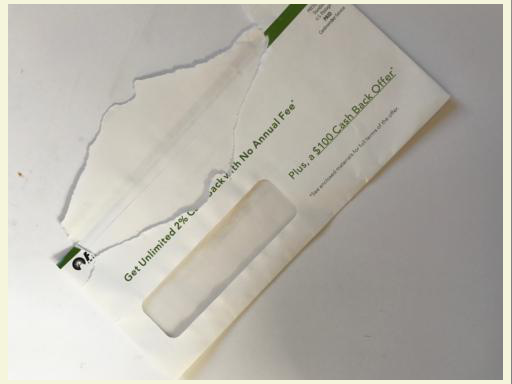

[0.9369513  0.14266486 0.1223016  0.10797709 0.10507322 0.08994783
 0.08946043 0.07597329 0.07352354 0.07091021 0.0693294  0.06888436
 0.06737988 0.06589088 0.06081467 0.06061405 0.05998069 0.05443271
 0.05434249 0.05365505 0.05089088 0.0497383  0.049073   0.04702731
 0.04656994 0.04638281 0.04567653 0.04390163 0.04388861 0.04376607
 0.04321529 0.04201685 0.04182206 0.04028738 0.03984751 0.0396868
 0.03843284 0.0370655  0.03575623 0.03521747 0.03505706 0.03486827
 0.03482263 0.03470901 0.03458193 0.03432925 0.03416448 0.03396771
 0.03368528 0.03361169 0.03284706 0.03259463 0.03249329 0.03243417
 0.03234748 0.03210867 0.03210485 0.0316774  0.03165499 0.03155013
 0.03141877 0.03134492 0.03116598 0.03098014 0.03095287 0.03089853
 0.03082941 0.03063128 0.03055217 0.0304598  0.03045823 0.03025418
 0.02964456 0.02963169 0.02960675 0.02959356 0.02943937 0.02892217
 0.02888806 0.02876473 0.02875228 0.0286639  0.02855808 0.02845652
 0.02797275 0.02788834 0.0278156  0.02740437 0.0272834  0.02722

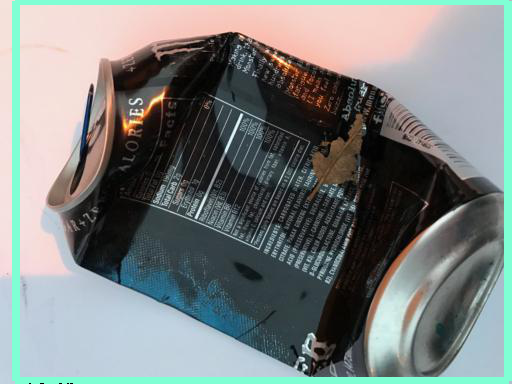

[0.93864095 0.17439441 0.07745283 0.07651047 0.07182743 0.0685867
 0.0631614  0.06278702 0.05622154 0.05600435 0.05526423 0.05366009
 0.05029755 0.04929034 0.04684142 0.04402002 0.04305834 0.04300829
 0.04261957 0.04242709 0.04190759 0.04145992 0.04108981 0.04088628
 0.04066714 0.04059402 0.04046023 0.03961999 0.03898194 0.03878173
 0.03787644 0.03755239 0.03671148 0.03653473 0.03596404 0.03587355
 0.0350298  0.03498921 0.03464166 0.0344293  0.03438559 0.03402281
 0.03371059 0.03366486 0.03365255 0.03303931 0.03276994 0.03226661
 0.03216008 0.03190276 0.03171354 0.0312603  0.03125506 0.03111588
 0.03036475 0.02968675 0.0296812  0.0295244  0.0295193  0.02931051
 0.02929353 0.0291512  0.02911345 0.02894446 0.02881089 0.02860151
 0.02848352 0.02837565 0.02832006 0.02829482 0.02825747 0.0281675
 0.02805219 0.02802328 0.02773711 0.02740746 0.02737914 0.02737689
 0.02730265 0.02729674 0.02729151 0.0271918  0.02712685 0.02712153
 0.02698761 0.02690811 0.0267839  0.02614439 0.02606004 0.025992

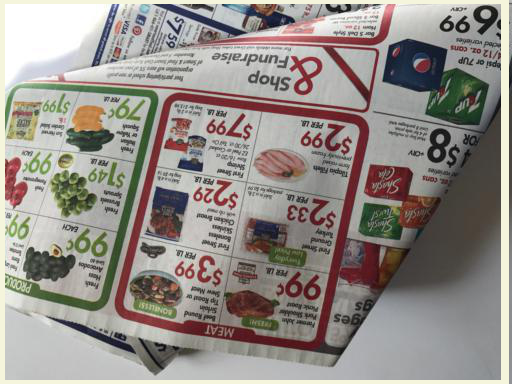

[0.9398291  0.10428136 0.09942676 0.08373417 0.08272668 0.06964552
 0.0625893  0.0623378  0.05718374 0.05484524 0.05390641 0.05180247
 0.05087205 0.04910956 0.03747074 0.03705845 0.03570609 0.03532074
 0.0349708  0.03436364 0.03202797 0.03186031 0.03161893 0.03157981
 0.03146119 0.03128471 0.03046297 0.03018007 0.03013306 0.03013147
 0.0299326  0.02921141 0.02909256 0.02876822 0.02842588 0.02804557
 0.02804193 0.02801242 0.02797343 0.02792327 0.02788313 0.02748558
 0.02713902 0.02663102 0.02659671 0.02630071 0.02629438 0.02604383
 0.02572159 0.02544685 0.02529    0.02503969 0.02488451 0.0243462
 0.02419791 0.02415746 0.02407691 0.02391065 0.0239024  0.02368843
 0.02350861 0.02328292 0.02318816 0.0230844  0.02306074 0.02298236
 0.02297228 0.0228383  0.02255477 0.02245508 0.02238169 0.02233582
 0.02216351 0.02198388 0.02193934 0.02188406 0.02185942 0.02180362
 0.02171875 0.02160949 0.02136134 0.02132259 0.02122861 0.02108823
 0.0209589  0.02087082 0.02081039 0.02073076 0.02070788 0.02068

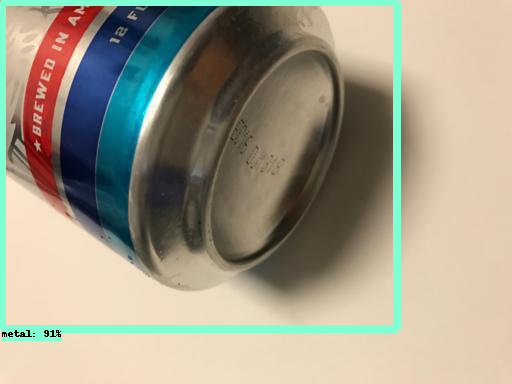

[0.9054019  0.10828864 0.08302256 0.0750029  0.07113581 0.07100789
 0.06865042 0.06645251 0.06627952 0.06504808 0.06396925 0.06286892
 0.06028459 0.06007804 0.0575248  0.05274632 0.05270502 0.05153653
 0.05065447 0.04926183 0.04786946 0.0477201  0.04720252 0.04693284
 0.04568414 0.04567925 0.04521252 0.04515925 0.04435735 0.04396156
 0.04372967 0.04170504 0.04135088 0.04102847 0.04062441 0.04058616
 0.03985247 0.0392262  0.03879385 0.03823729 0.03802915 0.03755843
 0.03655001 0.03651957 0.03622971 0.03621322 0.03615471 0.03591294
 0.03527509 0.03493688 0.03491513 0.03434889 0.03388074 0.03362564
 0.03352308 0.03320482 0.03284111 0.03268243 0.03256648 0.03195772
 0.03174132 0.03122455 0.03118482 0.03069125 0.03065749 0.03031905
 0.03025628 0.0302556  0.03006452 0.02982835 0.02969041 0.029554
 0.02945588 0.02941728 0.02902301 0.02884672 0.02883316 0.02860453
 0.02846961 0.02846917 0.0284595  0.02794229 0.02789338 0.02765603
 0.02757152 0.02733861 0.02725505 0.02719738 0.02711474 0.027043

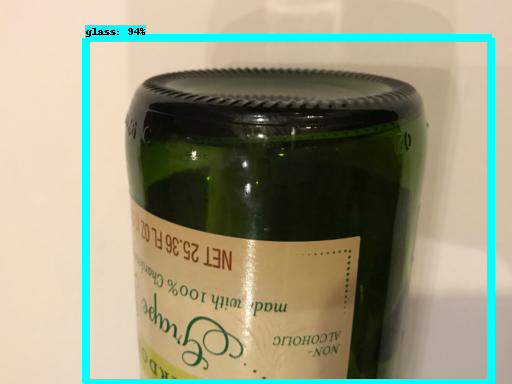

[0.9380781  0.13948491 0.11894613 0.1007781  0.09277848 0.09089284
 0.08815092 0.08732951 0.08200963 0.07936044 0.07784873 0.07762606
 0.07156454 0.06932009 0.06637499 0.06574948 0.06447411 0.05968292
 0.05936977 0.05876144 0.05767598 0.05670456 0.05328661 0.04996686
 0.04814233 0.04806228 0.0477491  0.04674231 0.04573857 0.04515753
 0.04399874 0.04356636 0.04334972 0.043105   0.04279359 0.04272093
 0.04193847 0.04166188 0.04149704 0.04133461 0.04122501 0.04117165
 0.04101095 0.04077956 0.04058108 0.04055122 0.04007557 0.03996998
 0.03978266 0.03974617 0.039316   0.03920343 0.03904445 0.03872767
 0.03851568 0.0375274  0.03733474 0.03675942 0.03628104 0.03570552
 0.03522686 0.03519535 0.03511599 0.03510541 0.03471061 0.03449723
 0.03406976 0.03361098 0.03357016 0.03353629 0.03295168 0.03261314
 0.03250701 0.03241368 0.03231408 0.03224766 0.03215175 0.03214084
 0.03174863 0.03157156 0.03156548 0.03155045 0.03129561 0.03098223
 0.03068771 0.03036711 0.03027005 0.03021169 0.03018906 0.0301

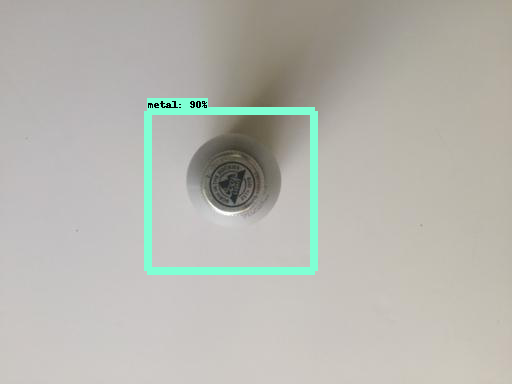

[0.9002992  0.14128928 0.137366   0.12541515 0.1197973  0.11527386
 0.11365729 0.11291562 0.10311515 0.10006507 0.0969618  0.09643041
 0.09549657 0.09529219 0.09218396 0.09206507 0.090652   0.08915292
 0.08870833 0.08823141 0.08816993 0.08816586 0.08702354 0.08669209
 0.08554036 0.08239211 0.08143439 0.07988594 0.07962023 0.07914277
 0.07893472 0.07887823 0.07690914 0.07685231 0.07494844 0.07450252
 0.07442531 0.0742553  0.07117536 0.07101431 0.07043051 0.07032643
 0.07021144 0.06992756 0.06977762 0.06853814 0.066938   0.06645934
 0.06606078 0.06559406 0.06557054 0.06474089 0.06343836 0.06339465
 0.06285739 0.06260312 0.06243111 0.06238646 0.06194935 0.06139087
 0.06112523 0.05955141 0.05942633 0.05942353 0.05875086 0.05851452
 0.05837829 0.05811721 0.05757579 0.05745758 0.05590736 0.05561871
 0.05538631 0.05515255 0.05507383 0.05479714 0.05437174 0.05407801
 0.0538256  0.05380093 0.05357716 0.0530258  0.05300163 0.05280329
 0.05260245 0.05253026 0.05245884 0.05199989 0.051804   0.0516

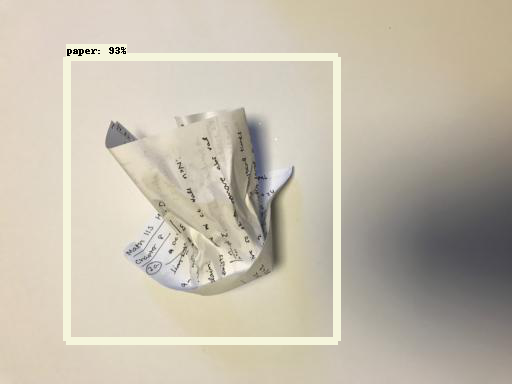

[0.93348604 0.14318103 0.12602521 0.09882904 0.0972738  0.0958131
 0.09079904 0.08824538 0.08709881 0.0827481  0.080194   0.07704048
 0.07416504 0.07331685 0.07175297 0.07059468 0.07022468 0.06874926
 0.06727558 0.06309105 0.06262308 0.06252448 0.06214398 0.06095023
 0.05836295 0.05835757 0.05797356 0.05772388 0.05770275 0.0569475
 0.05657923 0.05656998 0.05545029 0.05528935 0.05247022 0.05149322
 0.05125873 0.05116098 0.05005724 0.04998674 0.04953521 0.0494585
 0.04884138 0.04828921 0.04798162 0.04786614 0.04763173 0.04546022
 0.04523185 0.04504073 0.04460244 0.04414979 0.04338964 0.04308412
 0.04306623 0.04291756 0.04273667 0.04263304 0.04239913 0.04239323
 0.04217527 0.04195856 0.04174959 0.041689   0.04149911 0.04147916
 0.04084962 0.04082719 0.04035715 0.04031951 0.0402665  0.04010867
 0.04008287 0.04004404 0.03999257 0.03961115 0.03947007 0.03935972
 0.03930629 0.03929983 0.03905421 0.03890765 0.03890222 0.03860658
 0.0379261  0.03789954 0.0376307  0.03755186 0.03753204 0.0373321

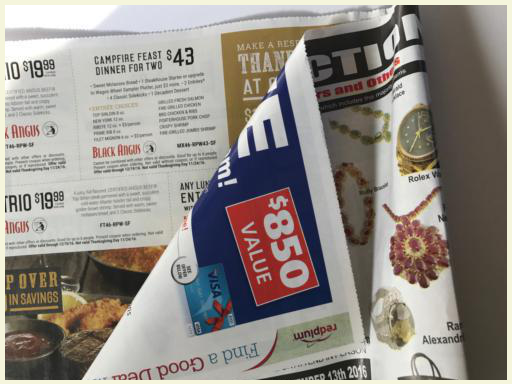

[0.94526607 0.08653375 0.08165263 0.07911736 0.0707111  0.06778335
 0.06763399 0.06517634 0.0578354  0.05545682 0.05186654 0.04980265
 0.04929031 0.04744441 0.04463519 0.04452672 0.04052332 0.0396849
 0.03894012 0.03826913 0.03815421 0.03663049 0.03629219 0.03597943
 0.0359427  0.03584186 0.03573985 0.03572691 0.03488936 0.03455482
 0.03448775 0.03421342 0.03388666 0.0338373  0.03335581 0.03262845
 0.03254012 0.02932195 0.02920994 0.02890392 0.02862827 0.02853942
 0.02851243 0.0281783  0.02816898 0.02814405 0.0280968  0.02807267
 0.02768764 0.02733007 0.02730114 0.02705412 0.02693777 0.02648435
 0.02626953 0.0262375  0.02618878 0.02607221 0.02604701 0.02580147
 0.02548311 0.02536074 0.02506358 0.02479971 0.02478455 0.02476589
 0.02406739 0.0238719  0.02376751 0.02357704 0.02349442 0.02340561
 0.02328935 0.02295922 0.02261924 0.02252    0.02249727 0.02244143
 0.0224393  0.02240568 0.02225148 0.02210671 0.02203144 0.02175738
 0.02175582 0.02172595 0.02145712 0.02116729 0.02114872 0.02100

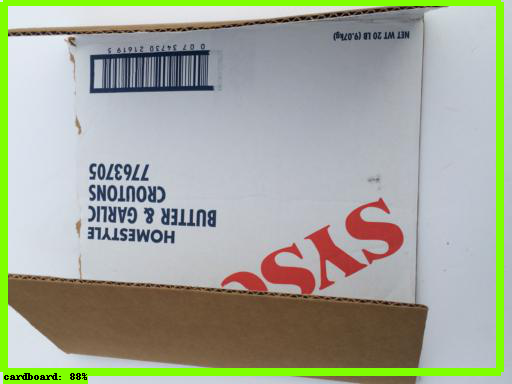

[0.8844645  0.4994143  0.17000945 0.16183507 0.15913036 0.1246014
 0.11456817 0.1124913  0.1008746  0.09487775 0.08025692 0.0802319
 0.07992972 0.07764794 0.07732822 0.07686296 0.07392126 0.07276601
 0.07160448 0.0692379  0.0685112  0.06846882 0.06708582 0.06662446
 0.06527628 0.062331   0.06209187 0.0609416  0.05900405 0.05783438
 0.0574086  0.05696751 0.05667396 0.05435804 0.05417022 0.05289487
 0.05282766 0.05183393 0.05171719 0.05165853 0.05161748 0.04985214
 0.04958704 0.04939186 0.04925798 0.04883059 0.04867045 0.04830019
 0.04782255 0.04748112 0.04735719 0.04719673 0.04633792 0.04578945
 0.04575626 0.04542019 0.04518772 0.04433882 0.04427107 0.04402559
 0.04379376 0.04333637 0.0432431  0.04298855 0.04234286 0.04213267
 0.04136957 0.04134963 0.04082499 0.0408232  0.04030268 0.03935177
 0.03923999 0.03922298 0.03884429 0.03879228 0.03851518 0.03848099
 0.03841796 0.03834546 0.03810236 0.03798471 0.03776496 0.03737467
 0.03716171 0.03686003 0.03633106 0.03563133 0.03558894 0.035071

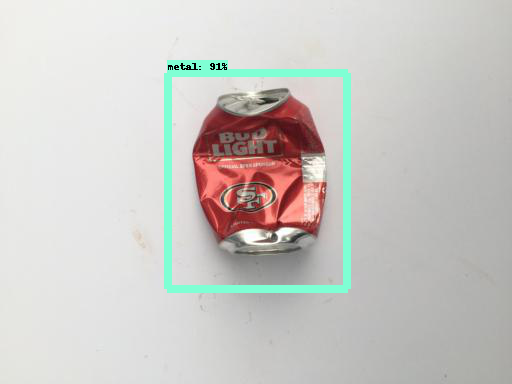

[0.91307527 0.1283032  0.12215711 0.11746645 0.11171993 0.10853034
 0.10804471 0.10522898 0.10242102 0.10229838 0.09769458 0.09764118
 0.09763215 0.0975188  0.0967261  0.09430755 0.09403575 0.09247582
 0.0897705  0.08901958 0.08894513 0.08808325 0.08564878 0.08564201
 0.08477087 0.08458638 0.08226313 0.08172116 0.07956867 0.07875628
 0.07839721 0.07708907 0.0770162  0.07700671 0.07610457 0.07485635
 0.07459721 0.07429029 0.07295532 0.07061526 0.07033795 0.06956436
 0.06950808 0.06940591 0.06735256 0.06725643 0.06687609 0.06645919
 0.06632968 0.06616814 0.06501273 0.06279965 0.06258592 0.06255842
 0.06218347 0.06196073 0.06185666 0.06105876 0.05906083 0.05902864
 0.0584796  0.05768765 0.05706568 0.05688224 0.05675044 0.05652594
 0.05647741 0.05607082 0.05586201 0.0553886  0.055386   0.05511514
 0.05416247 0.05349407 0.05298957 0.05297937 0.05277233 0.05197449
 0.05174024 0.05099323 0.05060085 0.05036146 0.05024895 0.04997185
 0.04996035 0.04985315 0.04983281 0.04970806 0.04967125 0.0493

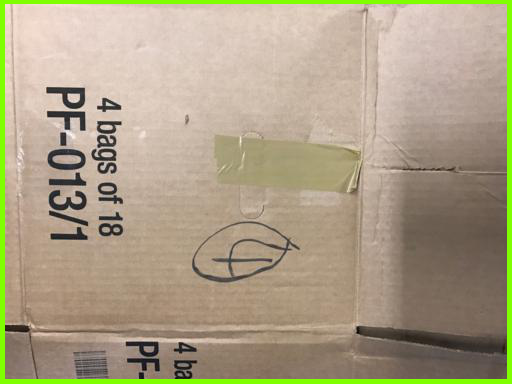

[0.92236966 0.15157466 0.1475185  0.13364704 0.13293007 0.12442429
 0.11437847 0.10227603 0.10190921 0.10029553 0.09477799 0.08616948
 0.08614523 0.0844403  0.08387322 0.08312348 0.08139502 0.08130961
 0.08075415 0.07916051 0.07566963 0.07528991 0.07492364 0.07474934
 0.07459619 0.07388413 0.07321015 0.07228481 0.07164408 0.07039671
 0.06947504 0.06691575 0.06684853 0.06447269 0.06377269 0.06254761
 0.06233979 0.06085719 0.06012021 0.05760977 0.05739013 0.05725428
 0.05624076 0.05614935 0.0561366  0.05569838 0.0554425  0.05442103
 0.05433002 0.05283276 0.05196178 0.05169428 0.05091038 0.05046591
 0.0501147  0.04925129 0.04895673 0.04826687 0.04825677 0.04777787
 0.04736817 0.04701225 0.04698073 0.04693715 0.04673051 0.04652915
 0.04645351 0.04635099 0.0456058  0.04516584 0.04462076 0.04437411
 0.04403579 0.04370808 0.04332258 0.0431534  0.04308609 0.04257562
 0.04252168 0.04236782 0.04236631 0.04214565 0.04164603 0.04144367
 0.0414101  0.04134885 0.04120038 0.04092161 0.04078876 0.0407

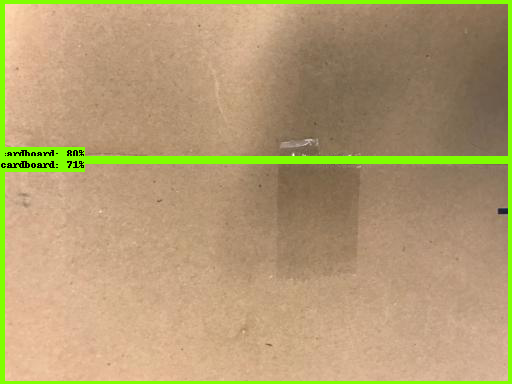

[0.80151004 0.7090075  0.09457357 0.08113151 0.07350412 0.06622525
 0.06452126 0.06398191 0.06371392 0.06209086 0.05831555 0.05799463
 0.05657111 0.05485161 0.05447244 0.05393397 0.05170136 0.04832587
 0.04739482 0.04703637 0.04492301 0.0448902  0.04423217 0.04348321
 0.04301788 0.04289346 0.04168744 0.04118939 0.03994575 0.03930939
 0.0389816  0.03895862 0.03895252 0.03855338 0.03826503 0.0378895
 0.03718385 0.03667184 0.03612272 0.03599412 0.03589849 0.03487558
 0.03483277 0.03476747 0.03470023 0.03469381 0.03447599 0.03403425
 0.03356281 0.03351027 0.03272223 0.03268078 0.03167833 0.03039256
 0.03023922 0.02964533 0.02904863 0.02893591 0.02875053 0.02864172
 0.02859587 0.02840199 0.02818364 0.0281148  0.02810646 0.02786959
 0.02775737 0.02748931 0.02734918 0.02719082 0.02717193 0.02715867
 0.02696646 0.02651548 0.02637843 0.02624757 0.0262329  0.02613453
 0.02593584 0.02586729 0.02583986 0.02579346 0.02564798 0.02552244
 0.02540585 0.02537211 0.02515404 0.02491139 0.02475786 0.02451

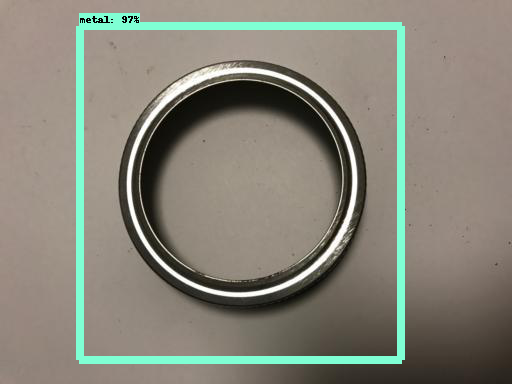

[0.96763915 0.1849569  0.18102503 0.1803457  0.17138162 0.11008466
 0.09905869 0.09183205 0.09049523 0.0880537  0.08758106 0.0871434
 0.08402438 0.07618995 0.07437649 0.07261246 0.07116852 0.06826513
 0.06720407 0.0661571  0.06599046 0.06289064 0.06227893 0.06177904
 0.06112184 0.05923694 0.05826472 0.05729173 0.0538488  0.05252762
 0.05097663 0.04792902 0.04749599 0.04696273 0.04677887 0.04667121
 0.0464264  0.0452295  0.0450907  0.04499914 0.04479863 0.04467858
 0.04385681 0.04375646 0.04345434 0.04272127 0.04234761 0.04210442
 0.0418564  0.04179963 0.04160831 0.04051417 0.04044635 0.04042221
 0.04035659 0.0398055  0.03962974 0.03934125 0.03878265 0.03863146
 0.03812625 0.03808449 0.03797461 0.03755867 0.03754399 0.03720043
 0.03714956 0.0367881  0.03647816 0.03614283 0.03606254 0.03493172
 0.03480043 0.03424404 0.03416417 0.03414389 0.03411657 0.03395433
 0.03343898 0.03324327 0.03316843 0.03295366 0.03268555 0.03224092
 0.03209315 0.03201577 0.03182945 0.03154407 0.03147063 0.03137

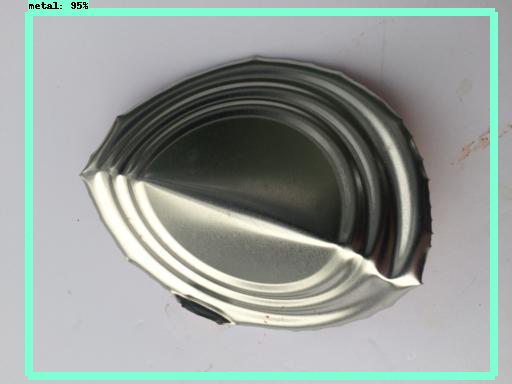

[0.9544657  0.1246175  0.09107818 0.0690833  0.06229863 0.05553347
 0.05470008 0.05013438 0.04926069 0.04870365 0.0443674  0.04345262
 0.04336034 0.04248253 0.03881738 0.03863275 0.0384616  0.03753283
 0.0375187  0.03724733 0.03595303 0.03321373 0.03257306 0.03218523
 0.0321645  0.03172309 0.03142247 0.03136398 0.03122874 0.03090233
 0.03008748 0.02971281 0.0296527  0.02953848 0.02939934 0.02934078
 0.02925531 0.02865466 0.02849815 0.02847923 0.02839351 0.02797527
 0.02794344 0.02793479 0.0273871  0.02738674 0.02734973 0.02718968
 0.02709855 0.02699947 0.02688017 0.02685267 0.02669938 0.02666847
 0.02649477 0.02644454 0.02640297 0.02620481 0.02615269 0.02600878
 0.02564912 0.02561261 0.02556743 0.02547042 0.02537427 0.02530084
 0.02516517 0.02514508 0.02495917 0.02487145 0.02476595 0.02475207
 0.02474629 0.02467379 0.02467097 0.02459164 0.02449838 0.02446551
 0.02429402 0.02427925 0.02406177 0.02399049 0.02382687 0.02373616
 0.02367494 0.02358696 0.02326773 0.02317679 0.02311852 0.0230

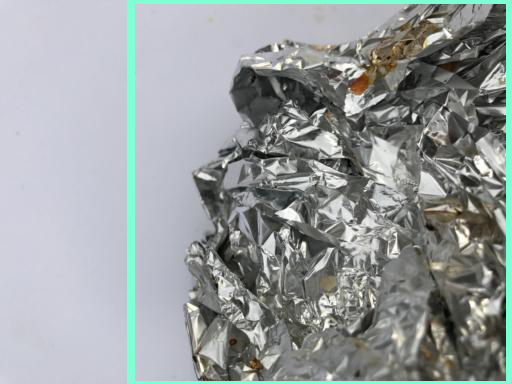

[0.9018112  0.12802675 0.10155678 0.09876885 0.09191531 0.07483581
 0.07463259 0.07393111 0.07227329 0.06967035 0.06826894 0.06673035
 0.06487099 0.06337897 0.06204429 0.059084   0.05741414 0.0572849
 0.05467013 0.0545696  0.05407465 0.0533593  0.05327623 0.05300772
 0.05224866 0.05179238 0.04809949 0.04771523 0.0469145  0.04659936
 0.04485287 0.04478778 0.04461331 0.04379917 0.04338998 0.04275053
 0.0426756  0.04242079 0.04168699 0.04118888 0.0411594  0.04067155
 0.0406283  0.04034495 0.04021255 0.03988296 0.03926314 0.03900484
 0.03881234 0.03878525 0.03858762 0.03857214 0.03853252 0.03791867
 0.03786842 0.03769143 0.0376726  0.03767014 0.03725629 0.03708286
 0.03673208 0.03613099 0.03606069 0.03598711 0.03571276 0.03552861
 0.03534953 0.03515634 0.03491081 0.03459588 0.03449443 0.03430533
 0.03425799 0.03416417 0.03414731 0.0340573  0.03401976 0.03370739
 0.03360723 0.0335536  0.03328226 0.03282786 0.03240804 0.03230359
 0.03193887 0.03172856 0.03157946 0.03131932 0.03126872 0.03107

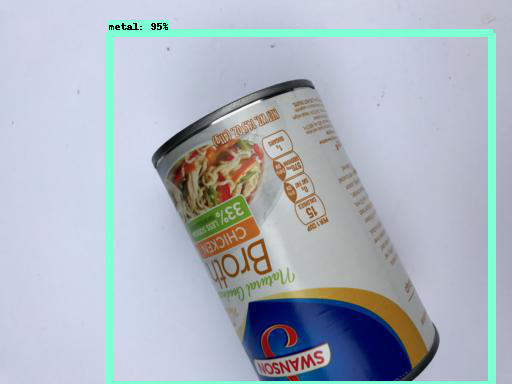

[0.94602424 0.10629717 0.10527326 0.09890842 0.09355701 0.0860716
 0.08505975 0.08315618 0.0826201  0.0802622  0.07785991 0.07509536
 0.0738147  0.06784628 0.06701823 0.06513173 0.0577287  0.05679191
 0.05599862 0.05509008 0.05340434 0.05327586 0.05236163 0.05048556
 0.04902472 0.04720594 0.04715944 0.0465978  0.0465384  0.04617941
 0.04585462 0.04489368 0.04479642 0.0445909  0.04405262 0.04331066
 0.04329903 0.0432269  0.04308954 0.04304452 0.04304272 0.0417351
 0.04046929 0.03972063 0.0390996  0.03888177 0.03729371 0.03709093
 0.03664644 0.03660275 0.03645248 0.03629515 0.03613179 0.03608052
 0.03600246 0.03555477 0.03486185 0.03453891 0.03447662 0.03443503
 0.03422882 0.0339122  0.0339019  0.03385627 0.03376371 0.03339085
 0.03308214 0.03299727 0.03298774 0.03263753 0.03218782 0.03217271
 0.03206638 0.03195601 0.0313952  0.0313498  0.03128692 0.03091954
 0.03089671 0.0300217  0.02992392 0.02987718 0.02972605 0.02963702
 0.02958004 0.02950469 0.02945073 0.02938605 0.02932071 0.029306

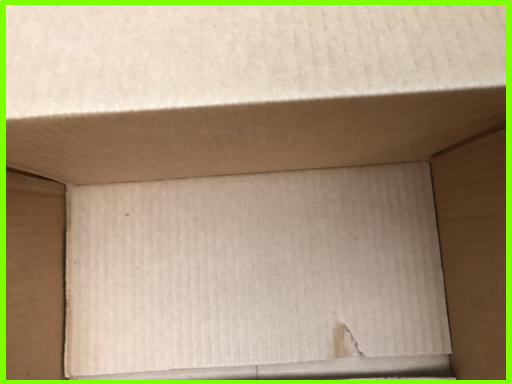

[0.91645485 0.11380596 0.10824145 0.08766344 0.08475685 0.08467375
 0.08420802 0.06909532 0.06257614 0.06118083 0.06101719 0.05709403
 0.05518352 0.05417664 0.05289482 0.05075904 0.04999309 0.04995474
 0.04939033 0.04781758 0.0464009  0.04637915 0.04556448 0.04453983
 0.04452252 0.04263606 0.04218598 0.04186351 0.04140357 0.03980342
 0.03947687 0.03906023 0.03821571 0.03791908 0.03733468 0.03690256
 0.03540475 0.03534    0.03517598 0.03502118 0.0339605  0.03312595
 0.0329176  0.03273643 0.03265791 0.03254879 0.03254047 0.0324203
 0.03216114 0.03188187 0.03176128 0.03165776 0.0315028  0.03068257
 0.03012847 0.0298345  0.02970743 0.02864499 0.02844312 0.02834718
 0.02820251 0.0281223  0.02799904 0.02793952 0.02774496 0.02771172
 0.02763667 0.0275495  0.027518   0.0274482  0.02739011 0.0272706
 0.02697056 0.02685301 0.02680374 0.02655899 0.02643076 0.02632961
 0.02608717 0.02591357 0.02563477 0.02552573 0.02534127 0.02518039
 0.02470303 0.02452546 0.02425903 0.02407403 0.02407148 0.024031

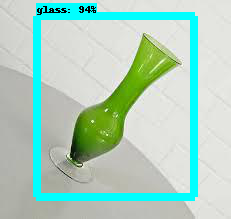

[0.94029546 0.14082004 0.1378767  0.13302346 0.12011246 0.10233519
 0.09118003 0.08595344 0.06776524 0.05982405 0.05835984 0.05771269
 0.05679878 0.05579356 0.05048103 0.04928412 0.04830366 0.04422377
 0.04293133 0.04291783 0.04245742 0.04183764 0.0412304  0.0409312
 0.04055369 0.04050814 0.03955428 0.03938403 0.03889133 0.03711889
 0.03707746 0.03707441 0.0361773  0.03605008 0.03570509 0.03520451
 0.03512935 0.03470304 0.03438515 0.03404407 0.0333726  0.03316161
 0.03296912 0.03261612 0.03247096 0.03209688 0.03181042 0.03138923
 0.03071    0.03042339 0.03022819 0.0301782  0.03005451 0.02972608
 0.02957264 0.02935378 0.02929977 0.02920637 0.02916102 0.02910766
 0.02904629 0.02873246 0.02848021 0.02833375 0.02825807 0.02816694
 0.02805373 0.02776222 0.02772884 0.02768543 0.02768003 0.02756512
 0.02703064 0.02689989 0.02686085 0.02685333 0.02684292 0.02675119
 0.02670739 0.0266546  0.02638691 0.02620324 0.02610695 0.02604389
 0.02574843 0.02574584 0.02572187 0.02558255 0.02545532 0.02494

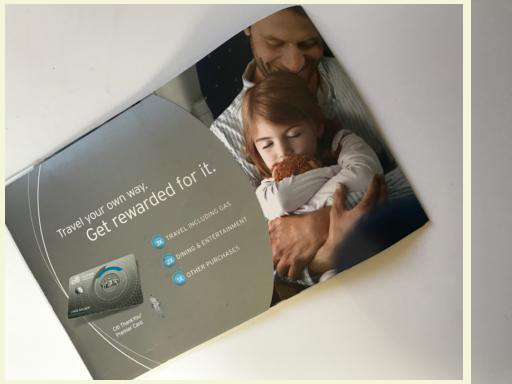

[0.9417478  0.11463019 0.0887107  0.08273656 0.07272906 0.05975391
 0.0595841  0.05680531 0.05245101 0.04804328 0.04741379 0.04440008
 0.0438746  0.04356637 0.04154224 0.04067373 0.04058682 0.04007475
 0.03912527 0.03885413 0.03800508 0.03779813 0.03766712 0.03759072
 0.03718212 0.03702094 0.03673454 0.03673    0.0365254  0.03651317
 0.03649752 0.03636923 0.03609248 0.03607197 0.03531122 0.03519972
 0.03514152 0.03461383 0.03426784 0.03354307 0.03308323 0.03292835
 0.03276968 0.03258488 0.03227051 0.03201287 0.03166025 0.03154024
 0.03102723 0.03098879 0.03072651 0.03048357 0.03047642 0.02949168
 0.02941665 0.02915235 0.02883276 0.02880212 0.02875562 0.0279994
 0.02779431 0.02738435 0.02728557 0.02706053 0.02690318 0.02685851
 0.02671934 0.02656212 0.02648196 0.02647998 0.02633803 0.0260095
 0.02588967 0.02586927 0.02570309 0.02569336 0.02563936 0.02556174
 0.02542304 0.02538174 0.02536421 0.0253406  0.02531025 0.02524208
 0.02504568 0.02489057 0.02452972 0.02452014 0.02446293 0.024461

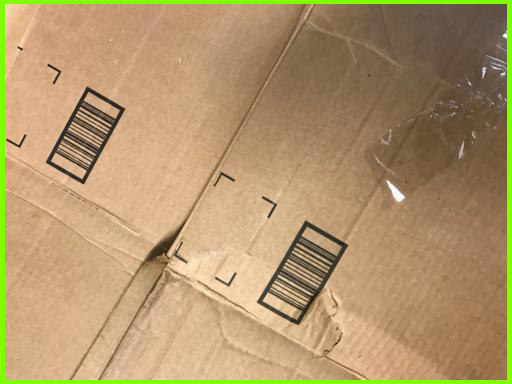

[0.9237     0.08288454 0.0753319  0.07070325 0.07057595 0.06460261
 0.0634309  0.06340557 0.06322639 0.05669885 0.05363347 0.05227262
 0.05176888 0.05033457 0.0502465  0.05016579 0.04809019 0.04800563
 0.04742904 0.0449437  0.04365175 0.04268849 0.04195767 0.04148972
 0.04060273 0.03933313 0.03908231 0.03858932 0.03849613 0.03813731
 0.03805345 0.03782789 0.03758883 0.03744714 0.03716567 0.03699993
 0.03661945 0.03657834 0.03471426 0.03429754 0.03384824 0.03381164
 0.03342973 0.03254553 0.03254366 0.03224165 0.03221612 0.03197612
 0.03181748 0.03161378 0.03127102 0.0311265  0.03111681 0.03085452
 0.03074464 0.03071859 0.03046995 0.03045173 0.03036395 0.03012814
 0.0299729  0.02934728 0.02929046 0.02919137 0.02899816 0.02871124
 0.02867492 0.0284521  0.02835191 0.02822684 0.02818322 0.02808201
 0.02791164 0.02783992 0.02783436 0.02765236 0.02759059 0.02666416
 0.02658172 0.02647712 0.02642363 0.02622862 0.02606757 0.02572379
 0.02564116 0.02555152 0.02546821 0.02526297 0.02492026 0.0241

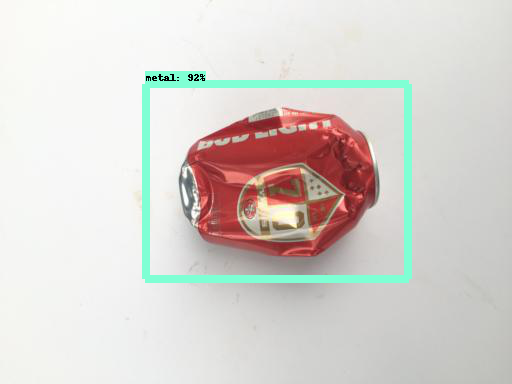

[0.9225395  0.13993487 0.13966717 0.12128399 0.11350382 0.11140548
 0.1111109  0.11092684 0.10777859 0.10767148 0.10395239 0.10325387
 0.1027192  0.10127253 0.10046774 0.09865738 0.09618586 0.09460095
 0.09382682 0.09328912 0.09064965 0.08954848 0.08829898 0.08816368
 0.08618732 0.08238341 0.08194122 0.07976048 0.07936203 0.07917952
 0.0775423  0.07753682 0.07553107 0.07509239 0.07453202 0.07431551
 0.07322696 0.07202005 0.07197392 0.07101435 0.07025378 0.06929076
 0.06888282 0.06875256 0.0675145  0.06720075 0.06672543 0.06611835
 0.06600174 0.06270071 0.06167866 0.06116503 0.05973652 0.05972886
 0.05966352 0.05939212 0.05888801 0.0587793  0.05857307 0.05846652
 0.05845045 0.05838776 0.05805332 0.05757276 0.05699769 0.05677104
 0.05672612 0.0552853  0.05513019 0.05374629 0.05368625 0.05325886
 0.05296817 0.05195464 0.05191283 0.05139071 0.0508962  0.05026815
 0.05024935 0.04991266 0.04964549 0.04955658 0.04931323 0.04872003
 0.04790386 0.04766392 0.04764635 0.04764115 0.04750358 0.0468

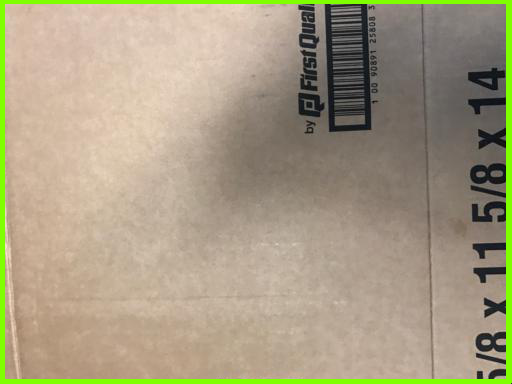

[0.9131305  0.13749096 0.11162501 0.0946084  0.09025142 0.08027749
 0.07924229 0.07917003 0.07517708 0.07361946 0.07345904 0.06725716
 0.0644922  0.06392229 0.06210867 0.06127685 0.05902822 0.05597323
 0.05476929 0.05465367 0.05169293 0.04932374 0.04925967 0.04840907
 0.04802533 0.04778649 0.04682545 0.04579153 0.04527419 0.04458761
 0.0436712  0.04366369 0.04243911 0.04217115 0.04194186 0.04156871
 0.04128805 0.04031451 0.04013315 0.03964565 0.03931225 0.03840207
 0.03834132 0.03775803 0.0370584  0.03630916 0.03617474 0.03576548
 0.03511422 0.03454443 0.03446632 0.03430223 0.03410731 0.03383538
 0.03375163 0.03366805 0.03285728 0.03277105 0.03220156 0.03199304
 0.03173173 0.03161015 0.03149156 0.03114477 0.03107593 0.03097132
 0.03082806 0.03069394 0.03060033 0.03043904 0.03010152 0.03002225
 0.03000689 0.02939471 0.02932861 0.02901051 0.02887318 0.02860338
 0.028503   0.02844148 0.02814932 0.02811617 0.0279926  0.02791272
 0.02773933 0.02757276 0.02756091 0.02721117 0.02719121 0.0270

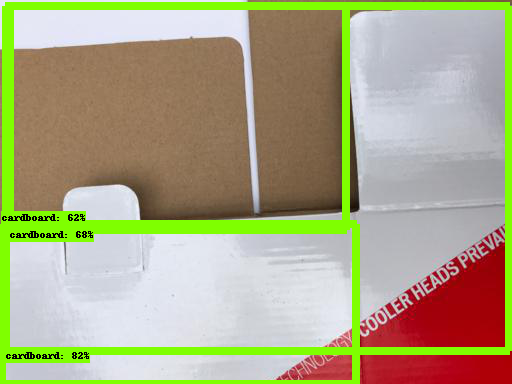

[0.8242514  0.67773193 0.6224504  0.41257712 0.34092042 0.25132862
 0.22619325 0.19327348 0.19188707 0.18509318 0.16357465 0.16029865
 0.1578704  0.14031214 0.13118389 0.12715977 0.12536986 0.11915558
 0.11844499 0.11445002 0.10460918 0.10021512 0.0953821  0.09423473
 0.09357185 0.09190818 0.09062484 0.0855708  0.08135027 0.08119188
 0.07868337 0.0783845  0.07641333 0.07601614 0.07516967 0.07435867
 0.07338838 0.07046409 0.06944884 0.06911976 0.06686006 0.06640023
 0.06545064 0.0652158  0.06477031 0.06471913 0.06402151 0.06392913
 0.06218363 0.06152029 0.06108693 0.06091326 0.06038687 0.0603297
 0.05987683 0.05906997 0.05793227 0.05772395 0.05716513 0.05682055
 0.05679237 0.05643055 0.05514501 0.05507027 0.0546674  0.05458593
 0.05417471 0.05402287 0.05271182 0.05253353 0.05208247 0.05201264
 0.05200852 0.0518568  0.05149823 0.05143833 0.05091118 0.05082685
 0.05074966 0.050657   0.0502576  0.04938982 0.0493348  0.04891787
 0.04840253 0.04833902 0.04799849 0.04783029 0.04771981 0.04735

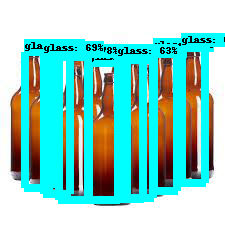

[0.7876711  0.78459847 0.76745975 0.71759874 0.6862652  0.66831905
 0.63375014 0.63305545 0.37650108 0.3193007  0.28462803 0.26517525
 0.2584559  0.2562771  0.24397187 0.23900355 0.23726483 0.22305565
 0.22038549 0.21797128 0.18377213 0.17898923 0.16988325 0.16863729
 0.16289407 0.15556233 0.14160153 0.13703324 0.13452403 0.13260655
 0.13112685 0.1285341  0.12800425 0.12142699 0.12019518 0.11854564
 0.11810908 0.11506785 0.11492322 0.11298552 0.11223465 0.10170323
 0.10107571 0.09959364 0.09793068 0.09530243 0.09218884 0.09193391
 0.0901229  0.08914445 0.08774751 0.08635947 0.08595137 0.08547115
 0.08393332 0.08382203 0.08305935 0.08261248 0.08214858 0.0804664
 0.08010917 0.07921992 0.07901512 0.07523769 0.0747207  0.07439948
 0.07356168 0.07353996 0.07287572 0.07281713 0.0723654  0.07106284
 0.06964873 0.06950834 0.06924468 0.06861948 0.06819624 0.06726924
 0.06690982 0.06611546 0.06558271 0.06556678 0.06520247 0.06506886
 0.0650019  0.06457576 0.06431776 0.0630429  0.06264021 0.06237

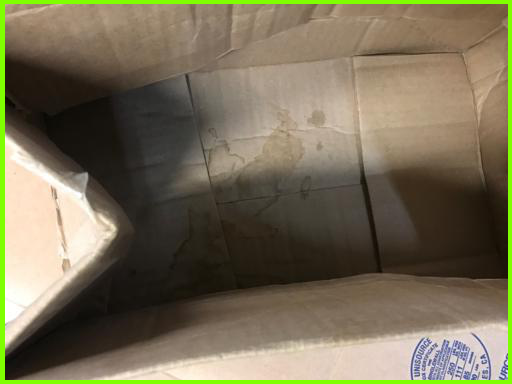

[0.9230832  0.13658588 0.09322213 0.08119648 0.07805568 0.07584187
 0.07202739 0.07017174 0.06897492 0.06610081 0.06593125 0.06054018
 0.05557796 0.04775997 0.04675585 0.04582141 0.04370676 0.04359521
 0.0430323  0.04000673 0.03849296 0.03774957 0.0356036  0.03451766
 0.03352646 0.03351751 0.03318607 0.03276777 0.03226604 0.0315042
 0.03071859 0.03057504 0.03027547 0.0297444  0.02951996 0.02927449
 0.02919838 0.02918078 0.0290867  0.02902984 0.02897899 0.028856
 0.02879353 0.02848987 0.02839663 0.02832008 0.0283129  0.02762864
 0.02751889 0.02723583 0.02709363 0.0269261  0.02683746 0.02680589
 0.02671849 0.02656706 0.02572818 0.025672   0.02525641 0.02525025
 0.02522997 0.02506799 0.0250338  0.02497175 0.02495826 0.02489072
 0.02474344 0.02473579 0.02465844 0.02456173 0.0244039  0.02439927
 0.02428139 0.0242317  0.02412519 0.02374701 0.02358113 0.02347433
 0.02343048 0.02339893 0.023355   0.02317975 0.02291491 0.02290882
 0.02285665 0.02280689 0.02273999 0.02272236 0.02263059 0.0224949

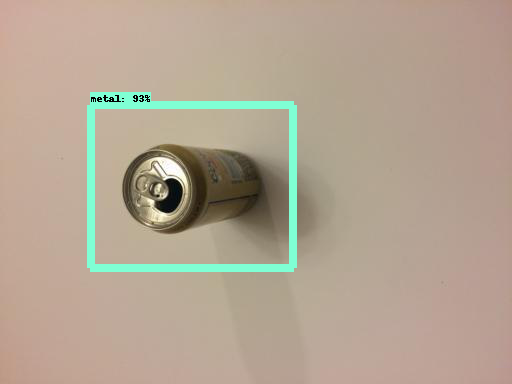

[0.92971826 0.16334528 0.15933762 0.13900983 0.13793471 0.11747956
 0.10858558 0.10729905 0.10295439 0.10101043 0.09907852 0.09838068
 0.09740113 0.09556539 0.09117373 0.08759924 0.08736514 0.08667409
 0.08534458 0.08379162 0.0827373  0.0816358  0.08142537 0.080759
 0.07823452 0.07738413 0.07707995 0.07682193 0.07547736 0.07544471
 0.07253233 0.07242273 0.07237445 0.07217173 0.07106519 0.07037611
 0.06865161 0.06840919 0.06820811 0.06811152 0.0656478  0.06555063
 0.06536064 0.06472695 0.06442094 0.06415273 0.06414903 0.0641234
 0.0638034  0.06376516 0.06266288 0.0624227  0.06208987 0.06191471
 0.06164214 0.06123247 0.06113611 0.06094072 0.06068327 0.05978939
 0.05978365 0.05953169 0.05935931 0.05915644 0.0586936  0.05805893
 0.05797205 0.05792959 0.05787456 0.05769121 0.05748909 0.05693566
 0.05654654 0.05650065 0.05548782 0.05532468 0.05496158 0.0547504
 0.05420238 0.05402781 0.05374263 0.05353973 0.05345282 0.05336815
 0.05234364 0.05207042 0.05189124 0.05164928 0.05108539 0.05089362

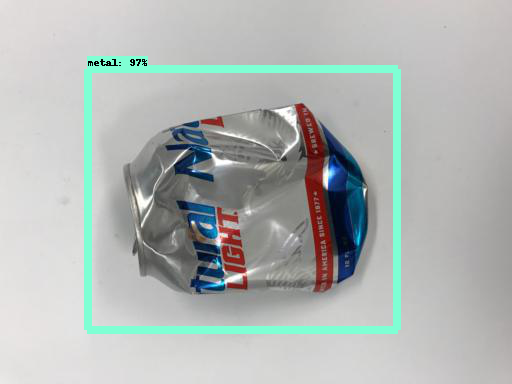

[0.9736371  0.24995326 0.11268086 0.10869972 0.10429505 0.09874798
 0.0956186  0.07261755 0.06638622 0.06266493 0.06153774 0.06088591
 0.05643931 0.05523552 0.05342938 0.05335217 0.05117147 0.05002744
 0.04959929 0.04937572 0.04887232 0.04851286 0.04841207 0.04803475
 0.0480184  0.04753864 0.04748017 0.04745143 0.04673321 0.04589718
 0.04533291 0.04503903 0.04464731 0.04458646 0.04388805 0.04373937
 0.04313109 0.04276356 0.04275806 0.04250795 0.04239874 0.04218146
 0.04173717 0.04153088 0.04143586 0.04120634 0.04021669 0.04015411
 0.03940276 0.03916532 0.03914948 0.03880611 0.03866972 0.0385447
 0.0381503  0.03795883 0.03739207 0.03699005 0.03666519 0.03651053
 0.03624865 0.03620046 0.03574438 0.03549144 0.03528176 0.03510378
 0.0350133  0.03497132 0.03491464 0.03478883 0.03475106 0.03444865
 0.03429036 0.03420015 0.03415379 0.03408198 0.03404914 0.03379584
 0.03368269 0.03355596 0.03338563 0.03322168 0.03307273 0.03300256
 0.0329625  0.03289132 0.03256258 0.03245965 0.0321546  0.03205

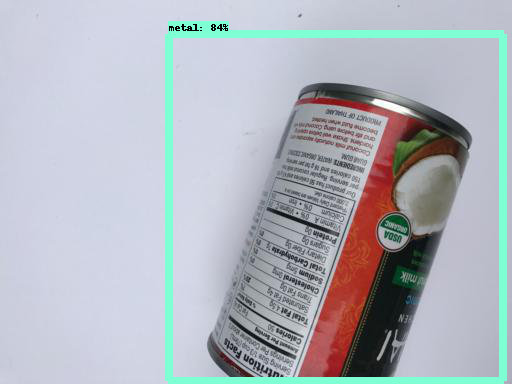

[0.8399657  0.38296428 0.11532782 0.10086831 0.08926922 0.0888575
 0.08287229 0.0793988  0.07849199 0.07779148 0.07539888 0.0692245
 0.0668457  0.06586348 0.06372095 0.06340801 0.06256471 0.06200279
 0.06158414 0.0597966  0.05730212 0.05658628 0.05493552 0.05441291
 0.05402915 0.05347702 0.05304737 0.05291072 0.05209425 0.05198605
 0.05188734 0.0513574  0.05064632 0.05055963 0.04831076 0.04792354
 0.04708817 0.04673767 0.04615691 0.04523303 0.04461675 0.04335112
 0.04325841 0.04301582 0.04246261 0.0423236  0.04143722 0.04074454
 0.04022285 0.03985334 0.0398255  0.03860637 0.03787504 0.03783509
 0.03761972 0.03735173 0.03708819 0.03701005 0.03690638 0.03666716
 0.03666277 0.03616474 0.03613398 0.03609522 0.03595231 0.03593875
 0.03590279 0.03550824 0.03523102 0.035072   0.03501582 0.03498519
 0.03482319 0.03469423 0.03457149 0.03399619 0.03388329 0.0337733
 0.03348628 0.03327857 0.03254    0.03253898 0.03249263 0.03234306
 0.0320962  0.03172016 0.03169017 0.03132976 0.03112164 0.0309051

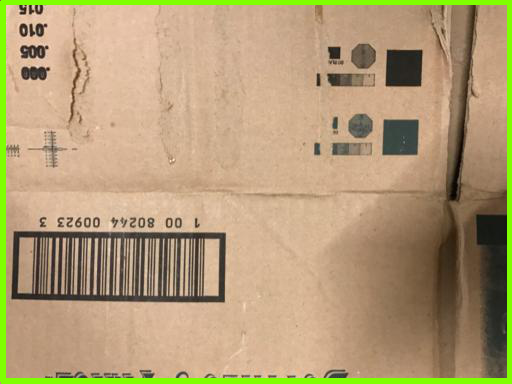

[0.92079026 0.3334764  0.2385979  0.14673026 0.13810024 0.11272249
 0.09368202 0.09315918 0.09037239 0.08703349 0.08670375 0.08391897
 0.0812115  0.07815702 0.07611916 0.07564272 0.07504518 0.072391
 0.07184064 0.06884874 0.06239171 0.05813302 0.05655479 0.05618464
 0.05340873 0.05297841 0.05247033 0.05092268 0.05021304 0.04957502
 0.04935947 0.04907101 0.0489553  0.04855143 0.04822322 0.04669115
 0.04644008 0.04630445 0.04495466 0.04482775 0.04448351 0.04408035
 0.0434709  0.04330386 0.04326745 0.04311398 0.04294172 0.04283443
 0.04214399 0.0411954  0.04076594 0.04065503 0.04019659 0.04014244
 0.04007086 0.03994076 0.03974587 0.03950568 0.03932313 0.03912955
 0.0391164  0.03853888 0.03813396 0.0380725  0.0380716  0.03802671
 0.03794741 0.03776661 0.03732521 0.03721315 0.03721301 0.03708428
 0.03688468 0.03668062 0.03662973 0.03657784 0.03611214 0.03597229
 0.03582412 0.03544949 0.03540589 0.03507006 0.03502476 0.03492778
 0.03429066 0.0342693  0.03410167 0.03407744 0.03398301 0.033967

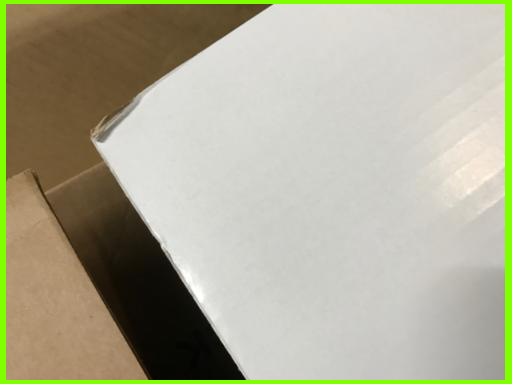

[0.8941053  0.23795213 0.2233374  0.17661928 0.13418499 0.13253665
 0.12840226 0.11034002 0.10559049 0.10280593 0.09764403 0.09326104
 0.08986796 0.08771143 0.08661319 0.07919297 0.07896976 0.07808029
 0.07344355 0.07309476 0.07195321 0.07137454 0.07006986 0.06957565
 0.06726204 0.06485873 0.06481066 0.06294431 0.06187117 0.06114775
 0.0610722  0.06091388 0.06019995 0.05985174 0.05818627 0.05751653
 0.05713479 0.05647806 0.05588543 0.05415661 0.05389898 0.05378222
 0.05375018 0.05204759 0.05046912 0.0504075  0.04955747 0.04953936
 0.04917321 0.04839987 0.04690892 0.04557107 0.04530869 0.04526155
 0.04380449 0.04274213 0.0425162  0.0423084  0.04185294 0.04165088
 0.04117806 0.04116838 0.0411482  0.04105811 0.04099288 0.04043254
 0.04041209 0.04018229 0.03963607 0.03922382 0.03917354 0.03856321
 0.03847096 0.03842697 0.03824646 0.03739396 0.03728305 0.03720041
 0.03713455 0.03655798 0.03650652 0.03636392 0.03619805 0.03617568
 0.03602599 0.0359077  0.03584431 0.03580917 0.03566292 0.0355

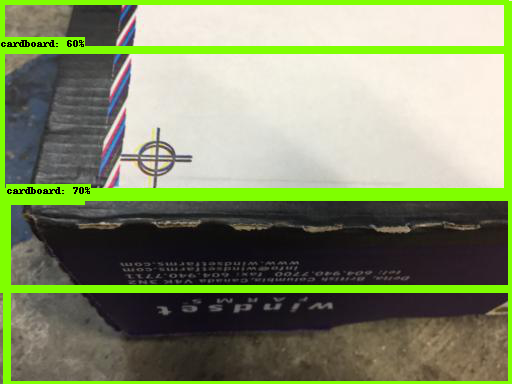

[0.75896794 0.69950444 0.6047443  0.41706374 0.3710113  0.16608338
 0.15635878 0.13916297 0.11696941 0.09580014 0.09495677 0.09262468
 0.09031749 0.08317323 0.082229   0.08117262 0.07945521 0.07941381
 0.07666157 0.07406733 0.07187154 0.07089379 0.0688536  0.06865034
 0.06779386 0.06635645 0.06562927 0.06502618 0.06395808 0.06327806
 0.06264275 0.06263546 0.06049686 0.05972281 0.05900769 0.05650167
 0.05649829 0.05328311 0.05224969 0.05108114 0.05043698 0.05028565
 0.04775773 0.04743823 0.04719277 0.046546   0.04632445 0.04587632
 0.04481569 0.04423857 0.04411485 0.0440818  0.044039   0.04403492
 0.04393044 0.04353451 0.04314329 0.04251894 0.04248027 0.04141511
 0.04101636 0.0406341  0.04060154 0.04055924 0.0394352  0.0386352
 0.03826324 0.03783831 0.03735416 0.037054   0.0369941  0.03656029
 0.03642452 0.03551117 0.03548875 0.03531554 0.03516556 0.0351043
 0.03504015 0.03494421 0.03488572 0.0348296  0.0348262  0.03457963
 0.03418206 0.03412509 0.03366186 0.0335176  0.03327876 0.033267

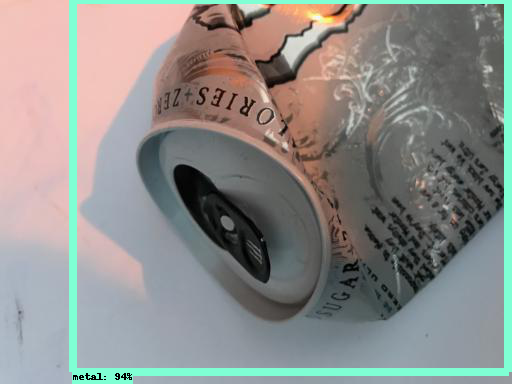

[0.9421427  0.10425023 0.09317992 0.08094249 0.08000451 0.07918682
 0.07467098 0.07329928 0.07077261 0.0654677  0.06442508 0.06255582
 0.05730082 0.05659531 0.055717   0.0552269  0.05484213 0.05423564
 0.05361773 0.04902722 0.04356007 0.04315455 0.04247331 0.04195754
 0.04126853 0.0408321  0.04067588 0.03936876 0.03793165 0.03787969
 0.03764707 0.03739392 0.03714301 0.03712063 0.0369843  0.03631706
 0.03608976 0.03559856 0.03550972 0.03461715 0.03455611 0.03403997
 0.03362866 0.03354098 0.03304252 0.03274437 0.03269872 0.03253397
 0.03227988 0.03193229 0.0317838  0.03176868 0.03168176 0.03096978
 0.03080013 0.03040737 0.03025404 0.03015945 0.03006848 0.02992106
 0.02958836 0.02953632 0.02949288 0.02942785 0.02928844 0.02928542
 0.02921172 0.02897819 0.02881398 0.02865167 0.02864779 0.02856361
 0.02845997 0.02841677 0.02833764 0.02817886 0.02800395 0.02760809
 0.02754164 0.02723171 0.02702829 0.02673588 0.02669033 0.02658673
 0.02626856 0.02588219 0.02570851 0.02567482 0.02558123 0.0255

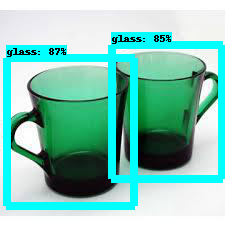

[0.8712535  0.8539995  0.46597475 0.22371072 0.19312048 0.18928574
 0.1877176  0.17628321 0.17622665 0.17337328 0.16849437 0.15847768
 0.15832168 0.15216805 0.14455362 0.13706774 0.13704146 0.1342836
 0.12974337 0.12805389 0.12584785 0.12319256 0.12201986 0.12163865
 0.12115044 0.1206825  0.11840454 0.11616707 0.11592424 0.11134472
 0.11133789 0.11106351 0.10882591 0.10877883 0.10856833 0.10832049
 0.10806606 0.10719335 0.10674576 0.10645355 0.10433552 0.10356685
 0.1019637  0.10157513 0.10096467 0.1001479  0.09952117 0.09896541
 0.09868599 0.09847677 0.09757509 0.09640095 0.09456186 0.09433588
 0.09333263 0.09274819 0.09253027 0.09122942 0.08984522 0.08675858
 0.08605083 0.0859977  0.08530558 0.08513111 0.08466731 0.08364472
 0.08302373 0.08274469 0.08148477 0.07960761 0.07880902 0.07841147
 0.07819515 0.077943   0.07746307 0.07704873 0.07677528 0.0761905
 0.07509789 0.07437266 0.07398506 0.07383617 0.07370916 0.07341187
 0.07338779 0.07281262 0.07227452 0.07214175 0.07121531 0.070943

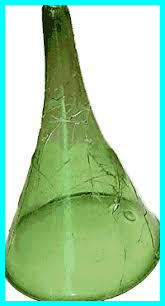

[0.92045885 0.10287397 0.10202471 0.09836033 0.09644901 0.09297252
 0.09288699 0.09007408 0.08454297 0.08183861 0.08094281 0.08054722
 0.07972445 0.07625922 0.07312656 0.07260244 0.06945653 0.06801569
 0.06596409 0.0653431  0.0634791  0.06308753 0.0610919  0.06028615
 0.05977954 0.05975418 0.05961265 0.05931963 0.05801606 0.05779313
 0.05753541 0.05738756 0.0573693  0.05699362 0.05636727 0.05563357
 0.05497409 0.05291779 0.05170276 0.05091365 0.05078496 0.05065095
 0.04893901 0.04775225 0.04764346 0.04750787 0.04692454 0.04625655
 0.04620426 0.04584476 0.04568989 0.04565743 0.0439668  0.04286037
 0.04281181 0.04278758 0.04265721 0.04257629 0.04219817 0.0415124
 0.04146414 0.04109349 0.04069747 0.04040395 0.04014825 0.04005465
 0.03936754 0.03929297 0.03920998 0.0390408  0.0390158  0.03859799
 0.0379364  0.0379311  0.03730644 0.03672726 0.03661992 0.0363743
 0.03637034 0.03629583 0.03624206 0.03615862 0.0358688  0.03541277
 0.03524116 0.03520698 0.03464413 0.03459417 0.03442462 0.034423

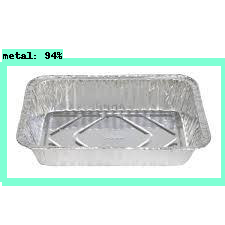

[0.9393721  0.23452856 0.20728925 0.20697469 0.19824491 0.14561157
 0.1354869  0.12946574 0.12879103 0.12701452 0.12420467 0.12365757
 0.12352572 0.11761119 0.11621432 0.11608435 0.11208028 0.10176262
 0.10098446 0.09906624 0.09839762 0.09757794 0.0975398  0.09583294
 0.09541546 0.0950911  0.0949282  0.0942767  0.0939134  0.09316149
 0.0923924  0.09116541 0.08981998 0.08981756 0.08962055 0.0874685
 0.08728091 0.0871598  0.08448043 0.08208352 0.0818482  0.08173545
 0.08042704 0.07948957 0.07945978 0.07852475 0.07799529 0.07682382
 0.07680883 0.07658005 0.07494541 0.07481584 0.07434583 0.07384657
 0.07287491 0.07249223 0.07246453 0.07209241 0.07092707 0.0691783
 0.06879035 0.06850258 0.06697044 0.0667493  0.06661526 0.06657141
 0.06618322 0.06603225 0.06588676 0.06580877 0.06555154 0.06544448
 0.06518778 0.06496318 0.06381131 0.06291433 0.06210345 0.06193123
 0.06133008 0.061296   0.06045959 0.06022473 0.06022355 0.05933874
 0.05860123 0.0584829  0.05769553 0.05757731 0.05732189 0.057226

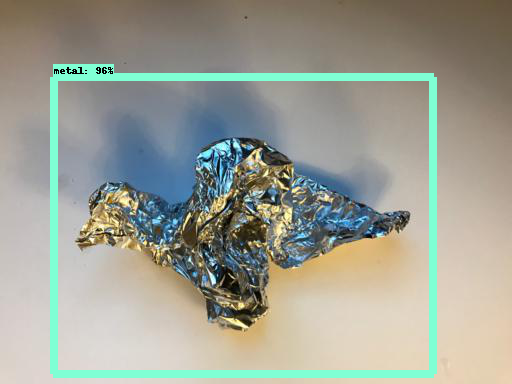

[0.9556939  0.14366965 0.1406492  0.12718266 0.10820379 0.10137707
 0.08767831 0.08587073 0.07939105 0.07031003 0.06748242 0.06617182
 0.06362562 0.06079115 0.06043648 0.05646908 0.05632493 0.05597063
 0.05551963 0.05444332 0.05361384 0.05342609 0.05138399 0.05068454
 0.05056312 0.05054285 0.05025079 0.04977715 0.04950655 0.04874872
 0.0485645  0.04828684 0.04811446 0.04712586 0.04697507 0.04696393
 0.04511977 0.04508421 0.04493872 0.04453257 0.04449655 0.04382884
 0.04372061 0.04343024 0.0429092  0.04248675 0.04219122 0.04081639
 0.04023163 0.04007398 0.0400168  0.03926401 0.03882506 0.03878487
 0.0384042  0.03840333 0.03830324 0.03735584 0.03730075 0.03696077
 0.03688498 0.03640178 0.03639729 0.03623802 0.03617562 0.03597901
 0.03597452 0.03597332 0.03587306 0.03581811 0.03565301 0.03526951
 0.03495087 0.03480856 0.0346473  0.03450758 0.03446181 0.03445949
 0.03443222 0.0344152  0.03427059 0.03418507 0.03417675 0.03417141
 0.03411129 0.03395609 0.03394583 0.0339337  0.03392933 0.0336

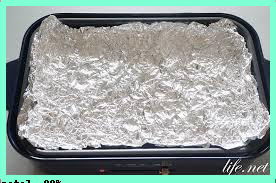

[0.90303606 0.17339252 0.11929087 0.11634329 0.11534573 0.09399531
 0.09390213 0.09079625 0.08848639 0.08164562 0.07833721 0.07831001
 0.07787617 0.07503511 0.0690493  0.06892484 0.06785991 0.06711254
 0.06370939 0.06031639 0.05965261 0.05929804 0.0588754  0.05718536
 0.05610357 0.05589923 0.05276491 0.0520728  0.05171081 0.05124944
 0.05081456 0.0436457  0.04230421 0.04165431 0.0411623  0.04086384
 0.04035853 0.0399338  0.03993012 0.0368779  0.03606922 0.03573744
 0.03558799 0.03532123 0.0351724  0.0347348  0.03466084 0.03420015
 0.03377184 0.03376501 0.0333133  0.03331178 0.03301914 0.03287011
 0.03252348 0.03238589 0.03224617 0.03203201 0.0319643  0.03187327
 0.03170557 0.03169489 0.03162157 0.03153136 0.03149268 0.03143672
 0.03073093 0.030645   0.02974285 0.02970356 0.02952735 0.02932987
 0.0292488  0.02918752 0.02913802 0.02913169 0.02898986 0.02894945
 0.02873776 0.02855982 0.02854737 0.02852665 0.02841127 0.02838762
 0.02831851 0.02827396 0.02796097 0.02793401 0.02771173 0.0272

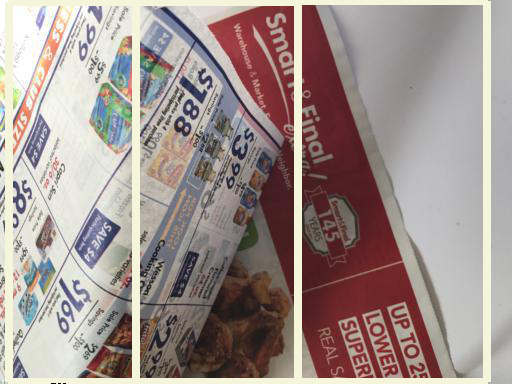

[0.8877238  0.7047826  0.2444789  0.15239187 0.08588682 0.07990909
 0.07852687 0.07785155 0.0767931  0.07212077 0.07202719 0.06883133
 0.06874411 0.06830429 0.06688482 0.06264967 0.0618983  0.06068196
 0.06055458 0.057086   0.05649293 0.05533742 0.05385234 0.0530262
 0.05290556 0.05263659 0.05256364 0.05208439 0.05204117 0.05117127
 0.04934005 0.04910376 0.04866606 0.04701686 0.0470101  0.04626271
 0.04591041 0.04584188 0.04390943 0.04367232 0.04325446 0.04319554
 0.04308315 0.04225992 0.04107647 0.04046429 0.04019361 0.03940662
 0.0393976  0.03923143 0.03922548 0.03919961 0.03910789 0.03893687
 0.03838267 0.03774093 0.03758509 0.03737321 0.03727088 0.03712862
 0.03704669 0.03700466 0.03699082 0.03673543 0.03673128 0.03669389
 0.03645666 0.03588744 0.03574245 0.03521433 0.03507634 0.03500601
 0.03459704 0.03452752 0.03389677 0.03365623 0.03364968 0.03333111
 0.03319735 0.033187   0.0331795  0.03308601 0.03307779 0.0327094
 0.03254009 0.03234154 0.03221603 0.03215198 0.0321133  0.031813

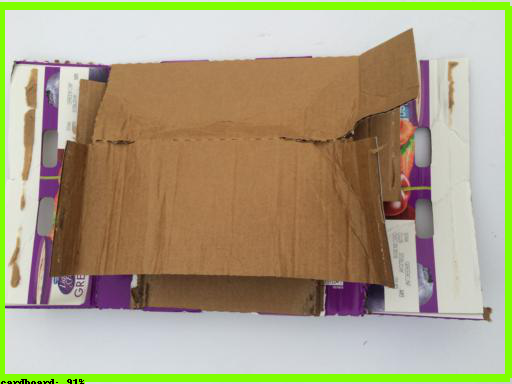

[0.912792   0.2710055  0.11218601 0.11190359 0.09738129 0.09532647
 0.09487967 0.09226952 0.08439819 0.08233303 0.08008909 0.07956968
 0.07438478 0.0709762  0.07094716 0.07084486 0.07075851 0.07067699
 0.07011521 0.06891064 0.06879618 0.06697948 0.06580759 0.06404731
 0.06154101 0.06103952 0.05976197 0.05931967 0.05700286 0.05625681
 0.05426413 0.05402467 0.05388133 0.05366427 0.05365247 0.0528388
 0.0521703  0.05198898 0.05109335 0.05050942 0.05021585 0.04835622
 0.04834244 0.04787248 0.04766308 0.04642302 0.04596326 0.04594995
 0.04554883 0.04535318 0.04534123 0.04520067 0.04327351 0.04307236
 0.04299706 0.04291682 0.04289577 0.04287631 0.0427393  0.04261316
 0.04254629 0.04159521 0.04155862 0.04131934 0.04083355 0.04076028
 0.04032898 0.0402631  0.03981236 0.03923153 0.03906604 0.03885406
 0.03857802 0.03809652 0.03805509 0.03803654 0.03802028 0.03791307
 0.03771674 0.03768276 0.03713798 0.03696211 0.03645765 0.03625583
 0.03612261 0.0358818  0.0358782  0.0353591  0.0351714  0.03510

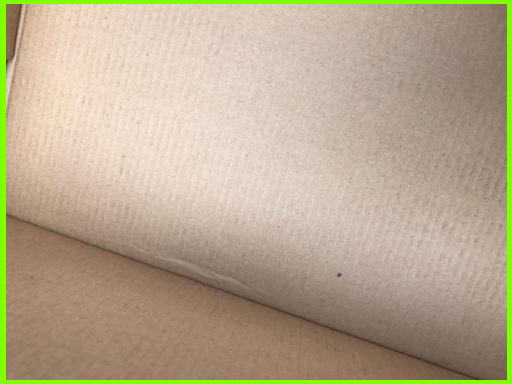

[0.9186256  0.08374556 0.07943996 0.077552   0.07235171 0.06819838
 0.06768999 0.06436908 0.06351881 0.06264256 0.06115752 0.06057221
 0.0596134  0.05959355 0.05891882 0.05765321 0.05514297 0.05180326
 0.05153893 0.0457238  0.0426954  0.04082834 0.03836961 0.03798679
 0.03717217 0.03650104 0.03639778 0.03590706 0.03507298 0.03459948
 0.03456637 0.03413409 0.03377122 0.03356966 0.03335282 0.03234247
 0.03159177 0.03156094 0.03094409 0.03086642 0.0308497  0.03063489
 0.02896643 0.02895145 0.0287144  0.02833449 0.0280267  0.02798318
 0.02793467 0.02789464 0.02750246 0.02656749 0.0264004  0.02634371
 0.0262507  0.02617498 0.02612466 0.02608796 0.02587408 0.0256708
 0.02550346 0.0253573  0.02525964 0.02492354 0.02456675 0.02434262
 0.02432089 0.02416779 0.02409341 0.02355231 0.02304885 0.02296875
 0.02285336 0.02283847 0.02283126 0.02269659 0.0225825  0.02249907
 0.02245407 0.02242612 0.02237536 0.02236692 0.02230783 0.0221631
 0.02211235 0.02193461 0.02182262 0.02151136 0.02138711 0.021301

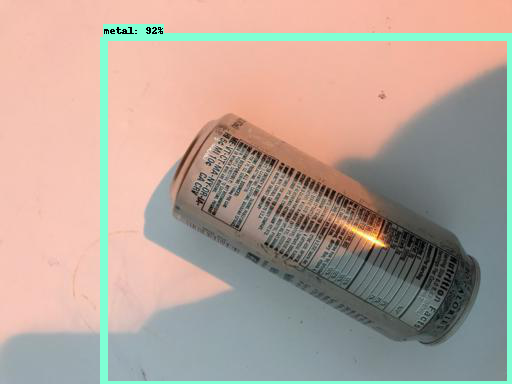

[0.9200433  0.12645133 0.12234683 0.11912014 0.08998856 0.08796806
 0.08786012 0.07452456 0.07324    0.07154591 0.07113819 0.06829053
 0.06731398 0.06597218 0.06583066 0.06413297 0.06306586 0.06043163
 0.05969479 0.05530135 0.05141328 0.05115276 0.04948316 0.04891509
 0.04779107 0.04656826 0.04656824 0.04618645 0.04544155 0.04529328
 0.04514044 0.0449555  0.0446703  0.04442109 0.04415013 0.0436496
 0.04259115 0.0424256  0.04237423 0.0423406  0.04179097 0.04079677
 0.04030793 0.04028404 0.03993648 0.03917905 0.03898501 0.03879641
 0.03739069 0.03730459 0.03684865 0.03672645 0.03671297 0.03650679
 0.03629569 0.03622086 0.036063   0.03551363 0.03535609 0.03477901
 0.03459237 0.03416732 0.03402504 0.03386189 0.03377699 0.03351752
 0.03325558 0.03309112 0.03303938 0.03282419 0.03270699 0.03251108
 0.03213064 0.03201831 0.03192236 0.03170769 0.03157402 0.03135415
 0.0313027  0.03091564 0.03088428 0.03085857 0.03084462 0.03069938
 0.03061642 0.030378   0.03018597 0.03016117 0.02997909 0.02996

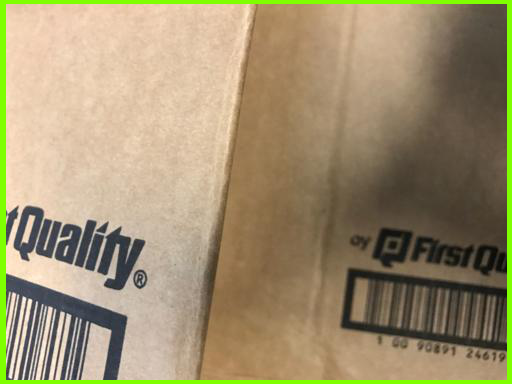

[0.9233191  0.07914492 0.07169046 0.07032822 0.0679072  0.06333231
 0.06049321 0.0597068  0.05793625 0.05639138 0.05041122 0.04944864
 0.04871083 0.04540505 0.04377255 0.0425159  0.04170421 0.04114948
 0.03998993 0.0385406  0.03846766 0.03839941 0.03818244 0.03797174
 0.03784432 0.03731315 0.03713136 0.03625357 0.03560365 0.03546353
 0.03489479 0.03487966 0.03431437 0.03413687 0.03411669 0.03391314
 0.03344486 0.0330266  0.03273628 0.03180071 0.03163896 0.03108782
 0.03008331 0.02973071 0.02956869 0.02928985 0.02917929 0.02915449
 0.02862729 0.02861519 0.02856805 0.02843749 0.02791652 0.02753358
 0.02730727 0.02685925 0.02662458 0.02650321 0.02620737 0.02619769
 0.02614556 0.02584472 0.02569734 0.02560187 0.02546764 0.02513913
 0.02497063 0.02495179 0.02461772 0.02427338 0.02417961 0.02415161
 0.02334652 0.02327137 0.02316982 0.02316234 0.02309644 0.02290061
 0.02282502 0.02268083 0.02263776 0.02262827 0.02259646 0.02242505
 0.0223403  0.02232045 0.02227482 0.02198721 0.02196442 0.0219

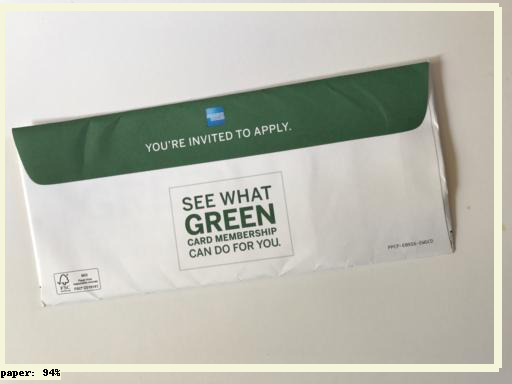

[0.9402902  0.13535294 0.12878154 0.11622483 0.11083562 0.10927446
 0.10338362 0.09865874 0.09459917 0.09158599 0.08936054 0.08172675
 0.08133387 0.07936186 0.07741742 0.07671259 0.07535755 0.07514402
 0.0737218  0.07309694 0.0693747  0.06919573 0.06912471 0.06867458
 0.06640727 0.06610259 0.06524868 0.06478012 0.06351073 0.06337653
 0.06232247 0.06166588 0.06054474 0.05999413 0.05882519 0.05858289
 0.05822126 0.05782644 0.05674348 0.05655273 0.0555038  0.05526687
 0.05488028 0.05418355 0.05306049 0.05304666 0.05284812 0.05173815
 0.05121199 0.05090896 0.05029242 0.05000135 0.04980801 0.04901325
 0.04892656 0.04879279 0.04728502 0.04695003 0.04665129 0.04663925
 0.04637023 0.04526598 0.04497122 0.04478404 0.04465352 0.04453161
 0.04399409 0.04377556 0.0434503  0.04293236 0.04161933 0.04145809
 0.04133261 0.04059891 0.04059278 0.04058724 0.04052664 0.04034829
 0.04001989 0.039557   0.03858519 0.03840207 0.03813833 0.03791724
 0.03759847 0.03742624 0.03714826 0.03701188 0.03696023 0.0365

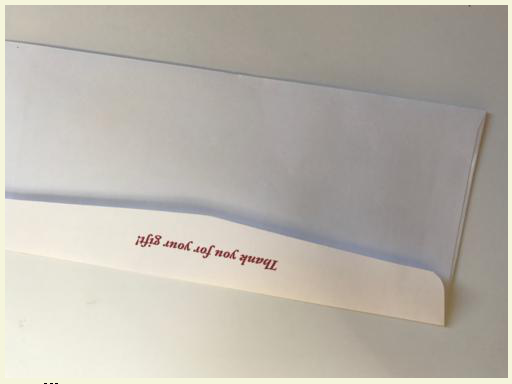

[0.9337163  0.10012929 0.09545539 0.09229518 0.08424029 0.07940443
 0.0751671  0.07421039 0.0741419  0.07035238 0.06970421 0.06701151
 0.06580549 0.06473866 0.06439607 0.06105676 0.05982389 0.05929143
 0.05830243 0.05709812 0.05709783 0.05540271 0.0545305  0.05379814
 0.05219032 0.05181617 0.05177826 0.05174513 0.05114842 0.04952434
 0.04920465 0.04890911 0.04858745 0.04691997 0.04621959 0.04557115
 0.04516742 0.04471511 0.04422379 0.04392177 0.04329959 0.0430734
 0.04268218 0.04231483 0.04176378 0.04088215 0.04061996 0.04008164
 0.03973945 0.03966241 0.03955624 0.03923287 0.03902619 0.03902064
 0.03898593 0.03828173 0.03822492 0.03798258 0.03797325 0.03774384
 0.03757809 0.03750136 0.03747514 0.03733902 0.0373168  0.03683008
 0.03618015 0.03559941 0.03537159 0.03536035 0.03463782 0.03428818
 0.03416525 0.03402485 0.03365582 0.03356728 0.03355323 0.03353876
 0.03327065 0.03324598 0.0329817  0.03284616 0.03281304 0.03279929
 0.03261051 0.03238404 0.03237251 0.03231435 0.03214499 0.03198

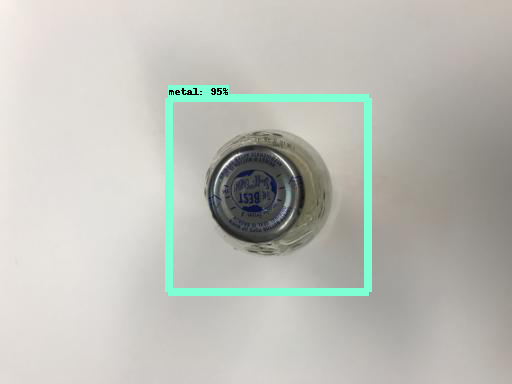

[0.9533452  0.10700241 0.10588269 0.09761252 0.0955082  0.08989356
 0.08843406 0.08061119 0.07856362 0.07646608 0.07422282 0.0740416
 0.07395119 0.07193571 0.07099265 0.07090423 0.07070736 0.06691961
 0.06427222 0.0630011  0.06199459 0.06195625 0.06134656 0.06116826
 0.06112912 0.06018657 0.05981216 0.05713791 0.05451432 0.05372187
 0.05301463 0.05280416 0.05162309 0.05153585 0.05152703 0.05090611
 0.05071079 0.05024749 0.05024543 0.04953131 0.04952744 0.04947595
 0.04931056 0.04884245 0.04869799 0.04854562 0.04852629 0.04802408
 0.04766259 0.04759797 0.04680979 0.04662505 0.04614222 0.04581923
 0.04578238 0.04464715 0.0443994  0.04403748 0.04364678 0.04304596
 0.042986   0.04280409 0.04268191 0.0419858  0.04139499 0.04125937
 0.04100044 0.0407268  0.04059998 0.0405362  0.04030036 0.04003872
 0.03999185 0.03921686 0.03907113 0.03897091 0.03887499 0.03884034
 0.03875748 0.03856435 0.03845164 0.03842993 0.03840365 0.0383217
 0.03807852 0.03738741 0.0373082  0.03698016 0.0368744  0.036831

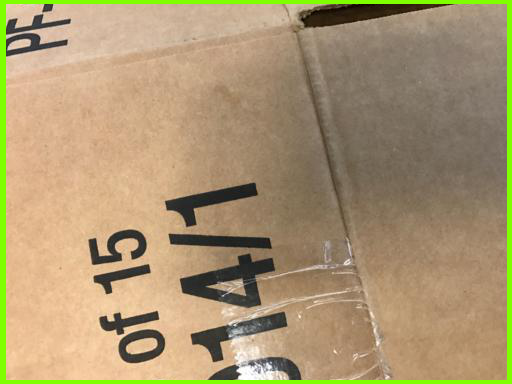

[0.92048365 0.07943549 0.07869083 0.07800458 0.07409981 0.07384981
 0.06741282 0.06301137 0.06124909 0.06061527 0.06058652 0.05936216
 0.05722049 0.05666573 0.05256989 0.05231864 0.05166995 0.04838865
 0.04625749 0.04600865 0.04455619 0.04255117 0.04252282 0.04194281
 0.04164915 0.04077187 0.0405017  0.03956139 0.03904896 0.03781078
 0.03778381 0.03755211 0.03697527 0.03656454 0.03638661 0.03610548
 0.03512055 0.03496267 0.03475557 0.03459454 0.03431029 0.03401921
 0.03395324 0.03384347 0.03380071 0.03348913 0.03344739 0.03313402
 0.03301967 0.03298793 0.03286742 0.03246703 0.03196914 0.03182577
 0.03178193 0.03098395 0.03094988 0.03066497 0.03053724 0.02989512
 0.02977102 0.02974677 0.02933807 0.02873805 0.02849165 0.02795134
 0.02789549 0.02775165 0.02735423 0.02729697 0.02675863 0.02626783
 0.02590397 0.02589597 0.0256281  0.02518083 0.02495503 0.02489691
 0.02488162 0.02467784 0.02451552 0.02432261 0.02395964 0.02384652
 0.02379536 0.02378928 0.02370516 0.02366692 0.02344632 0.0234

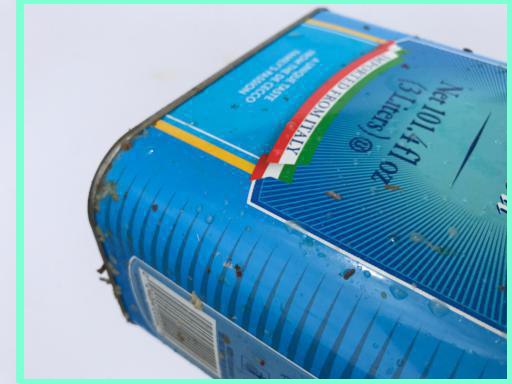

[0.9460109  0.09257634 0.08111605 0.07347685 0.07262901 0.07192049
 0.06172182 0.05752745 0.05469626 0.05388887 0.04374374 0.04356148
 0.04243203 0.04155337 0.04141365 0.04101744 0.0403615  0.04014983
 0.03993751 0.03740916 0.03661746 0.03626024 0.03588837 0.0357836
 0.03564215 0.03517864 0.03508462 0.03508455 0.03502644 0.03469729
 0.03435801 0.03374486 0.03364863 0.03345804 0.03341054 0.0332475
 0.03280161 0.03167014 0.03144182 0.03139826 0.0313825  0.03119711
 0.03118007 0.0310601  0.03105284 0.03084601 0.03034161 0.03019382
 0.03006454 0.02951479 0.02911383 0.02893365 0.02846871 0.02811726
 0.02799574 0.02791879 0.02786812 0.02775856 0.02768328 0.02736676
 0.02720727 0.02713497 0.02700043 0.02678336 0.02675702 0.02670284
 0.02658301 0.02640334 0.02618078 0.02615925 0.02611889 0.02589942
 0.02576666 0.02576243 0.0257443  0.02571991 0.02553244 0.02543404
 0.02514994 0.02508065 0.02504202 0.02482392 0.0247526  0.02473965
 0.02466994 0.02454636 0.0244803  0.02442526 0.02440936 0.024338

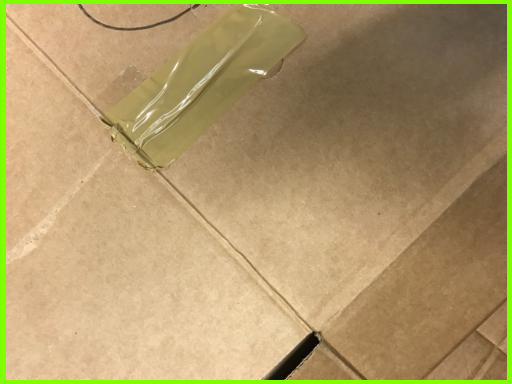

[0.91975206 0.07821357 0.07213406 0.0707183  0.06858697 0.06325696
 0.06246276 0.06204802 0.06180456 0.05987437 0.058527   0.0581376
 0.05304126 0.04599755 0.04558592 0.04540234 0.04461683 0.0445388
 0.04235829 0.04080926 0.04059769 0.04017814 0.03937332 0.0381292
 0.03690673 0.03669958 0.0358743  0.03513613 0.03513036 0.03504652
 0.03489057 0.03446775 0.03434021 0.03339214 0.03326539 0.033243
 0.03295369 0.03250196 0.03205684 0.03187218 0.0311977  0.02970587
 0.02946874 0.02941711 0.02917134 0.02911633 0.02887593 0.02859207
 0.02845154 0.02825318 0.02806393 0.02793165 0.02790586 0.02742597
 0.02732777 0.02732578 0.02702797 0.02660843 0.02656147 0.02650795
 0.02647391 0.02620168 0.02606688 0.02604267 0.02549366 0.02543796
 0.02540967 0.02526643 0.02524954 0.02511935 0.0250392  0.0249357
 0.02493565 0.02469848 0.02454906 0.02454065 0.02438377 0.02386171
 0.02371638 0.0235214  0.02301003 0.02277213 0.02246242 0.02241812
 0.02234109 0.02215557 0.02192364 0.0215809  0.02153426 0.0214967
 0

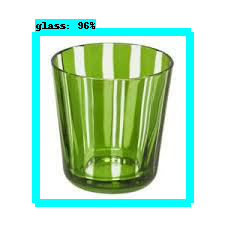

[0.9603397  0.16450761 0.15253986 0.13686034 0.12604995 0.12270824
 0.10946555 0.10801587 0.10340867 0.10147931 0.0982523  0.09695458
 0.09575723 0.09240994 0.08629475 0.08432935 0.08335857 0.08098723
 0.07603326 0.07596806 0.07596494 0.07464305 0.07434791 0.07264756
 0.06940543 0.06761095 0.06718888 0.06567577 0.06415172 0.06410582
 0.06239508 0.06224311 0.06147638 0.06138265 0.06073452 0.06058904
 0.06047747 0.06011516 0.05902415 0.05866963 0.05855208 0.05756349
 0.05724891 0.05682103 0.05659942 0.05613209 0.0560668  0.05582279
 0.05426329 0.05402111 0.0536635  0.05283277 0.05149422 0.05143805
 0.05072045 0.05046715 0.05003363 0.04974707 0.04971804 0.04939534
 0.0491103  0.04908181 0.04885842 0.04885836 0.04878059 0.04869186
 0.04859542 0.04847033 0.04842283 0.04820106 0.04773919 0.04766928
 0.04711237 0.04700295 0.04694888 0.04596397 0.04581586 0.04559363
 0.04546082 0.04502645 0.04496841 0.04483095 0.04434436 0.04427033
 0.04423038 0.04404575 0.04383881 0.04382374 0.04378018 0.0436

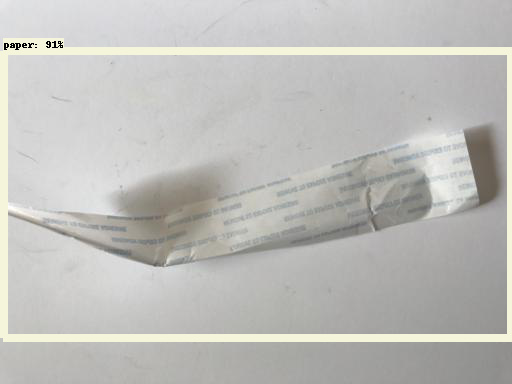

[0.9137105  0.14689429 0.137877   0.13604821 0.12737997 0.1219433
 0.1182979  0.11779255 0.11621558 0.11604411 0.0987132  0.09456582
 0.09085275 0.09018412 0.08455649 0.08154264 0.07809763 0.07380914
 0.07292768 0.07190808 0.07139739 0.0683092  0.06471377 0.06029128
 0.05991633 0.05982519 0.05798478 0.05703584 0.05655673 0.05653849
 0.05569486 0.05559477 0.05510002 0.05458593 0.0541063  0.05360805
 0.05194048 0.05177582 0.05110097 0.05022123 0.05021156 0.05019821
 0.04920515 0.04909739 0.04877753 0.04842613 0.04772585 0.04742952
 0.0470154  0.0462682  0.04621989 0.04597289 0.04585018 0.04540337
 0.04538903 0.04518728 0.04497489 0.04465064 0.04464218 0.04463713
 0.04459809 0.0443172  0.0443037  0.04420706 0.04315875 0.04263381
 0.042321   0.04129026 0.04113967 0.04065706 0.04027833 0.04022947
 0.04014277 0.0400812  0.03990922 0.03987829 0.03983972 0.03978572
 0.03970834 0.03949076 0.03927765 0.03898482 0.03886994 0.03863546
 0.03846104 0.03829568 0.03826704 0.0378465  0.03774007 0.03733

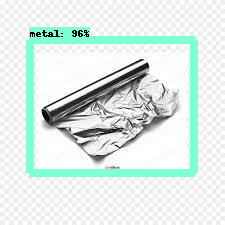

[0.9616574  0.21627535 0.19300658 0.16416317 0.16365291 0.14995028
 0.13322161 0.13234779 0.13220541 0.12891282 0.1282526  0.12472056
 0.11692929 0.11470842 0.11213234 0.11184135 0.10792105 0.1070399
 0.10640237 0.10238207 0.10058179 0.09929548 0.09798604 0.09770018
 0.09440008 0.09432757 0.093476   0.09137493 0.08984344 0.08718602
 0.08680923 0.08463646 0.08330572 0.08062959 0.0762387  0.07609313
 0.0750776  0.07492402 0.07428701 0.07155158 0.07058604 0.0704247
 0.06992024 0.06897262 0.0686533  0.06844697 0.06748464 0.06731423
 0.0672701  0.06635511 0.06546592 0.06543693 0.06540686 0.06503101
 0.06480019 0.06447088 0.0643887  0.06419926 0.06384825 0.06346633
 0.06346252 0.06336527 0.06160228 0.06132243 0.06089168 0.06032367
 0.06017632 0.05995788 0.0591238  0.05827551 0.05825751 0.05799885
 0.05758147 0.05756833 0.05730086 0.05688081 0.05639385 0.05638487
 0.05570278 0.05569133 0.05566544 0.05551809 0.05544647 0.05478923
 0.05474066 0.05466924 0.05465236 0.05439894 0.05426518 0.054216

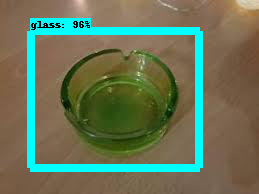

[0.95688546 0.20781308 0.16118178 0.15787011 0.12917131 0.10914578
 0.10676215 0.08023939 0.06909908 0.06657975 0.06446326 0.06045749
 0.0582556  0.05774881 0.05764312 0.05580461 0.05383942 0.053336
 0.05331816 0.05314693 0.04998327 0.0468719  0.04675256 0.04487263
 0.04244525 0.04190473 0.04168678 0.04152875 0.04135608 0.04114412
 0.04096224 0.04080958 0.04013956 0.0394949  0.03887823 0.03883467
 0.03831659 0.03811568 0.03774838 0.03670274 0.03665142 0.03639204
 0.0363247  0.03631451 0.03581665 0.03511209 0.03509837 0.03483395
 0.03444149 0.03430545 0.03364728 0.03353696 0.03353271 0.03310841
 0.03240951 0.03224004 0.03204744 0.03201518 0.03148561 0.03100424
 0.03088581 0.030871   0.03066063 0.03064535 0.03061611 0.03055648
 0.0305303  0.03052992 0.03030995 0.0302718  0.02989385 0.02986587
 0.02970815 0.02960454 0.0295913  0.02958912 0.02948917 0.02931481
 0.02927892 0.02890342 0.02876491 0.02871428 0.02865725 0.02858844
 0.0285801  0.02857475 0.02853952 0.02844763 0.02840773 0.028223

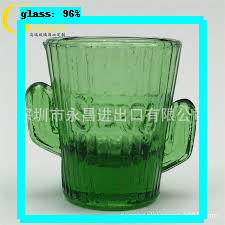

[0.9604707  0.21513905 0.20135823 0.13368508 0.12060486 0.11754434
 0.11398415 0.10673768 0.10261623 0.09975903 0.09652879 0.09239614
 0.08883562 0.08849077 0.08491001 0.08480514 0.08101169 0.08095767
 0.07992043 0.07987462 0.07772658 0.0775666  0.07559992 0.07321557
 0.07189645 0.07161804 0.07115018 0.07093473 0.07023245 0.06872658
 0.06739213 0.06720246 0.06630751 0.06519131 0.06494094 0.06417159
 0.06298889 0.06288743 0.0606737  0.06049526 0.06003333 0.05925059
 0.05900304 0.0580739  0.05722082 0.05699398 0.0557257  0.05504424
 0.05373482 0.05342903 0.05322426 0.05300235 0.05277881 0.05262931
 0.052231   0.05197518 0.05183004 0.0512729  0.05126698 0.05104536
 0.05088856 0.0493136  0.04869736 0.04862316 0.04838221 0.04815638
 0.04775361 0.04700471 0.04666951 0.04514059 0.04512354 0.04480972
 0.04470849 0.04404621 0.0435196  0.04349187 0.0433546  0.04326327
 0.04306391 0.04293667 0.04224017 0.0418982  0.04130071 0.04105147
 0.04043499 0.04038184 0.04011278 0.03992113 0.03987121 0.0398

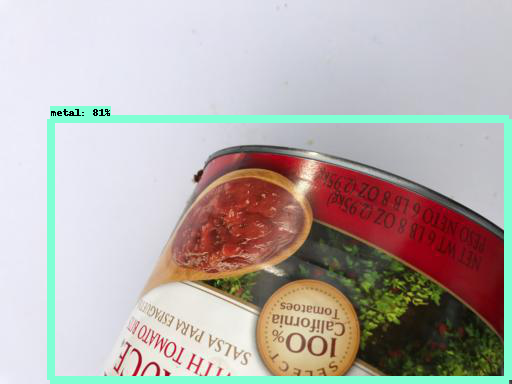

[0.814935   0.14492807 0.11896414 0.11809684 0.09785879 0.09648553
 0.08248872 0.07470284 0.0726489  0.07183664 0.06952024 0.0683835
 0.06692192 0.06393281 0.06257363 0.06200066 0.0616362  0.06036729
 0.05919977 0.05879756 0.05875005 0.05666277 0.05264463 0.05117367
 0.05090058 0.04979552 0.04886855 0.04679937 0.04677013 0.04548783
 0.04304465 0.04242619 0.04228381 0.0413021  0.0409739  0.04092646
 0.04078909 0.03996226 0.03962421 0.03941464 0.03855723 0.03827368
 0.03752236 0.03748152 0.03716639 0.03648475 0.03644686 0.03614179
 0.03611336 0.03557439 0.03505909 0.03504858 0.03497057 0.03459676
 0.03443869 0.0340756  0.03357311 0.03344436 0.03332452 0.03311478
 0.03281805 0.03262724 0.03222033 0.03220467 0.0320477  0.03190058
 0.03188754 0.03171297 0.03159993 0.03153349 0.03118194 0.03108985
 0.03083742 0.03069347 0.03068004 0.03063603 0.03062856 0.03053811
 0.0304496  0.03013894 0.03001426 0.02993372 0.02948896 0.02935139
 0.02922609 0.02921138 0.02908962 0.02880623 0.0286485  0.02854

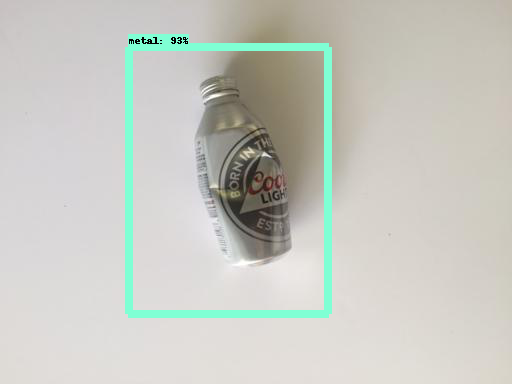

[0.9273471  0.12164915 0.11601377 0.10575368 0.10327489 0.09716162
 0.09550806 0.09406491 0.09274237 0.09153572 0.08489211 0.08479311
 0.0835918  0.0800947  0.07964122 0.07935936 0.07713277 0.07436491
 0.07268351 0.07235875 0.07184163 0.06997423 0.06959585 0.06949376
 0.06909952 0.06852823 0.06802303 0.06587899 0.06511515 0.06509577
 0.06458964 0.06434201 0.06229203 0.0622462  0.06163832 0.06123254
 0.06077894 0.05937889 0.05931658 0.0591208  0.05896029 0.05814179
 0.0578477  0.05758254 0.05682616 0.05665814 0.05591631 0.05550361
 0.05544702 0.05494952 0.05459944 0.05458721 0.05423386 0.05344318
 0.05310262 0.05294916 0.05237162 0.05205549 0.05204322 0.05193459
 0.05193403 0.05100926 0.05029532 0.0501174  0.0500045  0.04993276
 0.04887943 0.04860992 0.04790324 0.04758279 0.04749682 0.04749301
 0.04743585 0.04710959 0.04705208 0.04696001 0.04639008 0.04634545
 0.04588988 0.04573355 0.0449744  0.04492956 0.04431799 0.04431669
 0.04378008 0.04364587 0.04339376 0.04296248 0.04244959 0.0423

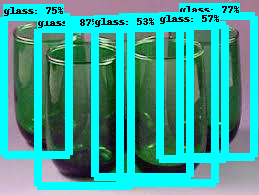

[0.86947215 0.8239128  0.7659319  0.74787587 0.5742004  0.52626836
 0.20701298 0.1442605  0.14302695 0.1187646  0.11429124 0.10843333
 0.09208583 0.09168722 0.08752666 0.08662505 0.08281893 0.0735368
 0.0723111  0.06799492 0.06655316 0.0665075  0.06525292 0.06475473
 0.06354697 0.06227312 0.0621374  0.06166513 0.06162499 0.06150185
 0.06115904 0.06074878 0.05902308 0.05882275 0.05836365 0.05829282
 0.05714945 0.05626522 0.0553636  0.05446914 0.05437511 0.05357154
 0.05307156 0.05281958 0.0515058  0.0513065  0.05113992 0.05108611
 0.05103525 0.05040364 0.05018614 0.05001495 0.04993175 0.04884417
 0.04858318 0.048522   0.04803553 0.04797219 0.04761125 0.04641249
 0.04627147 0.0461381  0.04582409 0.04567525 0.04561918 0.04452869
 0.04373388 0.04360621 0.04325463 0.04320743 0.04316575 0.04307363
 0.04159946 0.04042902 0.0404097  0.03983567 0.0393526  0.03924336
 0.03876285 0.03858558 0.03838866 0.03815797 0.03808638 0.03789108
 0.03776935 0.03766205 0.03732824 0.03685622 0.03677327 0.03600

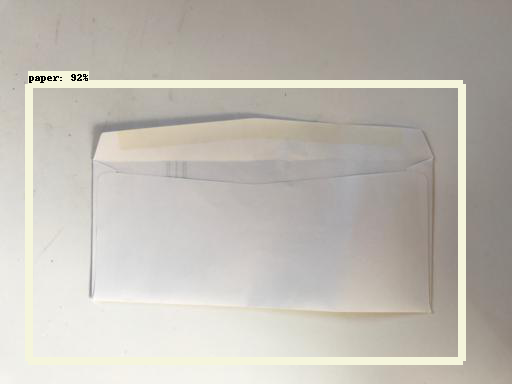

[0.9159861  0.17521839 0.14931686 0.12875123 0.12579298 0.11026657
 0.10615246 0.1036268  0.09224888 0.08703613 0.08651777 0.08556996
 0.0853821  0.08409765 0.08040708 0.07905707 0.07835994 0.07781614
 0.07751466 0.07742472 0.0765639  0.07596479 0.07388865 0.07201167
 0.07164498 0.07089224 0.07013649 0.06993739 0.06941079 0.06726235
 0.06662515 0.06651888 0.06625934 0.06595025 0.06425036 0.06350031
 0.06291651 0.06216769 0.06163478 0.06130125 0.06122942 0.06087964
 0.06064757 0.05848645 0.05742615 0.05716744 0.05596652 0.05567756
 0.05490106 0.05467824 0.05444895 0.05428759 0.05370135 0.0536904
 0.05367402 0.0533188  0.0520008  0.0517501  0.0515755  0.05151717
 0.05150579 0.05127587 0.05036099 0.05010295 0.04953067 0.04870429
 0.04797109 0.04777047 0.04774875 0.04767822 0.04743464 0.04738797
 0.04733757 0.04708113 0.04699539 0.04687937 0.04684973 0.04675936
 0.04673132 0.04628779 0.0461021  0.04607534 0.04597874 0.04593801
 0.04579619 0.04527552 0.04476127 0.04474338 0.04461949 0.04458

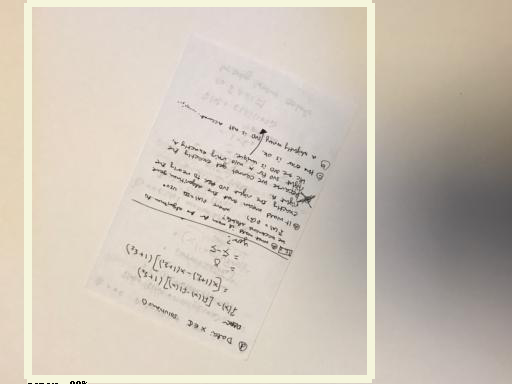

[0.8820839  0.1866304  0.13006449 0.12974283 0.12420078 0.11723638
 0.10865853 0.09973828 0.09290782 0.08926847 0.08649607 0.0837737
 0.0786529  0.06779534 0.06368977 0.0621525  0.06194327 0.06020319
 0.05957914 0.05856911 0.05622522 0.05359224 0.05327276 0.05169816
 0.05135309 0.05115543 0.05098702 0.05062036 0.04987881 0.04948064
 0.04884423 0.04877287 0.048452   0.04789181 0.04756784 0.04754486
 0.04673426 0.04538719 0.04535735 0.04503952 0.04495882 0.04466473
 0.04461491 0.04458825 0.04449528 0.04434322 0.04252313 0.04226308
 0.0400677  0.04004904 0.04002255 0.0398916  0.03965676 0.0395234
 0.03902803 0.03890816 0.03806426 0.03803132 0.03731429 0.03722463
 0.03722435 0.03696843 0.03661295 0.03601933 0.03587506 0.03573575
 0.03566585 0.03546975 0.03542609 0.03535587 0.03492877 0.03489348
 0.03476142 0.03462856 0.03447396 0.03441032 0.03439881 0.03391483
 0.03372145 0.03331796 0.03308177 0.03304926 0.03299981 0.03291183
 0.03285038 0.03283367 0.03279058 0.03253568 0.03234532 0.032095

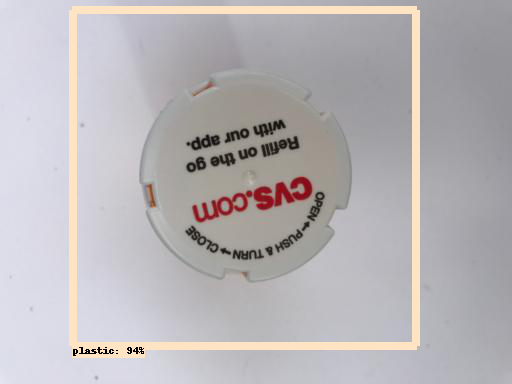

[0.94026375 0.16858864 0.1504759  0.14561586 0.12643138 0.1209223
 0.11988886 0.10998604 0.10292941 0.09603848 0.08379823 0.08364318
 0.08276251 0.0824402  0.07698745 0.07652552 0.07513595 0.07417488
 0.07121263 0.07074767 0.06958852 0.06668787 0.06580266 0.06425589
 0.06414711 0.06310774 0.06174298 0.06056752 0.06037128 0.05828301
 0.05820156 0.05813185 0.05554311 0.05546336 0.05318258 0.05274238
 0.0524903  0.05216863 0.05204577 0.05180606 0.05154278 0.05142405
 0.05113494 0.05112556 0.05009971 0.04886507 0.04820562 0.04764334
 0.04761522 0.0473588  0.04731541 0.04707716 0.0469152  0.04683104
 0.04659998 0.04658709 0.04603511 0.04527321 0.04526409 0.04516031
 0.04504963 0.04407916 0.04351352 0.04306343 0.04284265 0.04259879
 0.04228833 0.04205535 0.04184796 0.04162913 0.04152772 0.04135681
 0.0413296  0.04105092 0.0408111  0.04078066 0.04028767 0.04016464
 0.03975081 0.03934664 0.03931264 0.03925161 0.03838221 0.03791697
 0.03791097 0.03779924 0.03770759 0.03703626 0.03690377 0.03677

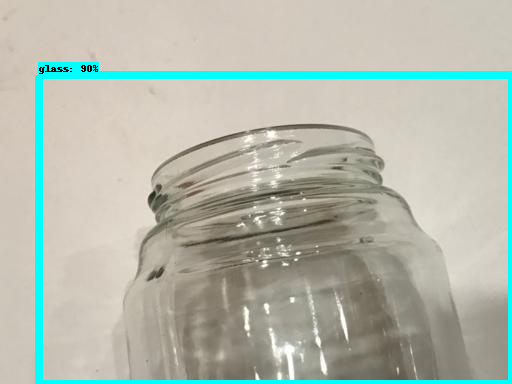

[0.897816   0.10897639 0.09825703 0.09081302 0.0875851  0.08361515
 0.08043017 0.07909639 0.07855915 0.0744001  0.07406653 0.06877874
 0.06683967 0.06324405 0.06187868 0.06136326 0.06036546 0.05968523
 0.05565022 0.05559042 0.0553632  0.05534494 0.05448737 0.0544139
 0.05416434 0.05409167 0.05395541 0.05300167 0.05255158 0.0519586
 0.05169248 0.05096419 0.05066914 0.04935278 0.04842856 0.04831475
 0.04826642 0.04739444 0.04673109 0.04605745 0.0459742  0.04557796
 0.04469799 0.0446233  0.04420661 0.04400282 0.04370521 0.04170522
 0.0413812  0.04083927 0.04068727 0.04054799 0.04039111 0.04021374
 0.04013282 0.040011   0.03989104 0.03975939 0.03972623 0.03969052
 0.03967025 0.03947541 0.03926323 0.03906895 0.03881164 0.03873657
 0.03868866 0.03826672 0.03818475 0.03745763 0.03733855 0.03721122
 0.03702112 0.03691121 0.03676639 0.03667542 0.03636971 0.03618817
 0.03582016 0.03558149 0.03552703 0.03475058 0.03459921 0.03426711
 0.0341373  0.03382053 0.03374077 0.03348102 0.03329488 0.033059

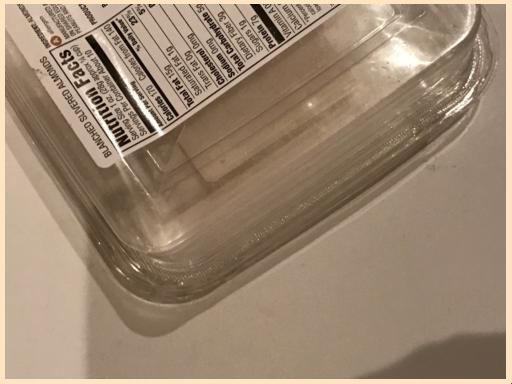

[0.84257275 0.28655195 0.25094283 0.11942098 0.09405416 0.08677138
 0.08349685 0.07270908 0.07265648 0.0668767  0.06527773 0.05959807
 0.05215062 0.05212225 0.0491869  0.04850293 0.04749297 0.04636946
 0.04601964 0.04434841 0.04417192 0.04227971 0.03742176 0.0365624
 0.03655627 0.03618233 0.03429744 0.03424003 0.03392914 0.03351456
 0.03271485 0.03223328 0.03164813 0.03121107 0.03120284 0.0311182
 0.03101861 0.0309531  0.03084736 0.03004081 0.02997067 0.02982756
 0.02947589 0.02944604 0.02925727 0.02919888 0.02912322 0.02895077
 0.02867331 0.02862526 0.02829104 0.02814085 0.02781247 0.02763785
 0.02755268 0.0275477  0.02745924 0.0274524  0.02734459 0.0273142
 0.02717644 0.02712337 0.02705764 0.02693201 0.026885   0.02673911
 0.02669636 0.02669113 0.02650392 0.02642412 0.02640933 0.0263725
 0.02631811 0.0262394  0.0261427  0.02592816 0.02592678 0.02584168
 0.02565177 0.02544755 0.02541686 0.02514437 0.0250838  0.02491695
 0.02476131 0.02473278 0.02465851 0.02462526 0.02457048 0.02439705

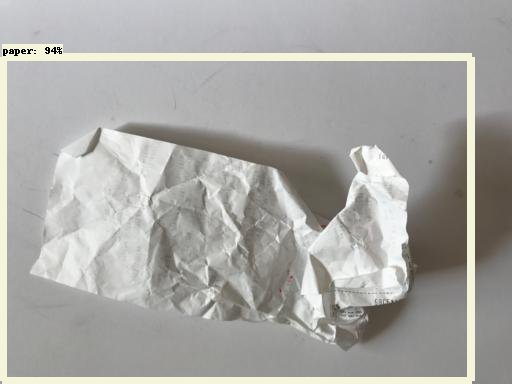

[0.9383115  0.11062432 0.08508737 0.08348828 0.07452456 0.07249159
 0.06904636 0.06698698 0.0629016  0.06167341 0.05887504 0.05792633
 0.0566494  0.05549469 0.05455826 0.05438267 0.05340291 0.05298881
 0.05278642 0.05222268 0.05158975 0.05131454 0.05113053 0.05079605
 0.05008774 0.0497255  0.04925344 0.04849282 0.04661642 0.04508002
 0.04505179 0.04472076 0.04434293 0.04369027 0.04305728 0.04268908
 0.04250393 0.04073083 0.04042815 0.04004904 0.03958148 0.0395542
 0.03889742 0.03873952 0.03856365 0.03851772 0.03848821 0.03790365
 0.0378286  0.03774497 0.03770101 0.03764937 0.037615   0.03760403
 0.03753944 0.03680972 0.03648289 0.03643892 0.03621315 0.03601685
 0.03593286 0.0356848  0.03567996 0.03531621 0.03469617 0.03459403
 0.03427998 0.03393508 0.03381125 0.03380681 0.03366389 0.03361636
 0.03310563 0.03308843 0.03307571 0.03247437 0.03234033 0.03230015
 0.03227472 0.0322025  0.0321749  0.03198278 0.031867   0.03178476
 0.03176143 0.031408   0.0313813  0.03117457 0.03081757 0.03079

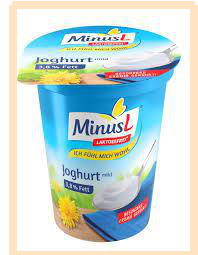

[0.94546765 0.15696672 0.15346028 0.12224583 0.11651704 0.11096689
 0.10828955 0.10482471 0.1042536  0.10396887 0.10265116 0.08912635
 0.08842064 0.08831422 0.08771438 0.08620302 0.08566237 0.08349107
 0.08104178 0.0771841  0.07710538 0.07591844 0.0742709  0.07422036
 0.07255573 0.07134908 0.07089332 0.07025767 0.06962676 0.06950046
 0.06881377 0.06859379 0.06751315 0.06653625 0.06627885 0.0657592
 0.06344048 0.06341603 0.06317507 0.06225429 0.06131455 0.06117535
 0.05871375 0.05822561 0.05517498 0.05368639 0.05365494 0.05298714
 0.05295084 0.05282153 0.05243621 0.05177052 0.05173166 0.05102948
 0.05053548 0.04977233 0.04967451 0.04962115 0.04961609 0.04958455
 0.04951214 0.04834374 0.04820789 0.04729167 0.04728904 0.04652886
 0.04595421 0.04580114 0.044977   0.04492664 0.0448122  0.0447492
 0.04434108 0.0439018  0.04349774 0.04313432 0.04310072 0.04288871
 0.04277197 0.04261767 0.04239638 0.04100265 0.04029219 0.04010656
 0.0399942  0.03992021 0.03953477 0.03931144 0.03924355 0.039061

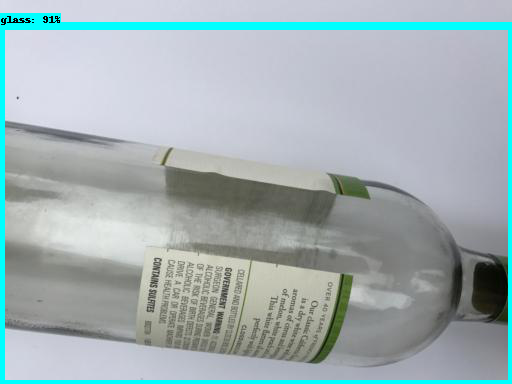

[0.91138124 0.1567571  0.11413256 0.11060122 0.10607991 0.10542975
 0.10188573 0.09468586 0.0942217  0.09030138 0.08875087 0.08744307
 0.08245005 0.08043446 0.07937527 0.07930626 0.07756867 0.07531985
 0.07183638 0.06907131 0.06144223 0.06135259 0.05880481 0.05786038
 0.05717593 0.05412641 0.05301024 0.05040154 0.049976   0.04952737
 0.04749472 0.0471107  0.04665186 0.04615665 0.0459054  0.04585053
 0.04570148 0.04487282 0.04443481 0.04404968 0.04369084 0.04322751
 0.04170194 0.04169939 0.04163541 0.040568   0.04041803 0.03981722
 0.03919176 0.03891133 0.03797565 0.037553   0.03698874 0.03680532
 0.03672352 0.03669758 0.0364118  0.03610556 0.03589589 0.03579502
 0.03575336 0.03540448 0.03514818 0.03440429 0.03436542 0.03399347
 0.03392144 0.03375296 0.03369832 0.03351954 0.03338724 0.03326156
 0.03313164 0.03307425 0.03272136 0.03271323 0.03213421 0.0320388
 0.03203207 0.0319382  0.03173275 0.03145959 0.03141067 0.03093511
 0.03087916 0.03085299 0.03080494 0.03053188 0.03044759 0.03036

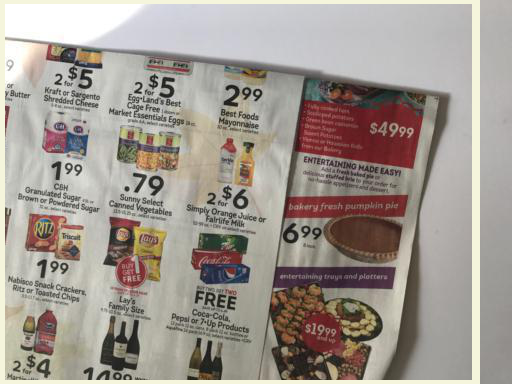

[0.9372892  0.09877946 0.08202119 0.07985069 0.07549056 0.07306887
 0.0682083  0.06425703 0.05484275 0.0545047  0.05390729 0.05272185
 0.05046682 0.05040445 0.05025201 0.05000986 0.04802027 0.04717531
 0.04349632 0.0426914  0.04206884 0.04206571 0.04131656 0.04040197
 0.0402819  0.03974749 0.03891566 0.03889335 0.03757889 0.03754173
 0.0373142  0.03646555 0.03639454 0.03607487 0.03598008 0.03592784
 0.03400688 0.03391311 0.03298653 0.03264367 0.03258336 0.03213183
 0.03208363 0.03188426 0.03181473 0.03147837 0.03099442 0.03097854
 0.02929589 0.02910192 0.02887161 0.02876121 0.02868578 0.02836892
 0.02814266 0.02805784 0.02803341 0.02800381 0.02795258 0.02773676
 0.02772667 0.02749879 0.02735061 0.02733657 0.02731817 0.0272138
 0.02715324 0.02709454 0.02680282 0.02676444 0.02666649 0.02665523
 0.02631232 0.02629353 0.02625451 0.02614427 0.02590426 0.02575827
 0.02545126 0.0253672  0.02523028 0.02494676 0.02479709 0.02474454
 0.02467755 0.02456099 0.02393972 0.02391281 0.02390726 0.02370

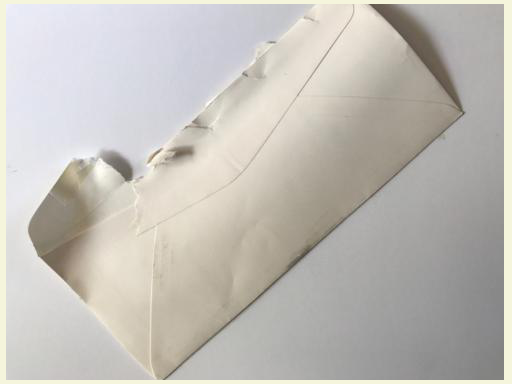

[0.9357009  0.1487557  0.11575611 0.09863254 0.08500049 0.07313129
 0.07249706 0.07058876 0.06709298 0.06601452 0.06441137 0.06278746
 0.06067155 0.06023321 0.05951803 0.05934229 0.05489831 0.05426143
 0.05378807 0.0518106  0.05059568 0.04513101 0.04487454 0.04424241
 0.04423799 0.04197194 0.04098864 0.04089055 0.04041968 0.04015694
 0.03981316 0.03962745 0.03789392 0.03762526 0.03690915 0.03587423
 0.03587046 0.03558633 0.03552327 0.03504111 0.03471707 0.03461831
 0.03435627 0.03418968 0.03380513 0.0334956  0.03308825 0.03300396
 0.03300151 0.03289365 0.0322713  0.03129556 0.03117986 0.03089405
 0.03062771 0.03008711 0.03004816 0.02963344 0.02946957 0.02945574
 0.02944386 0.02928076 0.02915496 0.02896421 0.02878595 0.02845277
 0.02834763 0.02829453 0.02820133 0.02815724 0.02804413 0.02772332
 0.027719   0.02767726 0.02757055 0.02755677 0.02754197 0.0274772
 0.02728995 0.02726632 0.0270657  0.02689027 0.02646944 0.02638238
 0.02611083 0.02567475 0.02542821 0.0253789  0.02513137 0.02506

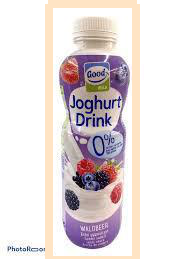

[0.94808364 0.27135396 0.25537616 0.21557498 0.20303133 0.20006928
 0.16776063 0.15130176 0.14820361 0.14754184 0.14211369 0.1373131
 0.13503586 0.11214306 0.1037288  0.10206434 0.09926576 0.09762575
 0.09627525 0.09537204 0.09150493 0.09091898 0.08997656 0.08770959
 0.08707075 0.0866324  0.08497074 0.08215771 0.08082968 0.07805925
 0.07753235 0.07726302 0.07688435 0.07683769 0.07669207 0.07612146
 0.07507485 0.07506932 0.07494903 0.07467305 0.07391721 0.072861
 0.07227938 0.07156166 0.07112364 0.07089451 0.07072879 0.07039467
 0.06891201 0.06846629 0.06748025 0.06498609 0.06377999 0.0635161
 0.06323171 0.06213686 0.06087361 0.06056302 0.0601584  0.05995732
 0.05946814 0.05918077 0.05902344 0.05882173 0.05865659 0.05845081
 0.05841679 0.05799162 0.05782529 0.05759924 0.05756171 0.05755773
 0.05753228 0.05719248 0.0564319  0.05618945 0.05603612 0.0550766
 0.05485293 0.05453841 0.05426779 0.0538223  0.05356402 0.05356223
 0.05344045 0.0533513  0.05324878 0.0531275  0.05306198 0.05305587


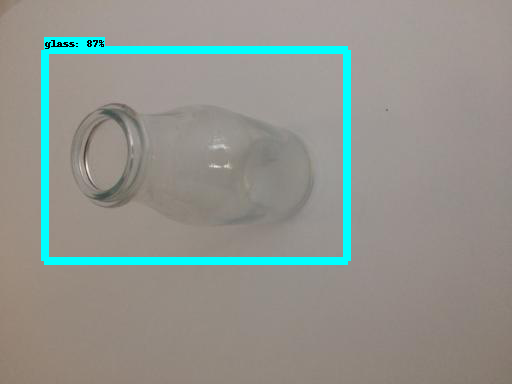

[0.86869526 0.27438402 0.22744109 0.1620635  0.14247508 0.13565402
 0.11706442 0.11150013 0.10924031 0.10033076 0.09736136 0.09519771
 0.09383166 0.09268441 0.09136787 0.09059554 0.08896437 0.08783484
 0.08752293 0.0841575  0.08271641 0.08171686 0.08171054 0.08042412
 0.07969292 0.07966163 0.07776811 0.07740982 0.07704431 0.07540748
 0.07492416 0.07485934 0.07481892 0.07399765 0.07383695 0.07262511
 0.07249066 0.07238224 0.07137518 0.07114996 0.07102767 0.07073335
 0.06918328 0.06905738 0.068655   0.06773099 0.06758344 0.06613003
 0.06599367 0.06551532 0.06541014 0.0649403  0.06470966 0.06404006
 0.06398277 0.06385396 0.06299516 0.06167461 0.06154577 0.06149185
 0.06142827 0.06074581 0.06065935 0.06037918 0.0596812  0.05955606
 0.05906632 0.05881688 0.05865533 0.05855    0.05833822 0.05751352
 0.05709581 0.05697974 0.05643947 0.05515913 0.05460351 0.05452096
 0.05441271 0.05441184 0.05406301 0.05392189 0.05340736 0.05316067
 0.05292732 0.0527503  0.05273888 0.05272222 0.05239999 0.0523

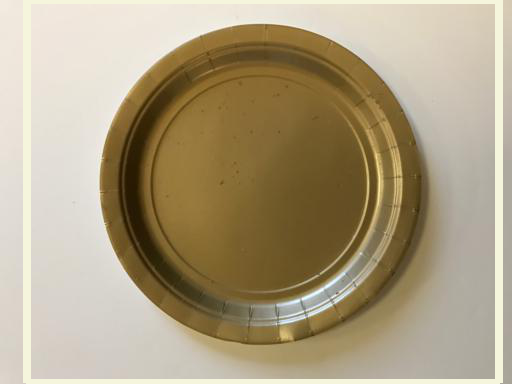

[0.9384052  0.12088688 0.11025363 0.10049717 0.09062164 0.08620598
 0.06318174 0.05137267 0.04755351 0.04137142 0.0410729  0.03795313
 0.03756878 0.03737566 0.03603903 0.03560329 0.03494222 0.03333475
 0.03270157 0.03264514 0.03191401 0.03129121 0.03021208 0.03001675
 0.0297428  0.02972401 0.02962257 0.02952815 0.02905158 0.02903189
 0.02861962 0.02844345 0.02807505 0.02791973 0.02754315 0.02754234
 0.02732388 0.02705065 0.02605519 0.02593463 0.02593229 0.02566429
 0.02561465 0.02559244 0.02558166 0.0254424  0.0253452  0.02534059
 0.02527149 0.02527084 0.02520022 0.02517865 0.02502578 0.02501585
 0.02499852 0.02479593 0.02464898 0.02450006 0.02448449 0.02447475
 0.02442428 0.02439149 0.02436031 0.02435873 0.02435607 0.02430905
 0.02430538 0.0242403  0.02419889 0.02388624 0.02369948 0.02337206
 0.02314016 0.02288663 0.02284225 0.02283634 0.0226806  0.02265212
 0.0225286  0.02250747 0.02213521 0.0220941  0.02189415 0.02183443
 0.02181274 0.02171047 0.02161248 0.02156569 0.02155482 0.0214

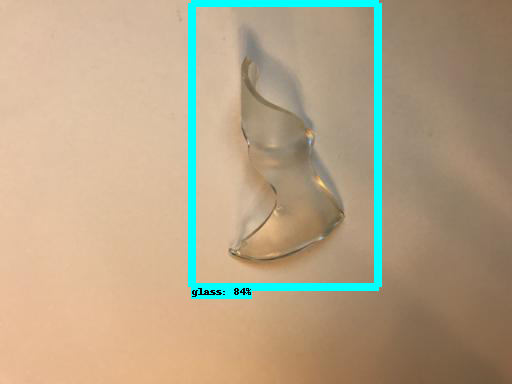

[0.8429694  0.12873486 0.12209611 0.09847888 0.0950548  0.09494897
 0.09324484 0.09080259 0.09029312 0.09028322 0.08595298 0.08198836
 0.07949094 0.07652269 0.07596    0.07530493 0.07377003 0.07312774
 0.07230262 0.07176562 0.07114011 0.06678233 0.06548508 0.06510373
 0.06276488 0.06271415 0.06265199 0.06251396 0.06135998 0.06133168
 0.06107081 0.06056913 0.06037889 0.05879212 0.05731624 0.05652073
 0.05575731 0.0556476  0.05536208 0.05535589 0.05498834 0.05469017
 0.05446734 0.05311916 0.05251537 0.05250585 0.05154891 0.05136837
 0.0496194  0.0492748  0.04917359 0.04908808 0.04831294 0.0482435
 0.0479121  0.04781371 0.04674697 0.04670326 0.0466782  0.04605175
 0.04569218 0.04568026 0.04543564 0.04513929 0.04510853 0.04473476
 0.04463138 0.04451109 0.04441924 0.04436941 0.04411517 0.04398485
 0.0433442  0.04249543 0.04233636 0.04219396 0.04166137 0.04165433
 0.041637   0.0416325  0.0416263  0.04161955 0.04150964 0.04133106
 0.04109078 0.04078333 0.04051728 0.0400163  0.03999649 0.03995

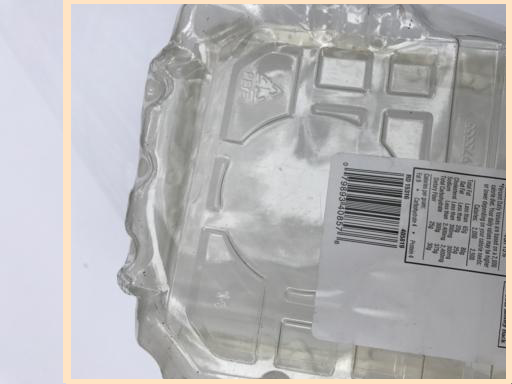

[0.9322359  0.12087537 0.11862683 0.08567166 0.08162159 0.07961445
 0.07690273 0.07527817 0.06288054 0.06284959 0.06144841 0.05805911
 0.05134488 0.05093681 0.05037725 0.04948165 0.04686147 0.04652696
 0.04634394 0.04539128 0.04530337 0.04449405 0.04356118 0.0422913
 0.04086021 0.04028752 0.03994233 0.03919558 0.03918138 0.03836473
 0.0375625  0.03640951 0.03628833 0.03625766 0.03556721 0.0334248
 0.03333004 0.03305329 0.03262713 0.03258472 0.03255957 0.03243846
 0.0323852  0.03234857 0.0318726  0.03178352 0.03175829 0.0315651
 0.03119661 0.03112302 0.03109374 0.03076232 0.03009659 0.02999004
 0.02954818 0.02932995 0.02928657 0.02918557 0.02910451 0.02886572
 0.02871518 0.02840547 0.02825376 0.02791102 0.02766191 0.02731895
 0.02728872 0.02700984 0.02684215 0.02679842 0.02665695 0.02662552
 0.02650932 0.02642534 0.02617352 0.02571475 0.02559801 0.02555436
 0.02532237 0.02531301 0.02513785 0.02508617 0.02504604 0.02487309
 0.02483879 0.02481926 0.02481751 0.02458734 0.02444234 0.0242143

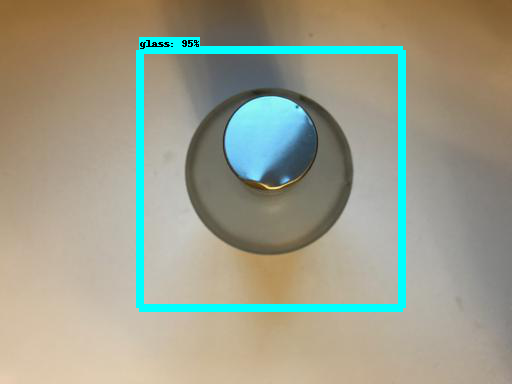

[0.9503138  0.23888747 0.23388287 0.16977164 0.16277352 0.14999056
 0.14018105 0.1246972  0.1222434  0.11547512 0.11257166 0.1089799
 0.0928887  0.09114949 0.09049789 0.08967791 0.08815002 0.08605958
 0.08452083 0.08352348 0.08286759 0.08262443 0.08181655 0.08149356
 0.08135773 0.08068021 0.08026665 0.07807714 0.0752711  0.07420521
 0.07366572 0.0696097  0.06808695 0.06589171 0.06531765 0.06451987
 0.0637587  0.06338861 0.05860979 0.05843505 0.05755217 0.05743833
 0.05735965 0.05731427 0.05673954 0.05628838 0.05609865 0.05512685
 0.05498373 0.05428971 0.053697   0.0536669  0.05327964 0.05300322
 0.05281122 0.05239459 0.05206392 0.05127064 0.04966207 0.04917924
 0.04912221 0.04810334 0.04777896 0.0476054  0.04742854 0.04715244
 0.04689835 0.04643983 0.04642364 0.0462397  0.04612783 0.04589496
 0.04588993 0.04583552 0.04578219 0.04557354 0.04542354 0.04476014
 0.04426299 0.04376496 0.04363547 0.04322913 0.0429865  0.04240486
 0.04237093 0.04233704 0.04226587 0.04103022 0.04090516 0.04073

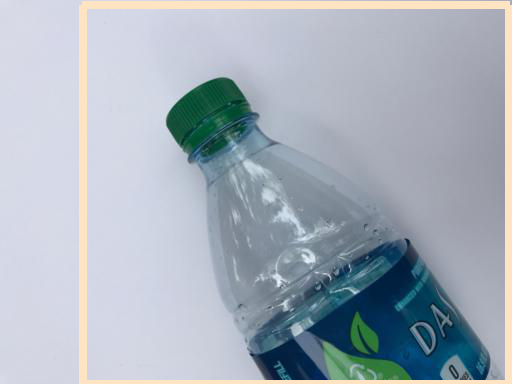

[0.917743   0.10326101 0.0951791  0.08824391 0.08785244 0.08619753
 0.08547764 0.0840402  0.08214521 0.08176168 0.08153263 0.08143218
 0.08019067 0.07903677 0.07852323 0.07829841 0.07168545 0.06923033
 0.0665758  0.06641357 0.06425239 0.06363592 0.06264565 0.06244173
 0.05980267 0.05879834 0.05852632 0.05807355 0.05708585 0.05698488
 0.05639202 0.05583066 0.05396424 0.05241682 0.052088   0.05188554
 0.05186613 0.05001357 0.0493528  0.04759054 0.04614077 0.04530584
 0.04490251 0.04449202 0.04328212 0.04311371 0.04278992 0.0427446
 0.04219889 0.04188814 0.04185183 0.04132775 0.04130775 0.04122012
 0.04078027 0.04055653 0.04022646 0.03904038 0.03894921 0.03886302
 0.03879912 0.03823587 0.03820321 0.03815426 0.03801373 0.03781019
 0.03765992 0.0374409  0.03714241 0.03704813 0.03684243 0.03674114
 0.0366281  0.03622055 0.03620158 0.03610365 0.03601089 0.03598912
 0.03589358 0.03567709 0.03562156 0.03518239 0.03486001 0.03475967
 0.03426686 0.03419606 0.03409385 0.03387692 0.0338758  0.03372

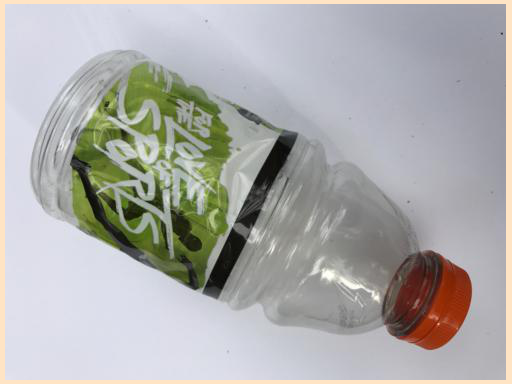

[0.9274406  0.15549102 0.13284732 0.12672089 0.1017084  0.1015696
 0.07993326 0.06436626 0.05876385 0.0582066  0.05733014 0.05729081
 0.05652518 0.04987192 0.04951188 0.04849918 0.04683265 0.04544577
 0.04530905 0.04524009 0.0430469  0.04272679 0.04063426 0.04059922
 0.04028685 0.03981477 0.03940229 0.03788563 0.03697908 0.03555027
 0.03554074 0.03552481 0.03523948 0.03504648 0.03495282 0.03447695
 0.03412143 0.03405516 0.03388155 0.03308379 0.03293763 0.03257997
 0.0325713  0.03254705 0.03238906 0.0320979  0.03203207 0.03203205
 0.03142315 0.0310353  0.03057222 0.03048175 0.03008437 0.02996262
 0.02889085 0.02876684 0.02872909 0.02870233 0.02869973 0.02852577
 0.0285079  0.02820489 0.02789327 0.02781494 0.02777877 0.02775341
 0.02744081 0.02723199 0.02690647 0.0268657  0.02672409 0.02647192
 0.02644131 0.02630701 0.02617873 0.02601905 0.02577719 0.02559589
 0.02542541 0.02514738 0.0250908  0.02503872 0.02476446 0.024668
 0.02462265 0.02424179 0.02422541 0.02416422 0.02405133 0.0240370

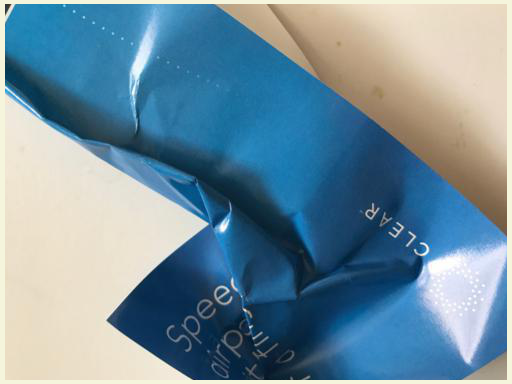

[0.93958926 0.09962678 0.08940798 0.07505299 0.07215452 0.06980588
 0.06969678 0.06391048 0.06281795 0.06148556 0.05929695 0.05867038
 0.05649931 0.05525775 0.05481027 0.05308436 0.05181805 0.05102688
 0.04961964 0.04920181 0.04873084 0.04725939 0.04687992 0.04651551
 0.04416632 0.04409329 0.04341114 0.04295485 0.04207507 0.04081561
 0.04043897 0.03956044 0.03946505 0.03925944 0.03924782 0.03756992
 0.03738934 0.03736173 0.03641145 0.03602401 0.03576286 0.03465063
 0.03340425 0.03289324 0.03283035 0.03266438 0.03215954 0.03206968
 0.03163264 0.03162923 0.03145137 0.0314034  0.03116431 0.03110137
 0.0310247  0.03098091 0.03075895 0.03071924 0.03045438 0.03036115
 0.02936494 0.02922736 0.02918039 0.02913846 0.02911973 0.02899159
 0.02888313 0.02883013 0.028418   0.0283857  0.02835471 0.0282119
 0.02806121 0.02782817 0.02781246 0.02772933 0.02754424 0.02752938
 0.02746419 0.02743117 0.02729818 0.02710992 0.02708853 0.0270667
 0.02699557 0.02676272 0.02674306 0.02657459 0.02616206 0.025924

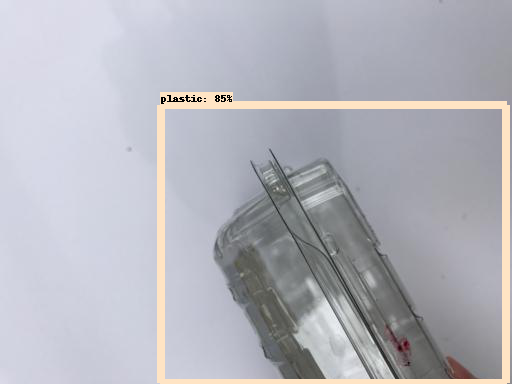

[0.8519833  0.2302495  0.1245123  0.11869091 0.11607569 0.10302422
 0.1029333  0.09495182 0.08985263 0.08813591 0.08099862 0.08058526
 0.07889248 0.07459731 0.07445138 0.07287153 0.07251345 0.0720946
 0.0680137  0.06732824 0.06692061 0.06344444 0.06310748 0.06197415
 0.06179672 0.05906307 0.05883638 0.05872595 0.05760028 0.05717048
 0.05610029 0.055672   0.05523008 0.05486226 0.05451985 0.05440274
 0.05404655 0.05338923 0.05329674 0.0531233  0.05186405 0.05165557
 0.05134862 0.05069277 0.05063995 0.05042796 0.04926685 0.04890941
 0.04888999 0.04830151 0.04764238 0.0459017  0.04568784 0.04552094
 0.04528845 0.04493713 0.04469158 0.04466655 0.04450929 0.04404511
 0.0436461  0.04357889 0.04350987 0.04295522 0.04282393 0.0422097
 0.04176122 0.04127847 0.04053534 0.04042656 0.04035058 0.03990135
 0.0395751  0.03920604 0.03916952 0.03901195 0.03881432 0.03871311
 0.03865609 0.03833013 0.03823652 0.03809032 0.03788427 0.03779031
 0.03775554 0.03746185 0.03739407 0.03736576 0.03733941 0.037031

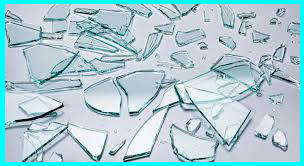

[0.9410964  0.10396767 0.09771269 0.08863091 0.08751228 0.08573464
 0.08346485 0.08021042 0.08014738 0.07544956 0.0612129  0.05901107
 0.05414602 0.04797725 0.04356835 0.042254   0.04186054 0.04140962
 0.04113838 0.03847747 0.03839555 0.03830219 0.03759029 0.03752291
 0.03729511 0.03666868 0.03655512 0.03598192 0.03388638 0.03387103
 0.03338596 0.03320636 0.03293413 0.03216593 0.03212345 0.03168165
 0.03144223 0.02987905 0.02960745 0.02896194 0.02882013 0.02846135
 0.02790323 0.02722135 0.02707465 0.02663019 0.02648951 0.02629629
 0.02602065 0.02578881 0.02571153 0.02565113 0.02549576 0.02501968
 0.02460572 0.02458139 0.0243609  0.02426322 0.02416709 0.02391953
 0.02380589 0.02377523 0.02365104 0.02261186 0.02253973 0.02249563
 0.02208622 0.02198481 0.02191757 0.02189605 0.02183197 0.02111334
 0.02096625 0.02090194 0.02055839 0.02032036 0.02031437 0.02025424
 0.02017009 0.02004786 0.01998486 0.01998136 0.01982241 0.01975388
 0.01947671 0.01936934 0.01932041 0.019312   0.01926652 0.0191

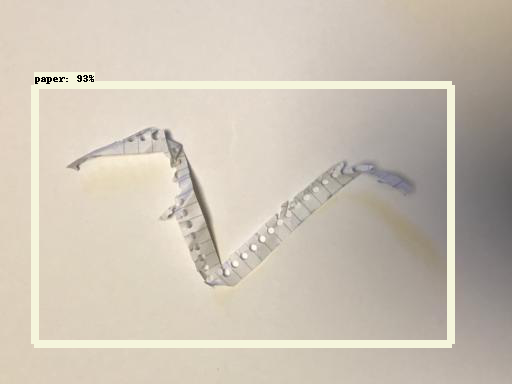

[0.9311487  0.15133011 0.11983764 0.10983763 0.10023985 0.09521172
 0.09120757 0.09002876 0.08820952 0.08704846 0.08429708 0.08284894
 0.08256388 0.08239004 0.08196139 0.08179335 0.08009833 0.07868021
 0.0786477  0.0781507  0.07629359 0.07443353 0.07303961 0.07057938
 0.07028437 0.07025964 0.07016292 0.06903575 0.0681263  0.06714201
 0.06659796 0.06601484 0.06512181 0.06420132 0.06408924 0.06336607
 0.06318685 0.06276008 0.06269602 0.06160853 0.06146383 0.06108254
 0.0605223  0.0599039  0.05982742 0.0596993  0.05955713 0.0593237
 0.05919269 0.05846517 0.058183   0.05784526 0.0577145  0.05651187
 0.0562241  0.05612441 0.05509044 0.05481275 0.05464798 0.05318628
 0.05290773 0.05208252 0.05192964 0.05089469 0.05025716 0.05006983
 0.04980943 0.04972552 0.04890729 0.04855086 0.0485376  0.04843476
 0.0484013  0.04760844 0.0474551  0.04730198 0.04718776 0.0469065
 0.04649713 0.04640291 0.04638445 0.04628824 0.04606016 0.04587144
 0.04578812 0.04578447 0.04545376 0.04544872 0.04517826 0.044339

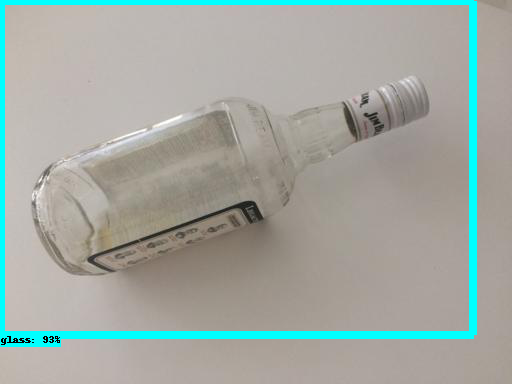

[0.93386567 0.2984308  0.2753327  0.17003503 0.14090097 0.13234733
 0.12762165 0.11401753 0.11265309 0.09974217 0.0947596  0.09225669
 0.08913563 0.0887745  0.08513463 0.08097577 0.07980057 0.07816996
 0.07625727 0.07611846 0.07593858 0.07589297 0.07415843 0.07377642
 0.07132874 0.07038719 0.0701815  0.06973308 0.06950212 0.06845317
 0.06832638 0.06770998 0.06726493 0.06721649 0.06698655 0.06637309
 0.06623407 0.06443647 0.06395962 0.06180659 0.06091288 0.05827849
 0.05800466 0.05694961 0.05623497 0.05516616 0.05478663 0.05360536
 0.05309103 0.05285957 0.05249165 0.05238052 0.05214098 0.05177027
 0.05059027 0.0505822  0.05043249 0.05041384 0.05013931 0.04957141
 0.04918092 0.04901199 0.04894517 0.0487385  0.04838861 0.04810987
 0.04696326 0.04666143 0.04658655 0.04615767 0.04613592 0.04511391
 0.04494644 0.04486942 0.04467933 0.04426959 0.0437722  0.04370456
 0.04357221 0.04347194 0.04346178 0.04288232 0.04275437 0.04266289
 0.0426252  0.04242733 0.04232602 0.0423117  0.04217026 0.0415

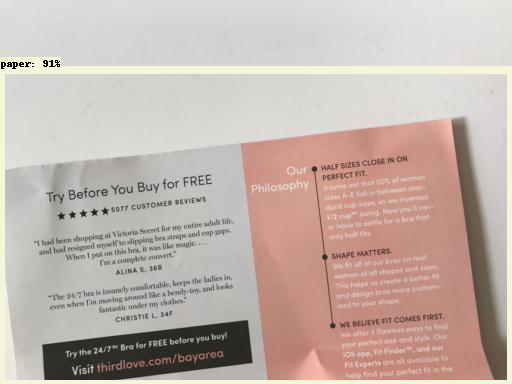

[0.9146075  0.11308957 0.10503516 0.09856645 0.09718928 0.0929601
 0.08960698 0.08403078 0.08099118 0.07976685 0.07803258 0.07769739
 0.07756242 0.07660578 0.0762914  0.07473413 0.07409903 0.07347643
 0.07134902 0.06992267 0.06732263 0.06331479 0.06312283 0.06017426
 0.06011541 0.05962124 0.058034   0.05794926 0.05643298 0.05589117
 0.05506288 0.05498485 0.05485792 0.05463054 0.05455516 0.05452944
 0.05399789 0.05362538 0.0532659  0.05254107 0.05246142 0.05183053
 0.05004905 0.04962448 0.04945217 0.049175   0.04804615 0.04689106
 0.04678459 0.04664284 0.04660794 0.04645195 0.04622246 0.04615982
 0.04611045 0.0457199  0.04552415 0.04520268 0.04510294 0.04485563
 0.04473368 0.04442444 0.04390574 0.04323051 0.04283043 0.04215432
 0.0419878  0.04176792 0.04162021 0.04153763 0.04138498 0.04081745
 0.04046505 0.03942133 0.03909702 0.03879106 0.03854834 0.03798999
 0.03781979 0.03776173 0.03768721 0.03749248 0.03659705 0.03651746
 0.03627266 0.03609142 0.03576549 0.03547321 0.03510921 0.03509

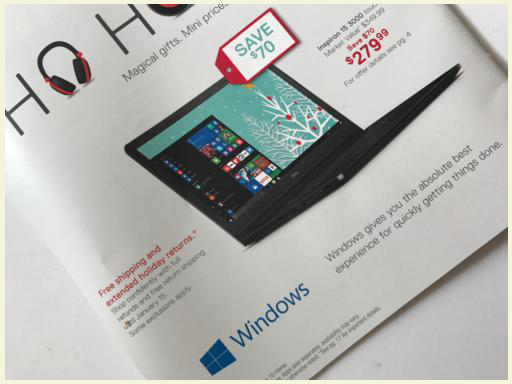

[0.9352821  0.11232509 0.09529649 0.08918449 0.07310938 0.07166956
 0.07158232 0.07054471 0.06921254 0.06447354 0.0621217  0.05816724
 0.05751318 0.05550598 0.05141821 0.05126896 0.04685968 0.04338752
 0.04202686 0.04096401 0.03759554 0.03751194 0.03703626 0.03647079
 0.0363505  0.03501761 0.03455603 0.03449282 0.03234803 0.03157426
 0.03151267 0.03143164 0.03058428 0.03041666 0.03041443 0.03016755
 0.02955944 0.02949849 0.0291958  0.02908748 0.028252   0.02786966
 0.02776626 0.02776036 0.02774909 0.02729116 0.02693391 0.02655104
 0.02629756 0.02628618 0.02621379 0.02589464 0.0257123  0.02562895
 0.02553728 0.02499377 0.02446228 0.02444255 0.02439566 0.0242621
 0.02394372 0.02392856 0.02373629 0.02364228 0.02333739 0.02294384
 0.02287897 0.02280871 0.02267268 0.0225949  0.02252052 0.02244659
 0.02240428 0.02223287 0.02209108 0.02193689 0.02169033 0.02166709
 0.02158548 0.02156231 0.02152808 0.02139194 0.02129594 0.0212379
 0.02089403 0.02080307 0.0207269  0.0206544  0.02046643 0.020434

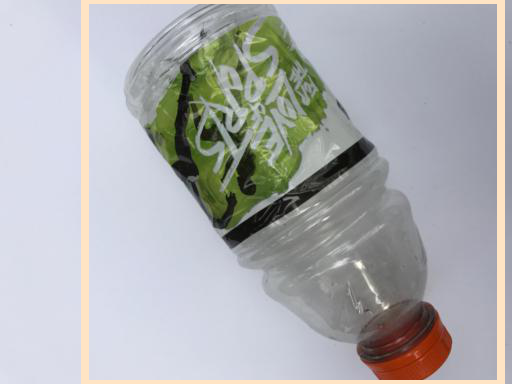

[0.9354291  0.14064899 0.11661271 0.1148232  0.10888207 0.09452616
 0.07732546 0.07679939 0.07186093 0.07162404 0.06963363 0.06262265
 0.06137515 0.06063835 0.05886848 0.0563255  0.05614925 0.05496109
 0.05481681 0.0536166  0.05281268 0.05191095 0.05027725 0.04981354
 0.04928172 0.04790036 0.04716045 0.04604075 0.04571564 0.04479948
 0.04445675 0.04420901 0.04225209 0.0410096  0.03875357 0.03859196
 0.03836797 0.03816455 0.03793268 0.0369892  0.03644403 0.03554516
 0.03541305 0.0352899  0.03453896 0.0345138  0.03421695 0.03394143
 0.03368777 0.03361231 0.03316719 0.03301837 0.03293477 0.0329272
 0.03254366 0.03230423 0.03219789 0.03156859 0.03135918 0.0311551
 0.03111549 0.03082028 0.03038123 0.03032132 0.03031358 0.03029883
 0.03004716 0.02998389 0.0299461  0.02979676 0.02971265 0.02964559
 0.02960918 0.02934502 0.02932901 0.02894208 0.02886905 0.02843574
 0.02842985 0.0283624  0.02826908 0.02813966 0.02806863 0.02783208
 0.02780082 0.02772606 0.02769958 0.02762706 0.02761406 0.027507

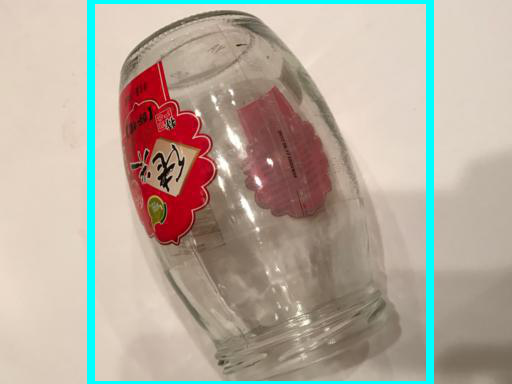

[0.9123235  0.20351602 0.20183185 0.19800867 0.19373284 0.17434287
 0.12124405 0.06618922 0.06557751 0.06459983 0.0566923  0.05652535
 0.05302384 0.05279449 0.05183063 0.04994628 0.04792856 0.04699682
 0.04579168 0.04576248 0.0448059  0.04390974 0.04278922 0.04249634
 0.04176959 0.04148164 0.04129278 0.04092346 0.04010133 0.03984908
 0.03957378 0.03890629 0.03879827 0.03767452 0.03759041 0.03720305
 0.0371241  0.03680858 0.03651138 0.03587444 0.03554923 0.0353609
 0.03498711 0.03488057 0.03485168 0.03464812 0.03462806 0.03461289
 0.03435984 0.03401958 0.03399884 0.033927   0.03328874 0.03324421
 0.03306031 0.03231693 0.03197053 0.0319124  0.03174739 0.03169828
 0.03117482 0.03113999 0.03079904 0.03073967 0.03012694 0.03012666
 0.03001051 0.02993185 0.02984798 0.02980891 0.02976525 0.02955757
 0.02947108 0.0292855  0.02927301 0.02923353 0.02913312 0.02910797
 0.02901573 0.02887641 0.02886994 0.02885967 0.02864165 0.02853004
 0.02826946 0.02811759 0.0280323  0.02797948 0.02787036 0.02786

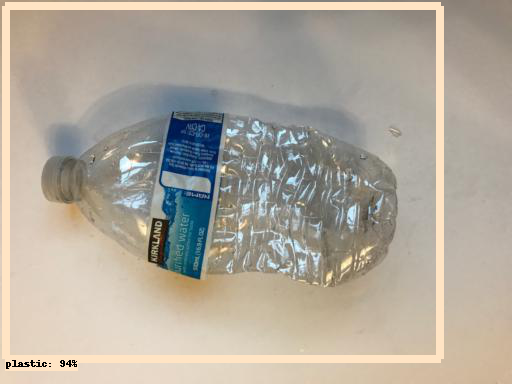

[0.9384976  0.15477668 0.08518089 0.08072095 0.07901648 0.07537519
 0.06708512 0.065361   0.06262327 0.05845346 0.05823857 0.05756347
 0.05475523 0.05376732 0.05371035 0.05248486 0.04937368 0.04710629
 0.04700067 0.04625413 0.04562478 0.04551762 0.04503961 0.04503015
 0.04482864 0.04463097 0.04402252 0.04311534 0.04301396 0.04224231
 0.04205096 0.04091924 0.04005596 0.03984578 0.03956941 0.03956333
 0.03951789 0.03898989 0.03846161 0.03831672 0.03810826 0.03754357
 0.03691868 0.03633979 0.03615274 0.03612517 0.0360073  0.0357152
 0.03559085 0.03543827 0.0352211  0.03508376 0.03506527 0.03490717
 0.0347944  0.03439528 0.03433818 0.03413828 0.03401465 0.03396274
 0.03385036 0.03355007 0.03317658 0.03310429 0.03299568 0.03293652
 0.03241914 0.03229166 0.03220018 0.03215544 0.03164202 0.03147307
 0.03139999 0.03139274 0.0312828  0.03088306 0.03077502 0.03075309
 0.03075298 0.03073933 0.03060643 0.0305357  0.03048857 0.03038484
 0.03037953 0.03028976 0.03022351 0.03018016 0.0300092  0.02993

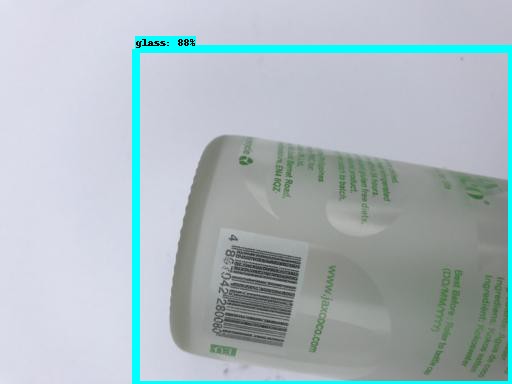

[0.88399595 0.12806153 0.11542703 0.10033774 0.099067   0.09786731
 0.08795545 0.08617481 0.08037265 0.0794083  0.07882915 0.07267648
 0.06971879 0.06962138 0.06921792 0.06854047 0.06455884 0.06396061
 0.06255973 0.06145041 0.06035216 0.05979165 0.05948139 0.05848213
 0.05818619 0.05695017 0.05630765 0.05599216 0.05554176 0.05509554
 0.05402587 0.05298019 0.05272956 0.05209325 0.05150058 0.0507881
 0.05057409 0.04970096 0.04934275 0.04830575 0.04754332 0.04642429
 0.04640114 0.04612804 0.04601204 0.0459285  0.04390305 0.04357156
 0.04338285 0.04288017 0.0427324  0.04125725 0.04124879 0.04094888
 0.04088141 0.04031435 0.03915643 0.03909051 0.03882463 0.03807404
 0.03803968 0.03788094 0.03785677 0.03737053 0.03729772 0.03728841
 0.03714504 0.03703392 0.03701906 0.03644783 0.03643971 0.03628405
 0.03627198 0.03590727 0.03579166 0.03573567 0.03494691 0.03469508
 0.03459131 0.03457069 0.03418813 0.03394239 0.03353655 0.03328323
 0.0331669  0.03308349 0.0329866  0.03289076 0.03265923 0.03253

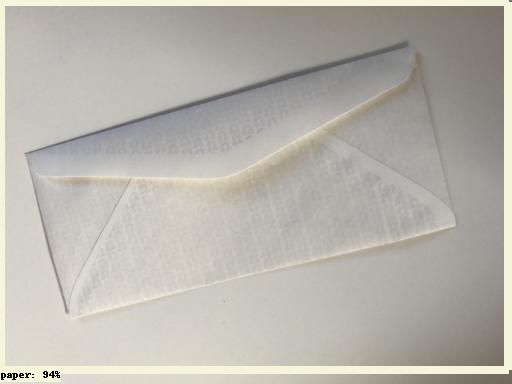

[0.937407   0.1016151  0.08972677 0.08286175 0.0756206  0.06639584
 0.06602078 0.06325637 0.06230849 0.05821614 0.05754029 0.05710442
 0.05396246 0.05226754 0.05188192 0.05062617 0.04923627 0.04885975
 0.04748459 0.04712099 0.04589544 0.04451766 0.04429451 0.04418168
 0.0439446  0.04378791 0.04303288 0.04146445 0.04052219 0.039991
 0.039014   0.03788537 0.03764556 0.03744664 0.03709083 0.0369589
 0.03688457 0.03602859 0.03581545 0.03479227 0.03476742 0.03461958
 0.03441205 0.03387357 0.03368609 0.0336042  0.03314406 0.03292868
 0.03292123 0.03276062 0.03266813 0.03266004 0.032571   0.03246236
 0.03242588 0.03239886 0.03230804 0.03210847 0.03201447 0.03189351
 0.03178177 0.03159037 0.03156027 0.03134342 0.03115168 0.0309579
 0.03021306 0.03002986 0.03001238 0.0299518  0.02994516 0.02989406
 0.0298728  0.02945057 0.02897026 0.02854362 0.02849723 0.02839584
 0.02819032 0.02816338 0.02796905 0.02786044 0.02770922 0.02754056
 0.02733847 0.02728656 0.02728218 0.02721267 0.02719988 0.0270442


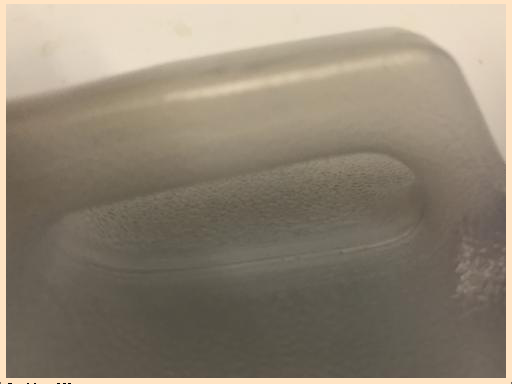

[0.92492837 0.13283664 0.10451736 0.10277892 0.09308641 0.08736799
 0.08317553 0.08137253 0.07564662 0.06861484 0.06742529 0.05808363
 0.0511964  0.04886553 0.04697832 0.04463436 0.04454844 0.04431038
 0.04266109 0.04251324 0.04117865 0.04047722 0.04042056 0.040386
 0.03886987 0.03863249 0.03803542 0.03720988 0.03710018 0.03699506
 0.03687448 0.03629819 0.0361187  0.03588975 0.03532631 0.03529345
 0.03523554 0.03496104 0.03488039 0.03460076 0.03459576 0.03423227
 0.03394037 0.03378619 0.03315804 0.03305363 0.03300026 0.03185683
 0.0316623  0.03133395 0.03130671 0.03088957 0.03069884 0.03012879
 0.02980833 0.02972797 0.02971387 0.02970166 0.02963865 0.02954357
 0.02923901 0.02898759 0.02887086 0.02860417 0.0285448  0.02816983
 0.02800392 0.02778293 0.02775466 0.02761457 0.02753399 0.02752694
 0.02749639 0.02740256 0.02734368 0.02722346 0.0271679  0.02681767
 0.02675826 0.02670093 0.02666318 0.02660199 0.02655152 0.02617338
 0.02597281 0.02596012 0.02566802 0.02561541 0.0253625  0.025361

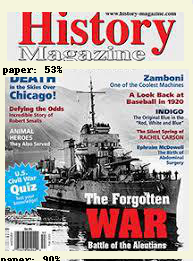

[0.9008894  0.5302277  0.3493182  0.16987015 0.16893017 0.15028243
 0.1322704  0.1295057  0.11397456 0.11136421 0.10535246 0.10282318
 0.10238833 0.10063384 0.09733614 0.09435032 0.09402513 0.09187435
 0.09047476 0.08948925 0.0888903  0.0842527  0.08354856 0.08274824
 0.08069839 0.08018846 0.07964355 0.07726938 0.07550385 0.07428875
 0.06573685 0.06484641 0.06449285 0.0627331  0.06238167 0.06149068
 0.05980974 0.0581377  0.05743663 0.05680167 0.05667841 0.05469748
 0.05262996 0.05243849 0.05235117 0.05231604 0.05085785 0.04983787
 0.04948741 0.04842895 0.04801441 0.04709849 0.04700058 0.04683772
 0.04682431 0.04517138 0.04499554 0.04495043 0.04461347 0.04450751
 0.04422923 0.04359242 0.04302408 0.04294081 0.04174281 0.04105187
 0.04081349 0.04054932 0.04053063 0.04011432 0.03975616 0.03941219
 0.03857327 0.03856882 0.03816504 0.03816479 0.03772541 0.03770074
 0.03750178 0.03735717 0.03683042 0.036394   0.03633815 0.03632764
 0.03590371 0.03588979 0.03583077 0.03580923 0.03579368 0.0356

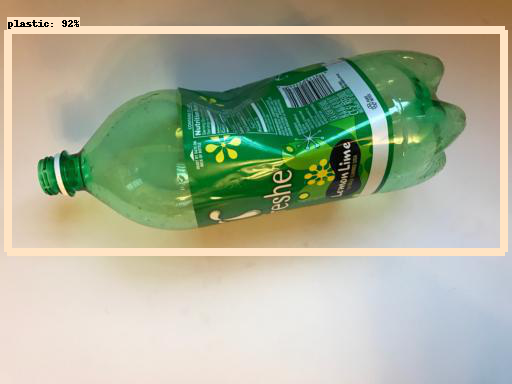

[0.91997087 0.16671185 0.16535823 0.14253691 0.14229651 0.13805944
 0.12346777 0.1228725  0.10909042 0.10590864 0.10170253 0.09817502
 0.09725953 0.09679177 0.09191441 0.09140977 0.08262723 0.08059002
 0.07746634 0.07481696 0.07306406 0.07276046 0.07079142 0.06800619
 0.06461448 0.06349576 0.06344757 0.05862611 0.05846736 0.05843532
 0.05762735 0.05647035 0.05646203 0.05550214 0.05443573 0.05296075
 0.05270028 0.05136336 0.05126801 0.0504669  0.04964172 0.049041
 0.04897411 0.0482911  0.04699183 0.04692988 0.04668148 0.04596099
 0.0458243  0.04576424 0.04519143 0.0449388  0.043685   0.04365756
 0.04196228 0.04186398 0.04171226 0.04135787 0.04134724 0.04064319
 0.04006024 0.03997391 0.03984137 0.03976978 0.03951513 0.0390222
 0.03878498 0.03866094 0.03851463 0.03796412 0.03785476 0.03725909
 0.03721969 0.03710159 0.03680511 0.03659543 0.03657926 0.03626116
 0.03588917 0.03587403 0.03550226 0.03543269 0.03530851 0.03511454
 0.03499518 0.03487239 0.03457222 0.03432019 0.03374608 0.0336523

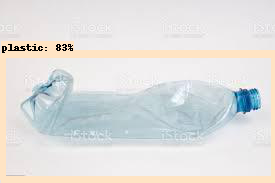

[0.8321061  0.17473927 0.12424825 0.10909376 0.10619923 0.10342668
 0.0934822  0.09320029 0.09209775 0.08882475 0.08828539 0.0867578
 0.08546645 0.08530081 0.08415634 0.07939676 0.07901818 0.07893944
 0.07862385 0.07802151 0.07692239 0.07604187 0.07446403 0.07247511
 0.07219376 0.07034257 0.07018527 0.06994621 0.06941424 0.06844532
 0.06810211 0.06733666 0.06673664 0.0666352  0.06602756 0.06571389
 0.06412537 0.0639125  0.0636875  0.06336188 0.06315181 0.06274898
 0.06166108 0.06123182 0.0610537  0.06082747 0.05898933 0.05879284
 0.05821162 0.05793199 0.05768863 0.05755941 0.05737664 0.05736056
 0.05704014 0.05674546 0.05664525 0.05654816 0.05567146 0.05547503
 0.05488294 0.05475147 0.05424409 0.05416789 0.05312168 0.05305558
 0.05250578 0.05247837 0.0512954  0.05096241 0.04948719 0.04924533
 0.04900083 0.04860189 0.04843043 0.04818631 0.04738065 0.04731417
 0.04697344 0.04667611 0.04665112 0.04622535 0.04619495 0.04588757
 0.04552229 0.04527075 0.04451642 0.0441592  0.04376742 0.04367

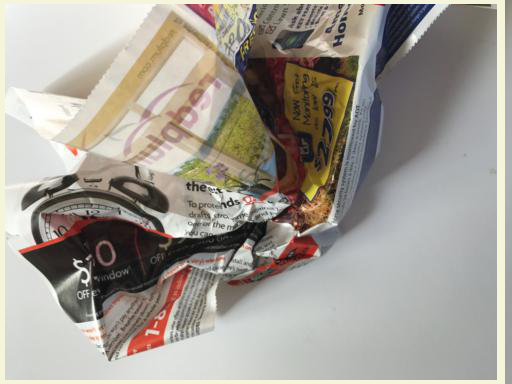

[0.93146026 0.10878834 0.09159657 0.0877227  0.07405467 0.06277681
 0.05781639 0.05453002 0.05436391 0.05226703 0.04644344 0.04406537
 0.04235133 0.04096613 0.04007388 0.03994124 0.03951388 0.03841422
 0.03787626 0.03717599 0.03649057 0.03581515 0.03569726 0.03433296
 0.03362579 0.03356878 0.03345165 0.03301758 0.03285059 0.03251553
 0.03245794 0.03199866 0.0316389  0.03110454 0.03027254 0.03022484
 0.03002588 0.02989711 0.0296488  0.02938046 0.02931368 0.02930213
 0.02908761 0.02874486 0.02852986 0.02850664 0.02822014 0.02816993
 0.02801197 0.02799653 0.02764113 0.02742558 0.02739306 0.02723019
 0.02716533 0.0271342  0.02693873 0.02670518 0.02663617 0.02657995
 0.02650212 0.0264461  0.02637013 0.02623652 0.02623511 0.02622322
 0.02599677 0.02584157 0.02577558 0.02565819 0.02562127 0.02558766
 0.02549089 0.02548285 0.02541612 0.02539135 0.02538026 0.02519186
 0.02514531 0.02514144 0.02510512 0.02489159 0.02474209 0.0247295
 0.02432557 0.02431328 0.02428905 0.02420601 0.02419542 0.02417

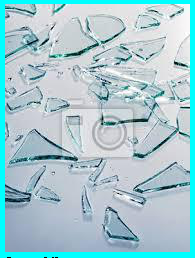

[0.93713117 0.22814082 0.13881642 0.12793685 0.10896192 0.09067856
 0.07964975 0.07927188 0.07682125 0.07599914 0.07365455 0.06999148
 0.06454333 0.06377554 0.06296566 0.0597325  0.05489621 0.05437908
 0.05424568 0.05341664 0.05331455 0.05272648 0.05097602 0.05049686
 0.05044794 0.04884535 0.04863889 0.04841517 0.04818702 0.04772948
 0.04770745 0.04706241 0.04600708 0.04594609 0.04405212 0.04383369
 0.04348668 0.04210195 0.04190178 0.03975186 0.03953443 0.03936245
 0.0387447  0.03859336 0.03785003 0.03682686 0.03625464 0.03603314
 0.03542838 0.03519308 0.0351585  0.03474383 0.03459989 0.03337
 0.03321927 0.03310165 0.03306684 0.0329556  0.03206703 0.03165505
 0.03164588 0.03156919 0.03134135 0.0313322  0.0313118  0.03131017
 0.03076266 0.03052575 0.03043491 0.03035768 0.03019308 0.03002862
 0.02991024 0.02985999 0.02953716 0.02947721 0.02901759 0.02901025
 0.02797992 0.02780419 0.0277199  0.02769896 0.02766476 0.02747075
 0.02744276 0.02736108 0.02710133 0.02702075 0.02695951 0.0268215

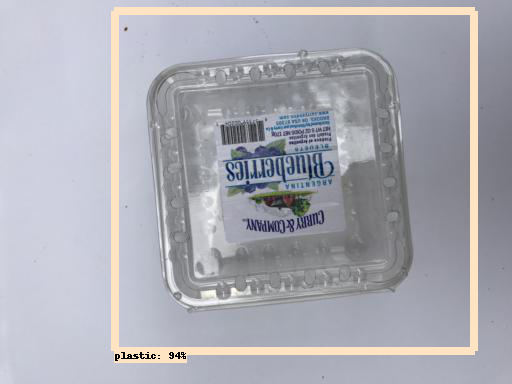

[0.93697447 0.18196674 0.16368382 0.15121156 0.13121517 0.10492286
 0.09919818 0.08208643 0.08011311 0.07995337 0.07781579 0.07383057
 0.06585602 0.06416517 0.06405721 0.06259766 0.06072593 0.05830796
 0.05677058 0.0546531  0.05448234 0.05244267 0.0507585  0.05011364
 0.04700128 0.04505752 0.04451487 0.0438069  0.04374857 0.04315512
 0.04263605 0.0412082  0.04017657 0.04004357 0.03998186 0.03951219
 0.03950632 0.03884198 0.03882982 0.03764004 0.0374135  0.0370731
 0.0369711  0.0365297  0.0364753  0.03610506 0.03610116 0.03511911
 0.03493551 0.03487737 0.03425026 0.03405762 0.03355076 0.03306009
 0.03299864 0.03279387 0.03277152 0.03242872 0.03189186 0.03180785
 0.03156756 0.03145568 0.03132399 0.03107705 0.03105572 0.03083096
 0.03073559 0.03053096 0.03016573 0.03015852 0.03008349 0.02983664
 0.02976434 0.02949572 0.02948975 0.02942125 0.02916929 0.02904754
 0.02878126 0.02861899 0.02858584 0.02844174 0.02836766 0.02813961
 0.02803828 0.02793342 0.0278692  0.02760025 0.027566   0.02754

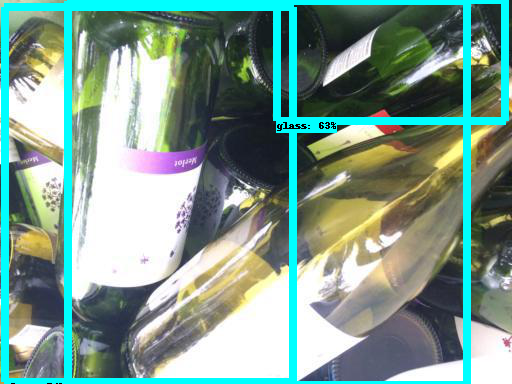

[0.8935615  0.7359107  0.6274247  0.32007453 0.3160971  0.21862955
 0.19244179 0.14725728 0.1350388  0.12829113 0.12752795 0.12573574
 0.11716633 0.1085264  0.10529868 0.09708223 0.09121541 0.08697398
 0.08213653 0.08058621 0.07936139 0.07836927 0.07781576 0.07699288
 0.07547098 0.07499821 0.07347318 0.07311857 0.07136834 0.06801104
 0.06638696 0.0645585  0.06419453 0.06399417 0.06216433 0.06150323
 0.06079609 0.05904372 0.058965   0.05755676 0.0575351  0.05700248
 0.05673351 0.05669208 0.05531942 0.0530448  0.05259302 0.05255038
 0.05249448 0.05110081 0.05080019 0.05022293 0.05013498 0.04945438
 0.04896963 0.04862698 0.04822641 0.04704677 0.04671638 0.04530368
 0.04488231 0.04457752 0.04439676 0.04438438 0.04345007 0.04325661
 0.04275363 0.04236327 0.04200044 0.0419709  0.04178973 0.04145147
 0.04137538 0.04087507 0.04087248 0.04081178 0.0405314  0.04042912
 0.04037348 0.04034343 0.04034022 0.04025718 0.04007897 0.04004752
 0.03994329 0.03957435 0.03912927 0.03900553 0.03892967 0.0386

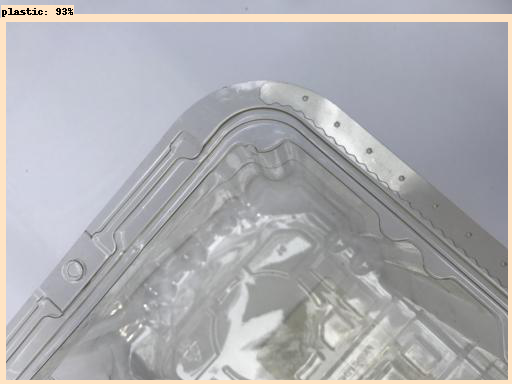

[0.93326503 0.1429333  0.09831638 0.09256749 0.08720946 0.084602
 0.07732294 0.07502262 0.06777391 0.06673978 0.06639156 0.06538422
 0.06496038 0.06008302 0.05948882 0.05937988 0.05928356 0.05541658
 0.05535375 0.05529442 0.05417038 0.05256937 0.05252175 0.05156156
 0.05148805 0.0492372  0.04905326 0.04850023 0.04845172 0.04826178
 0.04682112 0.04623382 0.04606311 0.04572475 0.04565341 0.04519232
 0.04325226 0.04305672 0.0425683  0.04142105 0.04139487 0.04121669
 0.04081585 0.04077073 0.04022003 0.04003971 0.03984123 0.03946707
 0.03942119 0.03896856 0.03889575 0.03841057 0.03817341 0.03745074
 0.03693213 0.03658203 0.03637685 0.03631644 0.03626917 0.03584517
 0.03570653 0.03560852 0.03532818 0.03531624 0.03498666 0.03478281
 0.03473096 0.03431113 0.0342835  0.03383408 0.03341697 0.03304728
 0.0330102  0.03271695 0.03264667 0.03249446 0.0324287  0.03233683
 0.03172353 0.03157181 0.03144926 0.03129736 0.0312373  0.03109106
 0.03083813 0.03050858 0.02990991 0.02977144 0.02937602 0.029167

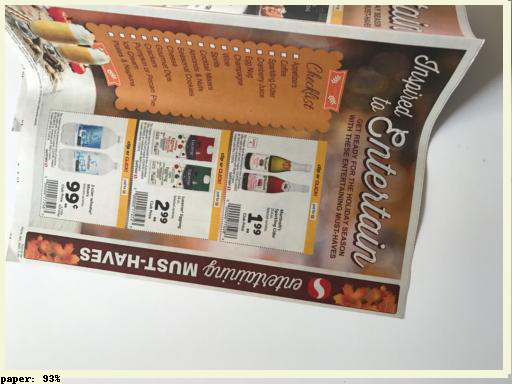

[0.9311956  0.11611914 0.10362282 0.07751358 0.07162234 0.07069398
 0.07051258 0.06837625 0.06771719 0.06651903 0.06544628 0.06538203
 0.06164829 0.06068435 0.06052909 0.06031203 0.05999469 0.0585635
 0.05666826 0.05267399 0.05112967 0.05043836 0.05026675 0.05002729
 0.04970827 0.04967064 0.04881005 0.04604121 0.04459108 0.04404164
 0.04258268 0.04163505 0.04127672 0.04098156 0.04084848 0.03877755
 0.03877425 0.03847046 0.03830117 0.0382704  0.0380288  0.03781859
 0.03766973 0.0374016  0.0371711  0.03672656 0.03611368 0.03554827
 0.03554411 0.03530153 0.03511841 0.03471977 0.03458558 0.03420692
 0.03388296 0.03384792 0.03369001 0.03362432 0.03355258 0.03346242
 0.03259212 0.03257192 0.03213491 0.03193118 0.03189632 0.03167837
 0.03123993 0.03101165 0.03076824 0.03067769 0.03035736 0.03021119
 0.02999072 0.02986352 0.02971835 0.02959788 0.02952847 0.0294363
 0.02939452 0.02933667 0.02929443 0.02925066 0.02918468 0.02849017
 0.02848325 0.02847513 0.02832628 0.02827563 0.02817403 0.028152

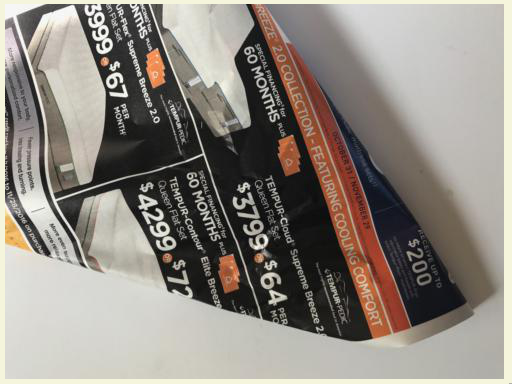

[0.9453736  0.1190781  0.08876669 0.08399331 0.06491629 0.06421387
 0.05707432 0.05668118 0.05370429 0.05345431 0.04962191 0.04948833
 0.0473879  0.04614089 0.0450958  0.0430482  0.04012109 0.0389597
 0.03888655 0.03799286 0.03782082 0.03772046 0.03666352 0.03560827
 0.03541986 0.03510933 0.03425634 0.03400235 0.03376673 0.03359527
 0.03342761 0.03340508 0.0332752  0.03309164 0.03288271 0.03258025
 0.03229595 0.03199159 0.03174343 0.03150786 0.03134805 0.0313212
 0.03093071 0.03030727 0.03010912 0.0296794  0.02925576 0.02874853
 0.02870778 0.02810883 0.02809063 0.02784885 0.02784449 0.02748816
 0.02718486 0.02687008 0.02686047 0.02648726 0.02602503 0.02524975
 0.02524691 0.02519841 0.02512068 0.02484433 0.02458854 0.02445897
 0.02401887 0.02399531 0.02388634 0.02367568 0.0233753  0.02336548
 0.02318009 0.02317305 0.0231314  0.02304607 0.02295561 0.02294117
 0.02284291 0.0224916  0.02241393 0.02238654 0.02226287 0.02222819
 0.02216581 0.0221459  0.02214319 0.02203309 0.02201849 0.021846

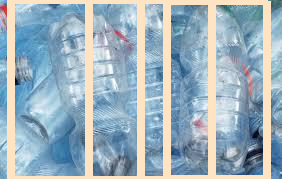

[0.88108534 0.8017407  0.6821928  0.4448554  0.42345655 0.38495633
 0.2977222  0.26790175 0.25640082 0.2348311  0.18704227 0.17409846
 0.16546883 0.15559804 0.15364659 0.15087591 0.14740665 0.1424656
 0.13902254 0.13316976 0.12223898 0.12204088 0.11387992 0.11155084
 0.10882186 0.1037469  0.10312185 0.09911104 0.09478877 0.09472615
 0.0905166  0.08853982 0.08679216 0.08168586 0.08006915 0.07915372
 0.07878242 0.07843115 0.07833633 0.07586166 0.07537372 0.07527564
 0.07467113 0.07436763 0.07410152 0.07306315 0.07295879 0.07184993
 0.07160725 0.07158777 0.07086676 0.07054484 0.06932978 0.0679741
 0.06758205 0.06616892 0.06614444 0.06589942 0.06563028 0.0654932
 0.06460506 0.06443334 0.06423366 0.06376316 0.06290271 0.06282274
 0.06062885 0.05928191 0.05865638 0.05715315 0.05682851 0.05609785
 0.05597768 0.05563792 0.05516408 0.05510396 0.05487136 0.05483872
 0.05467119 0.05442662 0.05419428 0.05386823 0.05350383 0.05337366
 0.05319024 0.0528595  0.05191258 0.05181115 0.05149119 0.0512144

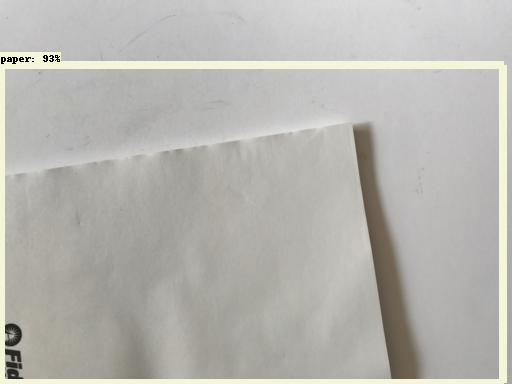

[0.93394893 0.10069205 0.0850367  0.08417813 0.07406359 0.06977972
 0.06727237 0.0670133  0.06557597 0.06301514 0.06038947 0.05964558
 0.05831561 0.05591257 0.05548725 0.05422477 0.0542069  0.05409871
 0.05167388 0.05107925 0.05064131 0.05035632 0.05002043 0.0496769
 0.04938703 0.04922557 0.0491772  0.04766727 0.04703161 0.04583974
 0.04562528 0.04451797 0.04387529 0.04008213 0.03971573 0.03938067
 0.03916189 0.03857214 0.03805758 0.0375653  0.0375435  0.03742734
 0.03627023 0.03627021 0.03577434 0.03505756 0.03492532 0.03473531
 0.03452306 0.03431952 0.03421995 0.03395951 0.03378744 0.03363734
 0.03333008 0.03310218 0.03285397 0.0327337  0.0326639  0.03260885
 0.03252311 0.03250238 0.03247277 0.03231022 0.03195958 0.03180693
 0.03172174 0.03170052 0.03168506 0.03167705 0.03154057 0.03153889
 0.03150629 0.03140891 0.03136297 0.03134694 0.03095693 0.03071446
 0.03062059 0.03054396 0.03040007 0.03033992 0.0301085  0.03002363
 0.02998735 0.0293164  0.02929549 0.02924264 0.02922788 0.02903

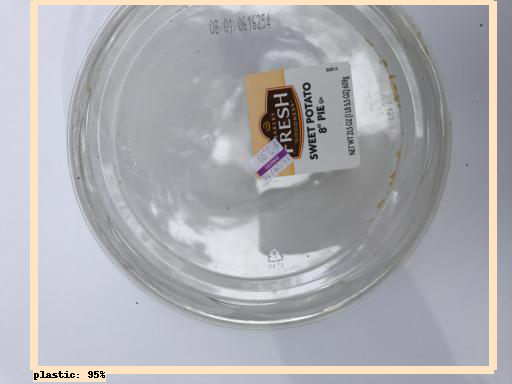

[0.94555295 0.13710283 0.10101403 0.07599464 0.07507007 0.07410207
 0.07082655 0.07029029 0.06780899 0.04724935 0.0471706  0.0437975
 0.0427874  0.04228485 0.04038095 0.03916668 0.03856505 0.03690206
 0.03547023 0.03445629 0.03445346 0.03444349 0.03403568 0.0337361
 0.0335714  0.03324694 0.03311536 0.03281045 0.03255436 0.03233486
 0.03189132 0.03146154 0.03116601 0.03066997 0.03021192 0.0301974
 0.03016072 0.03007019 0.02998994 0.02998278 0.02990234 0.02984285
 0.02975596 0.02948191 0.02943215 0.02922478 0.02922318 0.02821357
 0.02804555 0.02731424 0.02728612 0.02726603 0.02714729 0.02683038
 0.02664705 0.02659242 0.02622106 0.02590206 0.02589922 0.0257329
 0.0255177  0.02521462 0.02515733 0.02511333 0.02495251 0.02492352
 0.02478227 0.02426843 0.02402289 0.0236799  0.0235265  0.02338783
 0.0233049  0.0232957  0.02310144 0.02305079 0.02288177 0.02276024
 0.02269364 0.02267822 0.02266033 0.02263467 0.02260347 0.02259352
 0.02238511 0.02237601 0.02225495 0.02212322 0.0220055  0.02198213

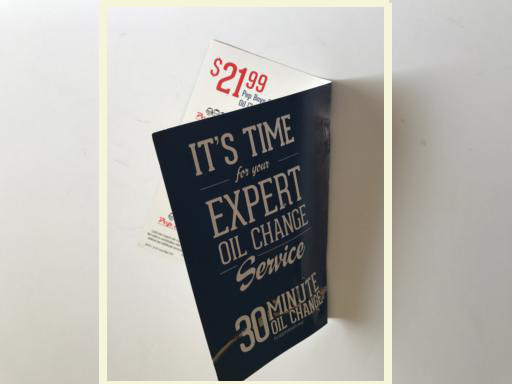

[0.91476417 0.2958558  0.25407183 0.22729664 0.21861602 0.19684584
 0.12663032 0.11350832 0.10470615 0.10339224 0.09630952 0.09450091
 0.09448747 0.09023985 0.0899929  0.08639051 0.08194305 0.08112696
 0.07839371 0.07826703 0.07475431 0.07338831 0.07320233 0.07284644
 0.07204413 0.07026113 0.06899291 0.06894284 0.06749031 0.06717627
 0.06598433 0.06441721 0.06417097 0.06400762 0.06388173 0.0637713
 0.06293757 0.06181    0.05989207 0.05819595 0.05721056 0.05697212
 0.05648279 0.05646476 0.05625805 0.05624472 0.05615566 0.05601588
 0.05573361 0.05568922 0.05406268 0.05240654 0.05210161 0.05186132
 0.05125656 0.0509754  0.05044398 0.04954736 0.04893432 0.04838967
 0.04826584 0.04771125 0.04759373 0.04694436 0.04610186 0.04604563
 0.04588364 0.04508957 0.04422008 0.04381636 0.04336477 0.04334667
 0.04289465 0.04246437 0.04200495 0.041946   0.04151    0.04147126
 0.04123148 0.0409714  0.04076803 0.04058712 0.04034543 0.04008689
 0.04008169 0.03990611 0.03986156 0.03980592 0.03977831 0.03973

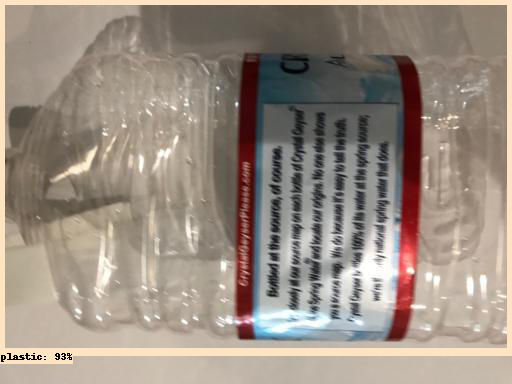

[0.9252202  0.19803958 0.19304375 0.19200331 0.13789792 0.1227446
 0.11669425 0.11590815 0.11543519 0.11531245 0.11110287 0.10496674
 0.10159007 0.09855895 0.09768233 0.09595996 0.09595899 0.09103584
 0.08920033 0.08744014 0.08296128 0.0813517  0.08027133 0.07751213
 0.07158175 0.06893943 0.06877247 0.06561501 0.06498775 0.06427862
 0.06368078 0.06240019 0.06072355 0.06062238 0.06021025 0.06011302
 0.05991911 0.05891763 0.05855304 0.05817033 0.05773212 0.05565614
 0.05422369 0.05409903 0.05301772 0.05275561 0.05151721 0.05130809
 0.05028379 0.04988132 0.04916045 0.04896698 0.04797564 0.04796155
 0.04730827 0.04680479 0.04658127 0.04647511 0.04618444 0.04598826
 0.04598201 0.04530169 0.04451134 0.04401823 0.04380358 0.04358678
 0.04281858 0.04273381 0.04260392 0.04125593 0.04089292 0.0407085
 0.04026498 0.04025785 0.04007179 0.03970917 0.03954433 0.0394526
 0.03914941 0.03892525 0.03863535 0.03849589 0.03837448 0.03822004
 0.03816365 0.03803091 0.03773551 0.03761999 0.03703407 0.0367611

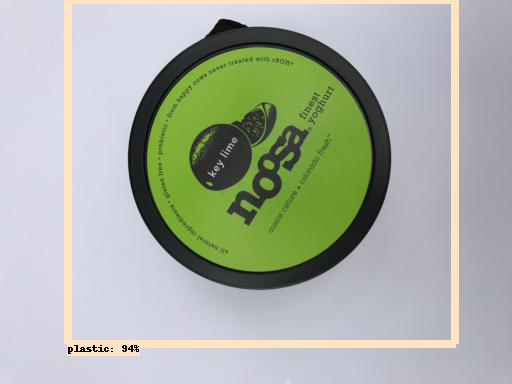

[0.943856   0.14032154 0.13283205 0.10761707 0.09066085 0.08719508
 0.07501515 0.06879179 0.06818724 0.06462695 0.06310196 0.06258795
 0.05873994 0.05792668 0.05613653 0.05334141 0.05310739 0.05199113
 0.04979828 0.0487358  0.04863618 0.04858993 0.04837976 0.04835254
 0.04807774 0.04771056 0.0461197  0.04501295 0.04474171 0.04435811
 0.0442924  0.04367518 0.04347773 0.04296514 0.04280836 0.0427402
 0.04228593 0.04189472 0.04126755 0.04011451 0.03992229 0.03931752
 0.03806787 0.03757244 0.03702754 0.03586283 0.03571113 0.03553323
 0.03534714 0.03516874 0.03461009 0.03438281 0.03423817 0.03381775
 0.03329949 0.03311705 0.03308963 0.03297334 0.03289545 0.03273646
 0.03208127 0.03207064 0.03204709 0.03195354 0.03120799 0.03105146
 0.03102075 0.03091586 0.03081159 0.03076901 0.03076001 0.0306688
 0.03065018 0.03063522 0.03038911 0.03038082 0.02994195 0.02991279
 0.02957109 0.02888613 0.02852833 0.02844036 0.02843157 0.02826251
 0.02825883 0.02810112 0.02795032 0.02791296 0.02772365 0.027719

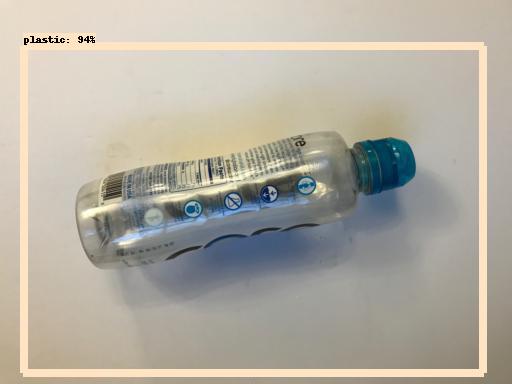

[0.9381519  0.12780915 0.10132255 0.08112584 0.07426018 0.07109136
 0.07011113 0.06501023 0.06460217 0.0640007  0.0639829  0.06332114
 0.06327765 0.05850643 0.05767511 0.05689764 0.0554225  0.0544779
 0.05266502 0.05243206 0.05222772 0.0517838  0.05000788 0.0499864
 0.04950637 0.04884579 0.04819993 0.04757722 0.0472865  0.04685733
 0.04665354 0.04654804 0.04574485 0.04558956 0.04516121 0.04445684
 0.04371015 0.04324044 0.04298102 0.04294348 0.04263914 0.04262701
 0.04220964 0.04192326 0.04189797 0.04104635 0.04092334 0.04053168
 0.04048735 0.04017084 0.0399724  0.03946137 0.03870685 0.03868215
 0.03842466 0.03818192 0.03803676 0.03801041 0.0378994  0.03787065
 0.03759098 0.03757866 0.03733412 0.03725251 0.03697018 0.03692232
 0.03684723 0.03640963 0.03635737 0.03634274 0.03584512 0.03581665
 0.03576376 0.0354961  0.03511418 0.034713   0.03457541 0.03450759
 0.03427202 0.03409732 0.03400886 0.03382934 0.03355356 0.03342674
 0.033342   0.03320058 0.03312323 0.03272197 0.03255633 0.032374

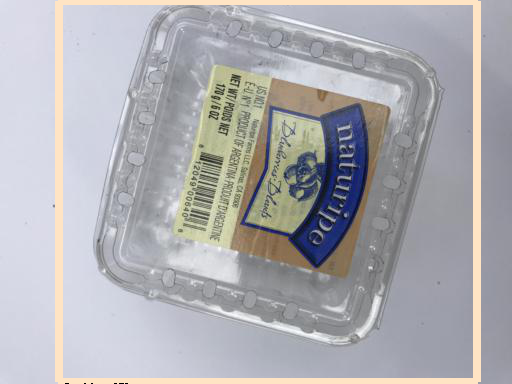

[0.9494478  0.1803984  0.12397776 0.11038703 0.10477857 0.10299861
 0.06254564 0.05761186 0.05490187 0.0469177  0.04657312 0.04404475
 0.04362637 0.04180645 0.04050032 0.0402049  0.03862092 0.03604041
 0.0359684  0.03568337 0.03492604 0.03434955 0.03434345 0.03399831
 0.03391801 0.03344012 0.03324262 0.0324478  0.0323711  0.03184059
 0.03180116 0.03177504 0.03168658 0.0312709  0.03093379 0.03076595
 0.02991506 0.02960181 0.02864596 0.02858283 0.02855871 0.02834064
 0.02812221 0.02801646 0.02731391 0.02728858 0.02724968 0.02685894
 0.02656891 0.02644066 0.02636228 0.02624104 0.02604665 0.02597821
 0.02569361 0.02561276 0.02558191 0.02530624 0.0252809  0.02523135
 0.02521865 0.02504171 0.02485736 0.02481878 0.02478267 0.02456733
 0.02447806 0.02410509 0.0240996  0.02408013 0.02397828 0.02394407
 0.02392132 0.02379321 0.02378    0.02361874 0.02360187 0.02359843
 0.02341137 0.02323157 0.02276486 0.02260893 0.02257629 0.02256393
 0.02237008 0.02232353 0.02206139 0.02201865 0.02196143 0.0218

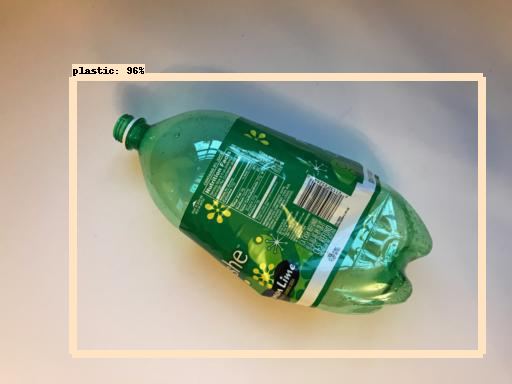

[0.95940584 0.22099368 0.11679667 0.10429114 0.09998485 0.09754241
 0.09469961 0.08769479 0.0808657  0.07729083 0.06984372 0.06964272
 0.06898285 0.06758122 0.06609085 0.06554011 0.0630609  0.06295308
 0.0617571  0.06129469 0.0610352  0.05984296 0.05898077 0.05812358
 0.05792654 0.05626766 0.05613381 0.05521531 0.05517234 0.054064
 0.05334669 0.05225981 0.05169935 0.0503528  0.04959572 0.04837426
 0.0475952  0.04737194 0.04714492 0.04675999 0.0455445  0.04521574
 0.0445408  0.04443813 0.04363783 0.0436286  0.04342243 0.04337949
 0.04332979 0.04253513 0.0422859  0.04178079 0.04176879 0.04154342
 0.04150521 0.04120134 0.04115398 0.04095738 0.04081713 0.04074611
 0.04012682 0.03994601 0.0398715  0.03970601 0.03965721 0.0391096
 0.03854958 0.03852626 0.03823935 0.03801116 0.03787578 0.03781004
 0.03738117 0.03708797 0.03706486 0.03682794 0.03673143 0.03625933
 0.03609617 0.03603987 0.03589129 0.03583382 0.03581448 0.03564416
 0.03545731 0.03522732 0.03446541 0.03356836 0.03337164 0.0330453

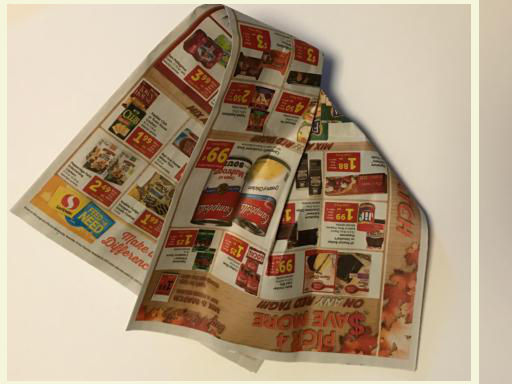

[0.94187856 0.09700816 0.08665286 0.08602688 0.07328529 0.0672733
 0.06136114 0.06055714 0.06016447 0.05933765 0.05818292 0.05729166
 0.05397639 0.04972559 0.04922517 0.04877212 0.04870017 0.04780533
 0.04553387 0.04454843 0.0431826  0.04308912 0.04183117 0.04163704
 0.04148582 0.04085773 0.04080577 0.04079913 0.03869173 0.03813039
 0.03773925 0.03718446 0.0371142  0.03678762 0.03670994 0.03665884
 0.03619199 0.03593647 0.03593289 0.03536046 0.03444378 0.03403686
 0.03243567 0.03226917 0.03201933 0.03199325 0.03125651 0.03099406
 0.03095732 0.03079313 0.03060267 0.03060207 0.03044535 0.03044322
 0.030242   0.03009502 0.03005393 0.03001317 0.03000802 0.02974754
 0.02950429 0.0294697  0.02944888 0.02920648 0.02891131 0.02890932
 0.02874629 0.02858417 0.02841984 0.02839473 0.02829935 0.02828307
 0.02785246 0.02783496 0.02770045 0.02767375 0.02731248 0.02729118
 0.02721477 0.02677701 0.02673586 0.02665247 0.02643051 0.02637584
 0.02597243 0.02593297 0.02590876 0.02558322 0.02547015 0.02506

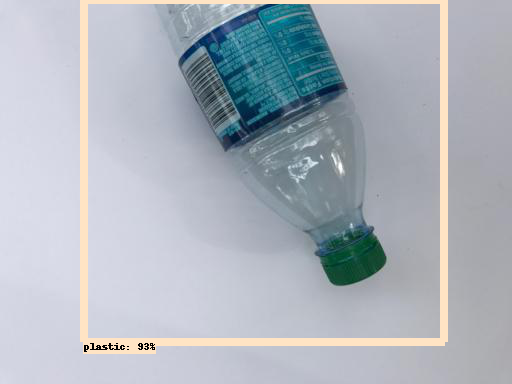

[0.9253672  0.12409974 0.12347318 0.12318571 0.1226803  0.12128637
 0.1028906  0.08576779 0.07618837 0.07567374 0.07226851 0.0711263
 0.06991926 0.06364475 0.06294695 0.06088657 0.057883   0.05673208
 0.05523578 0.05516043 0.05215391 0.05151328 0.05150546 0.05113035
 0.0503768  0.05009488 0.04994298 0.04959583 0.0495366  0.04932353
 0.04872798 0.04554679 0.04509951 0.04471282 0.04468687 0.04446533
 0.0443468  0.04406049 0.04324443 0.04298751 0.04139892 0.04016982
 0.04004054 0.03948541 0.03856822 0.03852076 0.03823717 0.03815887
 0.038076   0.03795713 0.03790369 0.03766137 0.03729152 0.03721701
 0.03689758 0.03679553 0.0367855  0.03642346 0.03624908 0.03597877
 0.03572664 0.03564957 0.03560743 0.03542107 0.03521065 0.03498913
 0.03480332 0.03478467 0.03454916 0.03417375 0.03416331 0.033991
 0.03341163 0.03308067 0.03301155 0.03278359 0.03273554 0.03242984
 0.03222531 0.0318942  0.03185944 0.03169646 0.0315887  0.03143678
 0.03130682 0.03126946 0.03118488 0.03108874 0.03105451 0.0304991

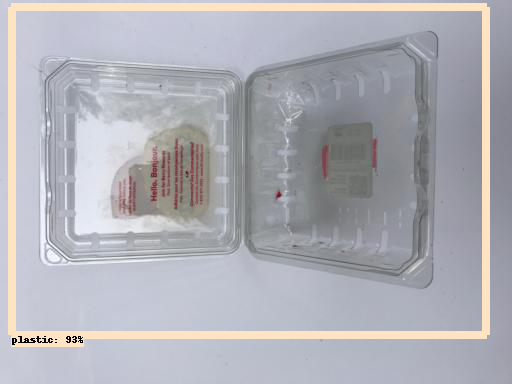

[0.93482417 0.11775204 0.11494084 0.10437241 0.10278687 0.1007328
 0.09152704 0.08778031 0.08559059 0.08505095 0.07998638 0.07653029
 0.07602712 0.07535357 0.07223006 0.0722114  0.07210173 0.07123546
 0.06433231 0.06275433 0.06268968 0.06149026 0.06127499 0.06086019
 0.05953202 0.05882103 0.0578995  0.05753971 0.05682174 0.05680978
 0.05515574 0.05437748 0.05434294 0.05058676 0.05030827 0.05018312
 0.04906902 0.04887056 0.04872074 0.0483386  0.0482172  0.04818746
 0.04782454 0.04774467 0.04773155 0.04679085 0.04656991 0.04549462
 0.04464781 0.04464403 0.04449255 0.04292083 0.04265904 0.04240517
 0.04164854 0.04163491 0.04154478 0.04111343 0.04083132 0.04009287
 0.03932402 0.03921874 0.03896651 0.03843574 0.03841207 0.03840863
 0.03774151 0.0376831  0.0375691  0.03743377 0.03726496 0.0371947
 0.03691475 0.03690925 0.03687108 0.03686763 0.03675906 0.0367041
 0.03582044 0.03556412 0.0353169  0.03516275 0.03514136 0.03497928
 0.03474516 0.03466028 0.03442245 0.03419297 0.03392493 0.0339032

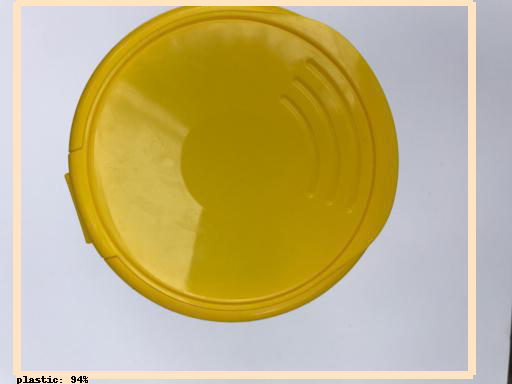

[0.9418912  0.14460872 0.10356666 0.08209281 0.07818068 0.07651275
 0.06652535 0.06582437 0.06441668 0.05907795 0.05827168 0.05716446
 0.05645847 0.05157664 0.05014949 0.04955942 0.0422042  0.04105285
 0.04073984 0.04056053 0.04045719 0.03913051 0.03627094 0.03605464
 0.03485868 0.03468281 0.03436257 0.03408405 0.03260281 0.03253946
 0.03202404 0.03196955 0.03171001 0.03170426 0.03158614 0.03147784
 0.03136548 0.03132576 0.03096859 0.03077473 0.03024391 0.03022825
 0.02993644 0.02983093 0.02976369 0.02967825 0.02939478 0.02929555
 0.02906358 0.02897578 0.02843125 0.02839551 0.02833924 0.0280962
 0.02807559 0.02800162 0.02786956 0.0275393  0.02736642 0.02735288
 0.02731019 0.02716063 0.02697486 0.02694792 0.02675371 0.02666817
 0.02657929 0.02654164 0.02630659 0.02615472 0.02615394 0.02611373
 0.0260753  0.02605667 0.02567982 0.02527958 0.02527764 0.02521299
 0.02489854 0.02486597 0.02470194 0.02458422 0.02450475 0.02446246
 0.02441532 0.02424043 0.02420237 0.02406563 0.02383223 0.02379

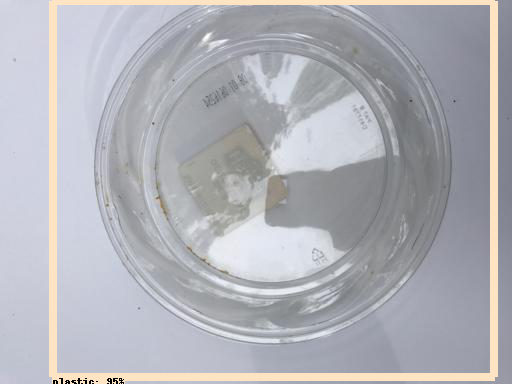

[0.9464567  0.13269141 0.1275274  0.09588989 0.08388472 0.08258664
 0.07947438 0.05898938 0.05516831 0.05047362 0.0490933  0.04906644
 0.04882128 0.04875678 0.04701224 0.0439336  0.04340917 0.04238132
 0.04211425 0.04198499 0.04034907 0.03856113 0.038091   0.03760915
 0.03735555 0.03619963 0.03603402 0.03580378 0.03473704 0.03384948
 0.03382325 0.0337926  0.03358638 0.03304074 0.03301309 0.032311
 0.03213267 0.03125504 0.03095022 0.03032154 0.03029731 0.03013821
 0.02946011 0.02921183 0.02904516 0.02862046 0.02856281 0.02785351
 0.02769616 0.02750697 0.0272222  0.02717482 0.0271004  0.02690152
 0.02684791 0.02674425 0.0264021  0.02615623 0.0257769  0.02574384
 0.02561163 0.02522905 0.02503335 0.02494956 0.02476189 0.02473491
 0.02452985 0.0244963  0.02447342 0.02446    0.02444141 0.02442286
 0.02435822 0.02432737 0.02413696 0.024111   0.02405766 0.02396133
 0.02391452 0.02387956 0.02381287 0.02378882 0.02362389 0.02356494
 0.02356135 0.02355985 0.02349743 0.02346376 0.02310478 0.023057

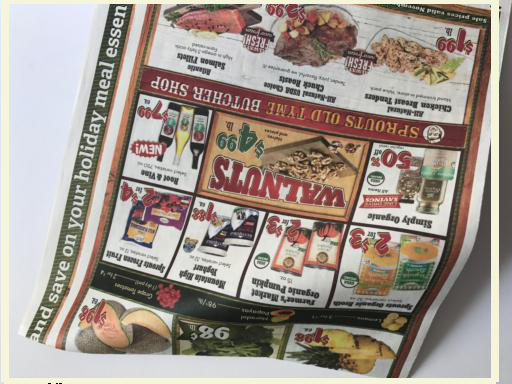

[0.94109666 0.18589526 0.11231762 0.08956087 0.08278259 0.08112302
 0.0693969  0.0682896  0.06708672 0.0649581  0.06491133 0.05496126
 0.05280522 0.04731725 0.04556483 0.04511004 0.04339285 0.0424797
 0.0421293  0.04028682 0.03980005 0.03938431 0.03912218 0.03905142
 0.03831626 0.03776327 0.03733604 0.03669444 0.03628903 0.03597621
 0.03536418 0.03533789 0.03522754 0.03473667 0.03417281 0.03336948
 0.03304332 0.03296938 0.0325216  0.03247505 0.03210574 0.03187928
 0.03162916 0.03118339 0.03113768 0.03085671 0.03082443 0.03076682
 0.02954629 0.0294881  0.02927428 0.02924067 0.02918187 0.02835432
 0.02828335 0.02824753 0.02817486 0.02746761 0.0272924  0.02726014
 0.02703441 0.02695144 0.02692225 0.02663853 0.02658201 0.02638129
 0.02632686 0.02625278 0.02624844 0.02602315 0.02574564 0.02573342
 0.02549496 0.02527313 0.02518066 0.02517108 0.02504722 0.02498117
 0.0245543  0.02445016 0.02444105 0.02406592 0.02402214 0.02395147
 0.02375308 0.02368495 0.02364359 0.02344508 0.02336113 0.02325

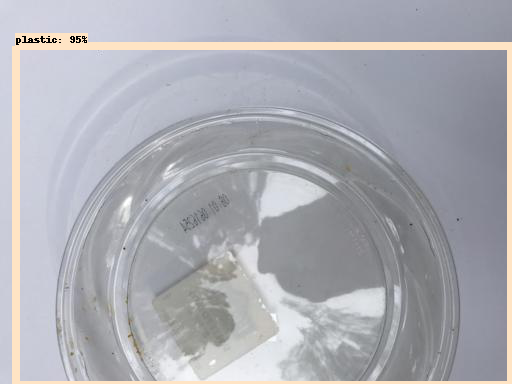

[0.9469697  0.12780157 0.07873642 0.07772112 0.07561047 0.06554777
 0.06372702 0.06240206 0.05962415 0.05878185 0.0546688  0.05290493
 0.05209226 0.05148963 0.04677176 0.04608109 0.0409033  0.04030186
 0.03904675 0.03787491 0.03748731 0.03727921 0.0372037  0.03690524
 0.03531949 0.03520201 0.03480007 0.0343997  0.03422048 0.03354765
 0.03330769 0.03241183 0.03206933 0.0315811  0.0313001  0.03120887
 0.03111581 0.03089976 0.0308081  0.0307763  0.03031695 0.02971945
 0.02946453 0.02814999 0.02799045 0.02771302 0.02770052 0.02766195
 0.02756011 0.0275134  0.02688978 0.02676149 0.02663125 0.02660422
 0.02648273 0.02642252 0.02637346 0.02632003 0.02592271 0.02586604
 0.02581241 0.02561754 0.02550089 0.02546461 0.02536091 0.02525526
 0.02521648 0.02478585 0.02478563 0.0247452  0.02455518 0.02444787
 0.02441626 0.02430014 0.02415763 0.02413439 0.02383932 0.02368417
 0.02364244 0.0235147  0.0231919  0.02310073 0.02297919 0.02297869
 0.02296442 0.02289173 0.02264165 0.0226175  0.02255533 0.0224

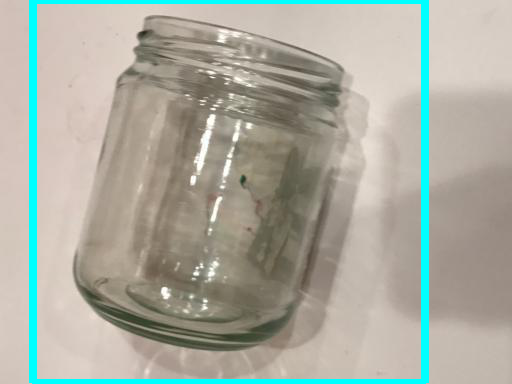

[0.9206312  0.13967033 0.12377337 0.10940479 0.10865633 0.10607243
 0.0958911  0.08798271 0.08346085 0.07688732 0.07521114 0.07432369
 0.07311954 0.06515036 0.05652781 0.0547882  0.0540978  0.05133841
 0.04704428 0.0467253  0.04646714 0.04642822 0.04611406 0.04586993
 0.04585118 0.04551417 0.04434331 0.04318582 0.04135649 0.04112775
 0.04035904 0.03990563 0.0386363  0.03816745 0.03777573 0.03733264
 0.03666671 0.03618415 0.0361089  0.03594983 0.03560707 0.03540009
 0.03489932 0.03398067 0.03393975 0.03284112 0.03273296 0.03235647
 0.03150297 0.03110869 0.03092763 0.03073128 0.03061701 0.03005655
 0.03005367 0.02998937 0.0298437  0.02969702 0.02955648 0.02942714
 0.02920084 0.0291154  0.02893896 0.02871893 0.02871179 0.02864863
 0.02853669 0.02808913 0.02799484 0.02735681 0.02727462 0.02724371
 0.02723657 0.02716907 0.02711388 0.02689868 0.02680895 0.02677162
 0.02673795 0.0263088  0.02581339 0.02576975 0.02564292 0.02552189
 0.02539324 0.02536545 0.02519709 0.02514297 0.02505329 0.0250

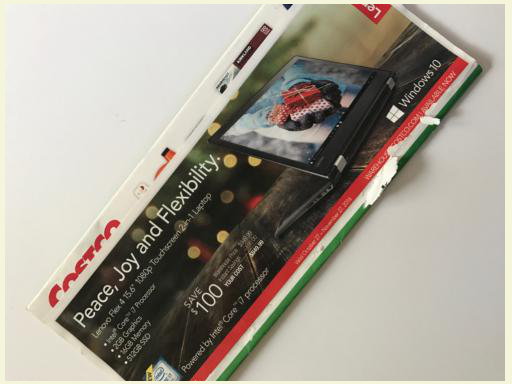

[0.92431736 0.15989354 0.09307226 0.09101054 0.0841276  0.08095462
 0.07766075 0.07542884 0.07282736 0.0667008  0.06244308 0.06075282
 0.05748691 0.05664677 0.05610585 0.05595198 0.05548197 0.05530993
 0.0522989  0.05132635 0.05035037 0.05012342 0.04852391 0.04822117
 0.04814827 0.04807545 0.04794994 0.04771059 0.04658357 0.04626649
 0.04574041 0.04566064 0.0451547  0.04511024 0.04386762 0.04317772
 0.04075414 0.04072288 0.04007297 0.03950602 0.03947478 0.03887185
 0.03874852 0.03857282 0.0383151  0.03803375 0.03788459 0.03786943
 0.03784622 0.03709584 0.03707851 0.03684216 0.03593448 0.03558846
 0.03482603 0.03473235 0.03445379 0.0344436  0.03425725 0.03414643
 0.03386153 0.03355064 0.03350871 0.03350299 0.03325661 0.03312311
 0.03276074 0.03257226 0.03234094 0.03170995 0.03153956 0.03142694
 0.03139389 0.03112343 0.03108929 0.03100782 0.0309569  0.0306462
 0.03037104 0.03034057 0.0299954  0.02968366 0.02924524 0.02908979
 0.02848119 0.02843921 0.02830103 0.02822706 0.02800331 0.02785

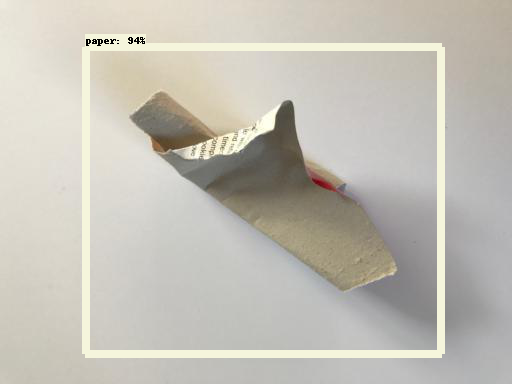

[0.9396691  0.22878395 0.15966547 0.15234166 0.14939709 0.13364577
 0.12598115 0.12243173 0.10628971 0.09802136 0.09308669 0.0900699
 0.08863016 0.08840547 0.08063064 0.07987919 0.07424533 0.07206172
 0.07122082 0.07012456 0.06976923 0.06736828 0.06717244 0.06502976
 0.06446633 0.06438997 0.06310719 0.06300355 0.06256779 0.06060536
 0.05967094 0.05956441 0.0590234  0.05868952 0.05793323 0.05764691
 0.05716274 0.05631898 0.05609676 0.05423016 0.05394812 0.05300762
 0.05233972 0.05215241 0.05098179 0.05051427 0.05032479 0.04957758
 0.04801133 0.047994   0.04797259 0.0474499  0.04733047 0.04717427
 0.04676066 0.04582166 0.04565493 0.04450504 0.04388586 0.04383251
 0.04369089 0.04345753 0.0431439  0.04302331 0.04287214 0.04253879
 0.04243119 0.04178486 0.04096175 0.04090708 0.04088158 0.04087814
 0.04083716 0.04076356 0.04062592 0.04039356 0.04018531 0.04002672
 0.03997416 0.03969597 0.03967296 0.03907727 0.03878332 0.03868715
 0.03847717 0.03842416 0.0382629  0.03823398 0.03796411 0.03775

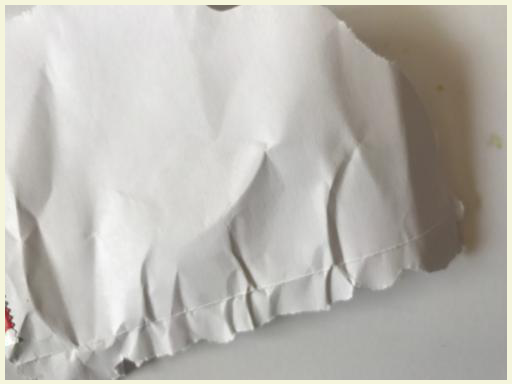

[0.946195   0.10046517 0.09236309 0.06954551 0.06515525 0.06067886
 0.05981903 0.05803636 0.05791213 0.05692217 0.05684871 0.05581231
 0.05294861 0.05206926 0.05192545 0.05015745 0.04959217 0.04694761
 0.04661687 0.04635728 0.04631971 0.0463182  0.04564185 0.04408748
 0.04395164 0.04370504 0.04319378 0.04309772 0.04305201 0.04230485
 0.03966355 0.03885904 0.03831853 0.03811248 0.03782002 0.03767362
 0.03683294 0.03670105 0.03663416 0.03548422 0.0348198  0.034716
 0.03370754 0.03347723 0.03347002 0.03276563 0.03248502 0.0321244
 0.03201434 0.03187114 0.03169833 0.03155658 0.03150854 0.03136328
 0.03103879 0.03055651 0.03044483 0.03013172 0.02980559 0.02959699
 0.02946756 0.02921443 0.02915835 0.02911315 0.02889766 0.02880726
 0.02826722 0.02821244 0.02815914 0.02778263 0.0277236  0.02745408
 0.02744055 0.0273617  0.02735349 0.02732473 0.0272311  0.02699117
 0.02674849 0.02659337 0.02653762 0.02652717 0.02645684 0.02626259
 0.02610167 0.0259656  0.02552759 0.02549384 0.02524335 0.0247305

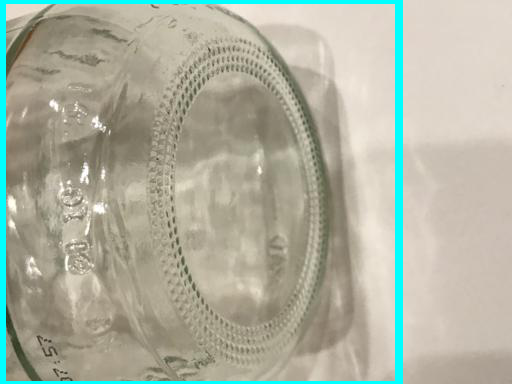

[0.88732237 0.11321531 0.08611386 0.07297657 0.07115103 0.07109112
 0.06840556 0.06529503 0.06528575 0.0646029  0.06282688 0.06209376
 0.06158471 0.05366794 0.0520968  0.0499565  0.04762182 0.04647553
 0.04542632 0.04230868 0.04111016 0.03952788 0.03947641 0.03913045
 0.03893208 0.03892207 0.03783904 0.03744871 0.03699588 0.03611554
 0.03598653 0.03534961 0.03504125 0.03499301 0.03352612 0.03341921
 0.03329328 0.03216141 0.0320628  0.03204673 0.03185922 0.03147832
 0.03095092 0.03050303 0.03048369 0.03044909 0.03023143 0.03006954
 0.02987219 0.02972164 0.02930839 0.02884971 0.0285116  0.02829944
 0.0280475  0.02801292 0.02789271 0.0278446  0.02759047 0.02747659
 0.02745044 0.02721426 0.02714719 0.0271381  0.02690632 0.02666333
 0.02646528 0.02644966 0.02627647 0.02618448 0.02587565 0.02581282
 0.02549266 0.02541767 0.02534884 0.02534261 0.02528513 0.02526116
 0.02524075 0.02509288 0.02503673 0.02475141 0.02460283 0.02454195
 0.02452395 0.0244392  0.0243837  0.02415929 0.02400504 0.0239

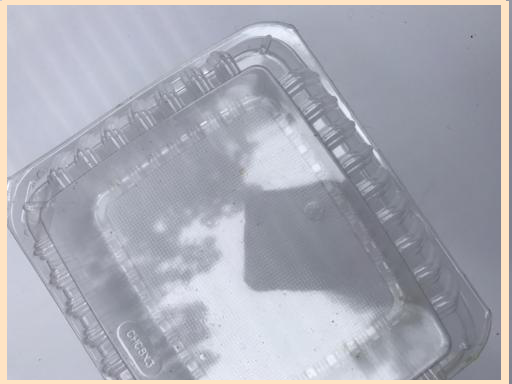

[0.94221467 0.17949246 0.12216228 0.11508474 0.08544916 0.08454954
 0.08291518 0.0696881  0.06349555 0.057094   0.0498709  0.04339367
 0.03794094 0.03749197 0.03719486 0.03544779 0.03500741 0.03372137
 0.03345222 0.03332124 0.03263396 0.03231492 0.03179087 0.03174014
 0.03149083 0.0308259  0.03046427 0.03031035 0.03008363 0.02984194
 0.02950152 0.02841893 0.0281688  0.02806974 0.02806857 0.02800755
 0.02795279 0.02792718 0.02711772 0.02671953 0.0265985  0.02623568
 0.02609914 0.02563885 0.02555116 0.02554968 0.02550319 0.02550275
 0.02543239 0.02504177 0.02500773 0.02494707 0.0248464  0.02471703
 0.02454895 0.0242563  0.02407539 0.02380696 0.02376749 0.02372076
 0.02356601 0.02354038 0.02351146 0.02330347 0.02313822 0.02312248
 0.02303293 0.0230078  0.02296602 0.02287686 0.02264833 0.02245788
 0.02239486 0.0216358  0.02158345 0.02153344 0.02144957 0.02133708
 0.02131505 0.02121106 0.02094974 0.02076424 0.02066162 0.02054647
 0.0204925  0.02023648 0.01994145 0.01991172 0.0196992  0.0196

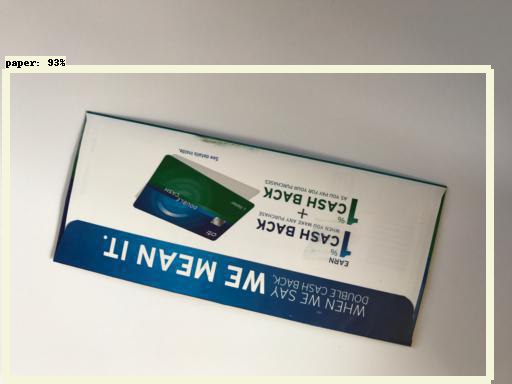

[0.93464845 0.12524168 0.11339673 0.1007877  0.08728448 0.08652391
 0.08257897 0.07884609 0.07710432 0.07681135 0.07593491 0.07535871
 0.07358894 0.07051439 0.0701139  0.06846338 0.06569522 0.06547633
 0.06480634 0.05967911 0.05921222 0.05919264 0.05867552 0.05803375
 0.05695856 0.05694905 0.05689585 0.05549939 0.05468401 0.05432088
 0.05399219 0.05322024 0.05258755 0.05255334 0.05254854 0.05254567
 0.05190207 0.05177059 0.05158982 0.05154703 0.05001176 0.04958173
 0.04792961 0.04754008 0.04728641 0.04669445 0.04663069 0.04638565
 0.04628245 0.0461672  0.04598524 0.0458861  0.04561101 0.04503655
 0.04484449 0.04434553 0.04386513 0.04360152 0.04329528 0.0432909
 0.04243624 0.04240195 0.04220769 0.04208774 0.04185359 0.04157669
 0.04110281 0.04109359 0.04098647 0.04098356 0.04070543 0.04066303
 0.04059586 0.04019235 0.04014878 0.04014206 0.04008241 0.03994009
 0.03979032 0.03958614 0.03949478 0.03914504 0.03894842 0.03886409
 0.03874937 0.03858512 0.03840962 0.03825914 0.03804029 0.03790

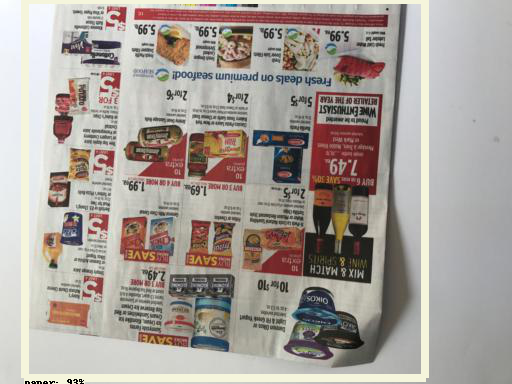

[0.9317134  0.1187189  0.10725196 0.09822661 0.09687643 0.09569105
 0.09074096 0.09050798 0.0860906  0.08587761 0.08180424 0.07758987
 0.07638213 0.07462453 0.07188278 0.07062188 0.07003144 0.06724507
 0.06485471 0.06351208 0.06222174 0.06141502 0.05888423 0.05887386
 0.05886797 0.05687783 0.05258038 0.04804612 0.04713624 0.0456184
 0.04510295 0.04426646 0.04413826 0.04349716 0.04347512 0.04260629
 0.04209627 0.04204072 0.04147239 0.03985326 0.03927309 0.03923855
 0.03852463 0.03811243 0.03808933 0.03794188 0.0364948  0.03647604
 0.03617672 0.03598259 0.0358519  0.03561245 0.03532464 0.03485567
 0.03432103 0.03375962 0.03331944 0.03296293 0.03284333 0.03263112
 0.03200729 0.03198741 0.03194033 0.03160719 0.03150377 0.03148631
 0.03142211 0.03113808 0.03107835 0.03057897 0.03038735 0.03037721
 0.03022328 0.03021281 0.02999253 0.0298901  0.02977704 0.02973525
 0.0295298  0.0293643  0.02933513 0.02929693 0.02921741 0.02918044
 0.02884527 0.02883905 0.02882053 0.02868237 0.02860899 0.02828

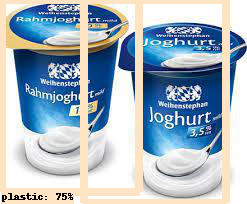

[0.8235588  0.753346   0.15377957 0.10285393 0.0864858  0.08216395
 0.07705136 0.07656189 0.07480878 0.06939344 0.06501307 0.06326297
 0.0619802  0.06048735 0.06039685 0.05761895 0.05704945 0.05524007
 0.05349189 0.05342594 0.05319987 0.05162636 0.05144661 0.04990836
 0.04954357 0.04892413 0.04890367 0.0487434  0.04825929 0.04745055
 0.04717845 0.04679113 0.04636687 0.04570038 0.04543273 0.04540021
 0.04474873 0.04459126 0.04441525 0.04440501 0.04429017 0.04355244
 0.04308864 0.04291425 0.04277258 0.04254605 0.04197578 0.04067016
 0.04047715 0.04040548 0.04007211 0.03993868 0.03951981 0.03949205
 0.03944532 0.03938569 0.03923793 0.03894773 0.03840169 0.03812543
 0.03727411 0.03722968 0.03710778 0.03710508 0.03707869 0.03703978
 0.0364073  0.03614569 0.03582603 0.03555262 0.03548601 0.03503904
 0.03428948 0.03406183 0.03390838 0.03370065 0.03361208 0.03214788
 0.03205227 0.03199787 0.03159324 0.03145777 0.03106922 0.03104854
 0.03083336 0.03063267 0.03053487 0.03044132 0.02994891 0.0299

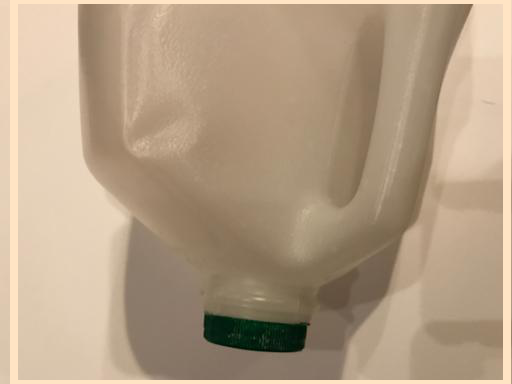

[0.9193257  0.15422677 0.11966756 0.11900331 0.10579373 0.10529085
 0.10500926 0.10376898 0.1004377  0.0991393  0.09369015 0.09127735
 0.07955167 0.07768449 0.06629708 0.06535344 0.06521674 0.06481856
 0.06422453 0.06320511 0.06158698 0.05884252 0.05783277 0.05704541
 0.05638937 0.05517219 0.05461011 0.0522141  0.05172409 0.05171015
 0.05121    0.04953465 0.04914204 0.04913387 0.04904305 0.04857616
 0.04815074 0.04804871 0.04708508 0.04633808 0.04622544 0.04617253
 0.04615908 0.04588085 0.04564338 0.04537262 0.04521703 0.04516312
 0.04513987 0.04507077 0.04419363 0.0441351  0.0435022  0.04268721
 0.0415603  0.04141539 0.04124138 0.04112885 0.04110614 0.04078581
 0.04069681 0.04059506 0.03987497 0.03972372 0.03962776 0.03902667
 0.03889254 0.038233   0.03797979 0.03777356 0.03757653 0.03750413
 0.03731683 0.03711378 0.03689987 0.03686211 0.03665056 0.03642638
 0.03636211 0.0360317  0.03575141 0.03548726 0.03467049 0.03432466
 0.03427529 0.0341836  0.03414964 0.03404148 0.03386428 0.0334

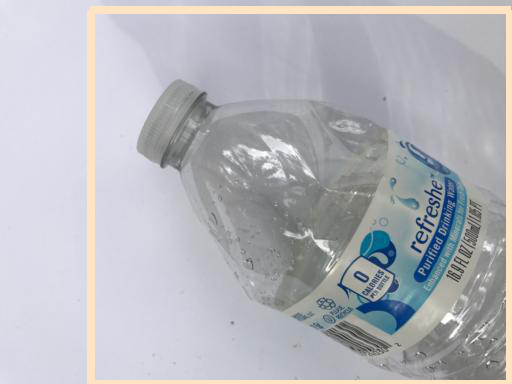

[0.9213322  0.10717926 0.09421591 0.09090568 0.08583918 0.07797579
 0.07441605 0.07308215 0.07250429 0.07118618 0.06669345 0.05921919
 0.05616137 0.05592852 0.05439683 0.05435601 0.05198473 0.04990161
 0.04927088 0.04916002 0.04676576 0.04585781 0.04528648 0.04452582
 0.04258839 0.04197214 0.03976662 0.03938852 0.03919484 0.0391847
 0.03884699 0.03866997 0.03733348 0.03714478 0.03645809 0.03627589
 0.03609626 0.03568666 0.0355613  0.03537007 0.0350516  0.03405277
 0.03404835 0.03310545 0.03291132 0.03289523 0.03288851 0.03247698
 0.03219764 0.03219695 0.03218376 0.03211063 0.03196651 0.03172567
 0.03171436 0.03166119 0.03105005 0.03096664 0.03073577 0.0304405
 0.03025766 0.03012517 0.03005736 0.02978484 0.0297846  0.0296836
 0.02965361 0.02964844 0.02956982 0.02952775 0.02945899 0.02944962
 0.02942774 0.02908737 0.02899974 0.02886908 0.02882818 0.02846986
 0.02820882 0.02801452 0.02791047 0.02777558 0.02773465 0.02762239
 0.02745448 0.02712199 0.02696966 0.02675696 0.0267011  0.0266577

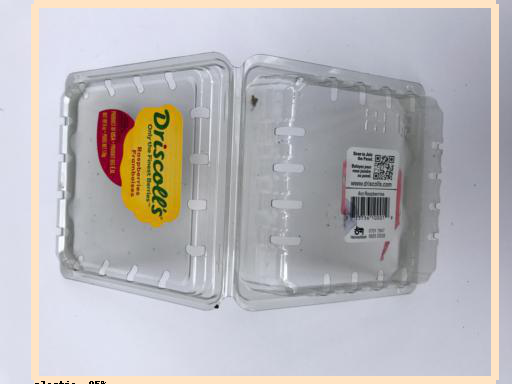

[0.9500431  0.1406963  0.12337138 0.09866662 0.08184893 0.07612832
 0.07336459 0.07146345 0.06931771 0.06712944 0.06316291 0.05574448
 0.05540624 0.05527757 0.05175824 0.05076713 0.04913676 0.04842074
 0.04649291 0.04525355 0.04476106 0.04421678 0.0440012  0.04385741
 0.04374418 0.04309025 0.04250131 0.03984607 0.0396864  0.03869759
 0.0385907  0.03769979 0.03713884 0.03604918 0.03495118 0.03494855
 0.03469325 0.03410857 0.0340239  0.03375842 0.0331366  0.03310746
 0.03301852 0.03277002 0.03252372 0.03250405 0.03247448 0.03231779
 0.03200468 0.03198173 0.03194378 0.03170874 0.03161656 0.03133401
 0.03081399 0.03080243 0.03047368 0.03045746 0.03036872 0.03034884
 0.03022251 0.03018672 0.03011404 0.030074   0.02977031 0.02957401
 0.0295643  0.02935784 0.02927866 0.02916412 0.02896262 0.02884257
 0.02871129 0.02853911 0.0282017  0.0281672  0.02811799 0.02780445
 0.02723921 0.02723414 0.02713091 0.02709068 0.02676649 0.02674954
 0.02671052 0.02667641 0.02652223 0.02641647 0.02639029 0.0262

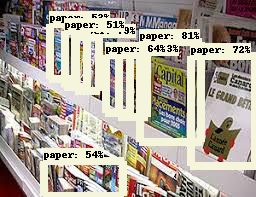

[0.8113953  0.7919586  0.7266499  0.72029144 0.6428965  0.5412159
 0.5291328  0.5079797  0.49126378 0.44509804 0.4436494  0.4425058
 0.4062268  0.3977691  0.39169776 0.3587665  0.338211   0.315841
 0.3099441  0.301385   0.29794243 0.27882877 0.27630726 0.25895983
 0.25022632 0.24120505 0.23824954 0.23732862 0.2311572  0.23075835
 0.22862034 0.22612657 0.21809956 0.21377563 0.211629   0.20709331
 0.20195286 0.20184144 0.1940076  0.17653656 0.1755886  0.17294183
 0.1702825  0.16805461 0.1655947  0.16257672 0.15888028 0.15848395
 0.15442924 0.15249379 0.15002342 0.14758727 0.14654547 0.14369689
 0.14268574 0.14260486 0.14200534 0.1416034  0.14158347 0.14118323
 0.14031215 0.13797969 0.1353701  0.13511686 0.1349328  0.13492376
 0.13451819 0.1339822  0.1323884  0.12779978 0.1273675  0.12453248
 0.12302151 0.12146863 0.12031944 0.11946115 0.11866708 0.11795027
 0.11781269 0.11492097 0.11432948 0.1142983  0.11428983 0.11359236
 0.11222486 0.10996681 0.10646035 0.10532658 0.10310831 0.10216378

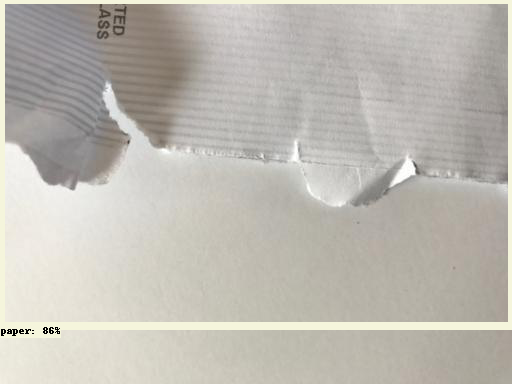

[0.85903454 0.17070058 0.13897794 0.12631984 0.12254613 0.10113329
 0.09613534 0.0902596  0.08431694 0.08268349 0.08079378 0.07973968
 0.07881229 0.07871688 0.07854485 0.0776737  0.0768823  0.07611009
 0.07558133 0.07503434 0.07330335 0.07056493 0.06920947 0.0648049
 0.06424915 0.06407877 0.06382873 0.06300253 0.06200324 0.06144574
 0.06018002 0.05886766 0.05859749 0.05852437 0.05843242 0.05803373
 0.05722844 0.0564176  0.0550945  0.05414778 0.05405419 0.05348752
 0.05305114 0.05255567 0.05171671 0.051215   0.05028669 0.04980483
 0.049597   0.04951431 0.04944377 0.04915631 0.04910108 0.04772797
 0.04734787 0.04574665 0.04558231 0.04557323 0.04523801 0.04468736
 0.04426011 0.04418334 0.04415738 0.04410206 0.04404787 0.04380071
 0.0435752  0.04351958 0.04284694 0.04175731 0.04158692 0.04128139
 0.04118546 0.04115807 0.04066415 0.04064466 0.04061002 0.04053826
 0.0401531  0.04013257 0.03975339 0.03969452 0.03958517 0.03873971
 0.03872043 0.03856052 0.0382669  0.03810083 0.0380027  0.03797

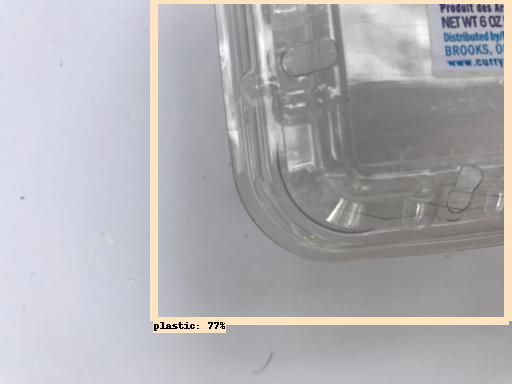

[0.7743849  0.08368167 0.08293249 0.07597513 0.07500631 0.07108784
 0.0699328  0.06697886 0.06678643 0.06661183 0.06366334 0.06305008
 0.06288819 0.06254867 0.06220907 0.06074869 0.05984651 0.05840258
 0.05783549 0.05713771 0.05680868 0.05680676 0.05589906 0.05436194
 0.05341266 0.05340274 0.05309132 0.05219176 0.05111244 0.05069278
 0.04914413 0.04914219 0.04894194 0.04787061 0.0478334  0.0472935
 0.04700742 0.04691858 0.04610286 0.04540509 0.04523935 0.04493559
 0.04448446 0.04420342 0.04390457 0.04362254 0.04150515 0.04144769
 0.04115728 0.0409258  0.04077339 0.04071959 0.04056399 0.04045251
 0.0402723  0.04012692 0.04000407 0.03987663 0.03942905 0.03916297
 0.03892687 0.038759   0.03800474 0.03745632 0.03685109 0.03667348
 0.03631907 0.0360629  0.03587896 0.03574319 0.03542707 0.03484713
 0.03482798 0.03460498 0.03452869 0.03451436 0.03448761 0.03410985
 0.03378189 0.03333344 0.03319208 0.03256295 0.03218699 0.0320971
 0.03202526 0.03194167 0.03189906 0.0318057  0.03178322 0.031723

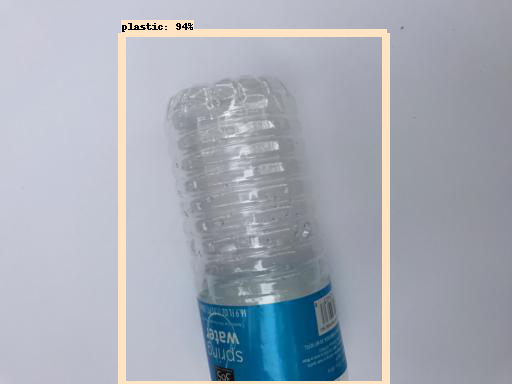

[0.9358439  0.24551037 0.20260584 0.19195308 0.17972763 0.16823189
 0.1598472  0.12127154 0.11579464 0.11180109 0.10511228 0.10499794
 0.09504526 0.085972   0.08509343 0.08491369 0.08260609 0.0814558
 0.08129974 0.08087094 0.07953444 0.07861082 0.07854245 0.07710715
 0.0747547  0.07377525 0.0737701  0.07154055 0.07129734 0.07092779
 0.06755857 0.06672023 0.06563615 0.06474626 0.06364138 0.06330292
 0.05990987 0.05797963 0.05789811 0.0573618  0.05716955 0.05689264
 0.05678039 0.05618054 0.05453189 0.05347492 0.0532265  0.05263709
 0.05229945 0.05042297 0.04986375 0.04979345 0.04916669 0.04798394
 0.04772494 0.04771256 0.04744603 0.04732392 0.04683267 0.04673435
 0.04649831 0.04648118 0.04626193 0.04562157 0.04554559 0.04540519
 0.04502202 0.04500455 0.04494719 0.04485582 0.04473262 0.04467667
 0.043852   0.04384792 0.04334463 0.04294311 0.0428412  0.04265269
 0.04256193 0.04230264 0.04217548 0.04148162 0.04142997 0.04135127
 0.0413412  0.04122874 0.04088364 0.04070839 0.04053279 0.04051

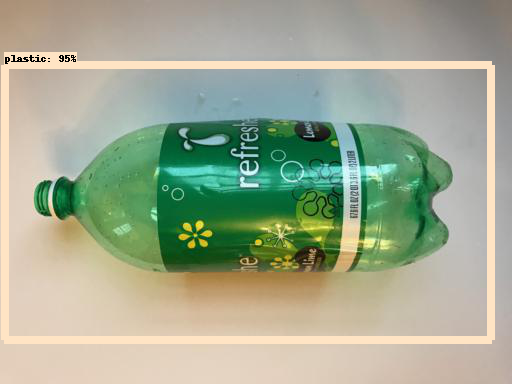

[0.9549452  0.19804703 0.17513435 0.17260884 0.14229819 0.1165108
 0.08987923 0.08338583 0.08132731 0.07109415 0.06624207 0.06584582
 0.06496176 0.06174788 0.06030259 0.05937886 0.05931403 0.05902813
 0.05641121 0.05633382 0.05621777 0.05432552 0.05393611 0.05389876
 0.05226607 0.05226174 0.05153117 0.05135578 0.05084037 0.04954414
 0.04892135 0.04867533 0.04697733 0.0468631  0.0467343  0.04493716
 0.04435163 0.04384986 0.04368029 0.04285829 0.04283079 0.04181013
 0.04166243 0.04115694 0.04113683 0.04093746 0.03990475 0.03907609
 0.03874411 0.03834729 0.03786012 0.0375904  0.03750359 0.0374105
 0.03729658 0.03710984 0.03701241 0.03699164 0.03660248 0.03626705
 0.03611195 0.03594067 0.0358852  0.03559957 0.03553774 0.03531098
 0.03515243 0.03465368 0.03412618 0.03339732 0.03306006 0.03280969
 0.0326609  0.03251575 0.03238708 0.03218017 0.03197959 0.03185574
 0.03127673 0.03114604 0.03111034 0.03110468 0.03105084 0.03078729
 0.03069383 0.03023995 0.03018419 0.03014987 0.03011365 0.030013

In [ ]:
import ntpath
import pandas as pd
from pathlib import Path
import six


testcsv_path = Path(gdrive_path, 'test_result/predict_result.csv')

if testcsv_path.is_file():
    f = open(testcsv_path, "w+")
    with open(testcsv_path, 'a', newline='') as file:
        file.truncate(0)
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

    f.close()    
else:
    with open(testcsv_path, 'w', newline = '') as file:
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

predicted_class = [];
predicted_confidence = [];
imgnamelist = [];
acutal_class = [];

for image_path in glob.glob('/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/image/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  if output_dict['detection_classes'][0] in six.viewkeys(category_index):
    result_class = category_index[output_dict['detection_classes'][0]]['name']
    result_confidence = '{}%'.format(int(100 * output_dict['detection_scores'][0]))
    predicted_class.append(result_class)
    predicted_confidence.append(result_confidence)
  imgname = ntpath.basename(image_path)
  imgnamelist.append(imgname)
  test_record_csv = csv.reader(open('/content/drive/MyDrive/GarbageClassification/dataset_withO/mosaic/csv/test_tfcsv.csv', "r", encoding='utf-8'), delimiter=",")
  for row in test_record_csv:
    #if current rows 2nd value is equal to input, print that row
    if str(imgname) == str(row[0]):
      print(row[0])
      print(imgname == row[0])
      actualimgclass = row[3]
      acutal_class.append(actualimgclass)
  if actualimgclass == result_class:
    correct = 1
  else:
    correct = 0
  with open(testcsv_path, 'a', newline = '') as file:
    writer = csv.writer(file)
    writer.writerow([imgname, actualimgclass, result_class, result_confidence,correct])
    file.close()

  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))
  print(output_dict['detection_scores'])


In [ ]:
print(output_dict['detection_scores'])

[0.7853466  0.34338203 0.31912273 0.29789293 0.1987635  0.12014142
 0.10635038 0.09297409 0.08944117 0.07591347 0.06747946 0.06579514
 0.06283499 0.05851369 0.0572906  0.05549347 0.05457848 0.04731362
 0.04557684 0.04407731 0.04390258 0.04278567 0.04271456 0.04245731
 0.04236815 0.0407364  0.04012333 0.04007063 0.03999527 0.03944959
 0.03922865 0.038495   0.0383814  0.03758775 0.03728344 0.03700802
 0.03679036 0.03661132 0.03637133 0.03546767 0.03525874 0.03410267
 0.03361417 0.03332796 0.03290266 0.03261347 0.03191865 0.0317899
 0.03121148 0.03081889 0.03031431 0.03025176 0.03009254 0.02997788
 0.02990504 0.02986025 0.02973791 0.02922899 0.02892546 0.02891792
 0.02887801 0.02881332 0.02846079 0.02842423 0.02819868 0.02806844
 0.02803409 0.0278242  0.02770327 0.02758127 0.02725392 0.02698923
 0.02688047 0.02673219 0.02646456 0.02632945 0.02618821 0.02543491
 0.02531937 0.02518494 0.02514312 0.02513971 0.02513582 0.02494446
 0.02475813 0.02472482 0.02465246 0.02441465 0.02439446 0.02349

In [ ]:
print(imgname)
print(type(imgname))
print(ntpath.basename(image_path))
print(acutal_class)
pathtest = '/content/drive/MyDrive/GarbageClassification/dataset2/data/test_image/brown-glass211.jpg'
print(ntpath.basename(pathtest))

white-glass206.jpg
<class 'str'>
white-glass206.jpg
['glass']
brown-glass211.jpg


In [ ]:
# !python /content/models/research/object_detection/model_main_tf2.py \
#     --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/pipeline.config \
#     --model_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50 \
#     --checkpoint_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50

In [ ]:
# !python /content/models/research/object_detection/model_main_tf2.py \
#     --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/pipeline.config \
#     --model_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50 \

In [ ]:
# #install tensorflow 1.15
# !pip install tensorflow==1.15
# #Check tensorflow version
# import tensorflow as tf
# print(tf.__version__)

In [ ]:
# !git clone --q https://github.com/tensorflow/models.git

In [ ]:
# #navigate to /models/research folder to compile protos
# %cd models/research
# # Compile protos.
# !protoc object_detection/protos/*.proto --python_out=.
# # Install TensorFlow Object Detection API.
# !cp object_detection/packages/tf1/setup.py .
# !python -m pip install .

In [ ]:
# !python object_detection/builders/model_builder_tf1_test.py